In [1]:
import re
import numpy as np
import matplotlib.pyplot as plt
import random
import itertools
import pickle
from settings import *

In [2]:
#resumen del proceso
#1 cargar todas diccionario con line index y sentence
#2 elminiar las mas largas de 50
#3 añadir las palabras al vocabulario
#4 eliminar las sentence con palabras que no salen
#5 pasar los pares con line index contiguos

In [3]:
# n_lines = 0
# with open(corpus, 'rb') as file:
#     for line in file:
#         n_lines += 1
# print(f'Numero de líneas: {n_lines}')

n_lines = 213_517_354
f"Lineas usadas sobre el total:{LINES_USED/n_lines:.3%}"

'Lineas usadas sobre el total:0.468%'

In [6]:
def printLines(stop=10, start=0, decode=False):
    with open(corpus, 'rb') as datafile:
        for i,line in enumerate(datafile):
            if i < start: continue
            if decode:
                print(i,line.decode("utf-8"))
            else:
                print(i,line)
            if i==start+stop: break

printLines(500_000,1000,True)

1000 ¡Uno, dos, tres!

1001 ¿Es mi turno?

1002 ¡Feliz cumpleaños!

1003 ¡Sopla tus velas!

1004 ¡Para ti, Dong Woo!

1005 - Gracias.

1006 - Para ti.

1007 Bien, hagámoslo.

1008 ¡Vamos!

1009 [Para tu deleite visual.]

1010 Ajj... esa loca.

1011 - ¿Debería hacerme un lunar?

1012 - ¿Por qué?

1013 Porque son bonitos.

1014 Mira a Han Ga In y Go So Young.

1015 Entonces te parecerías a todas las demás actrices.

1016 Deberías hacerte uno en medio de la frente.

1017 Uno bien grande.

1018 ¿De qué diablos habla?

1019 "Voy a casarme con ella, ¡así que firme los papeles de divorcio!"

1020 "¡Pero es mi hermana!"

1021 - "Se lo haré pagar." - "¿Cómo?

1022 ¿Seduciendo a mi padre?"

1023 "¿Por qué no?

1024 Voy a destruirlo."

1025 "¡Voy a destruirlo!"

1026 ¿Así es como vas a decirlo?

1027 ¿Estás pidiéndome permiso para poder destruirme?

1028 Debes ser más despiadada.

1029 Suenas muy débil.

1030 Dilo como cuando te pones como loca conmigo.

1031 ¿Ah, sí?

1032 Creí que estaba siendo

2547 Echaste un edificio abajo y liberaste a un prisionero, el sargento Cutter, ¿no?

2548 - Sí, sahib.

2549 - Eso es todo, llévenselo.

2550 ¡Esta vez acabas en el paredón!

2551 Espera, Mac. ¿Dónde está Cutter?

2552 Din, ¿dónde está el sargento Cutter?

2553 - Le han cogido.

2554 - ¿Quién?

2555 Ellos le han cogido en el templo dorado.

2556 ¿Pero quién?

2557 ¿Son sacerdotes o qué?

2558 Hombres muy malos.

2559 Le torturarán.

2560 - Los sahibs deben darse prisa.

2561 - ¿Cuántos eran?

2562 - No sé, corrí a buscar ayuda.

2563 - Seguro que corriste mucho.

2564 Vas a volver igual de rápido.

2565 - Me enseñarás el camino.

2566 - Cogeré una docena de hombres.

2567 No vas a coger nada, voy a ir solo.

2568 - Estás loco, no lo conseguirás.

2569 - No voy a matar a Cutter yendo con tropas.

2570 Le harían pedazos si se enteraran.

2571 - Tienes razón, iremos juntos.

2572 - No, no irás.

2573 - Tommy, cariño. ¿Qué ocurre?

2574 - Nada.

2575 Cutter se ha metido en un lío y vamos 

4205 - Sí, definitivamente.

4206 Tengo la sensación de que es-- por algúun motivo-- tal vez es menos divertido ser sincero.

4207 Pero es menos divertido, ¿no?

4208 De alguna manera, sí.

4209 Tal vez es más divertido lo satírico que lo serio.

4210 Sí.

4211 Son como las 9:00 de la mañana, y hoy es el gran día en que Kinnithrung Sprat va a hablar de CPA Australia y a clausurar la OMC.

4212 Día emocionante para nosotros, al final tenemos que cerrar.

4213 Estoy escribiendo un núumero local para este celular en las tarjetas.

4214 Así que si se las damos a los periodistas o a alguien más.

4215 que quiera hablar con el Sr. Sprat, podrá hacerlo en dos días.

4216 Tenemos que irnos en diez minutos.

4217 Lo sé.

4218 Voy a hacer lo menos posible.

4219 Bien, vayamos por ahí.

4220 Todavía tenemos tiempo.

4221 Sigamos caminando.

4222 Caminemos derecho.

4223 No mires.

4224 No dobles a la izquierda.

4225 No...

4226 Ey, no.

4227 No.

4228 No hagas eso.

4229 Contesta.

4230 Hola, ha

5829 Eres hombre muerto, viejo.

5830 Hombre muerto.

5831 Mira todas esas manchas de sangre.

5832 Cállate.

5833 - Voy a enfrentarme a ese tipo.

5834 - ¿Qué tipo?

5835 El idiota de la entrada.

5836 Clint.

5837 El hombre superdominante con uniforme de macho de 1950.

5838 - No me parece una buena idea.

5839 - Lo tengo todo planeado.

5840 La mayoría de las peleas en un lugar como éste... jamás pasan de uno o dos puñetazos.

5841 Hay un instinto casi natural por no perturbar a la manada.

5842 Sólo tengo que meterle un buen puñetazo, defenderme y esperar.

5843 - ¿Cómo?

5844 - ¿De qué estás hablando?

5845 Al principio me sentí aliviado de salir de la situación... pero ahora siento este nivel de humillación en mí...

5846 ¡y sé que lo tendré el resto de mi vida!

5847 Y no permitiré que ésta sea otra situación que contribuya... a que yo sea un insignificante ser el resto de mi vida.

5848 Mira esta jodida ciudad, viejo.

5849 Está muerta.

5850 Imagina cuánta gente ahí está jodie

7751 Hay algunas líneas de alta tensión abajo, cerca de Richmond.

7752 Richmond, Virginia?

7753 Sí.

7754 Hay algunas aves que vuelan en Fresno.

7755 Fresno, Fresno ...

7756 Oh, estoy tan cansado.

7757 ¿Dónde está Fresno?

7758 California?

7759 Fresno, California.

7760 Hola.

7761 Hola Marge.

7762 Hola.

7763 Ned.

7764 Oye, ¿qué estás haciendo?

7765 Bueno, es una especie de acuerdo privado.

7766 Lo llamamos operación Marge porque lo soñado.

7767 Ah, sí?

7768 Estamos trazando cada inusual ocurrencia en el país.

7769 Algunos pueden haber sido causados por el Mantis.

7770 Esto podría darnos una pista.

7771 Un poco de suerte?

7772 Bueno son demasiado esparcidos en el sentido de nada.

7773 niños Sabes qué hora es.

7774 Es después de la medianoche.

7775 Ahora estás despedido, los dos ....

7776 Pero el general tengo el ...

7777 No hay "peros" al respecto.

7778 Ya has oído lo que dijo el general.

7779 Su casa recto joven.

7780 Y yo soy el que toma usted.

7781 Noche de

9490 - Son dos centavos para avena.

9491 - ¿No lo he visto antes?

9492 - Depende de dónde haya estado.

9493 - Sigo al ferrocarril.

9494 - Pues tal vez me haya visto.

9495 - Cuatro centavos la noche.

9496 - Bien.

9497 Buenas. ¿Ha venido un hombre alto y corpulento?

9498 - ¿Ése, señor Renner?

9499 - No, ése no.

9500 Uno con una cicatriz.

9501 ¿En la mejilla?

9502 No, señor.

9503 No he visto a nadie con una cicatriz.

9504 Me vendrían bien un pedazo de tarta de manzana y un café.

9505 Te vendrían bien unos huevos con panceta, si te apetecieran.

9506 - Hola, Charlie.

9507 - Hola, Grant.

9508 Me alegro de verte, Charlie.

9509 Me alegro muchísimo.

9510 Yo también me alegro.

9511 - Voy a por los huevos.

9512 - No, la tarta.

9513 Sólo puedo pagar eso.

9514 Qué cabezota.

9515 No se desayuna con tarta de manzana.

9516 Si te gusta la tarta, sí.

9517 Necesito un tenedor.

9518 - ¿Hace mucho que trabajas aquí?

9519 - Unas tres semanas.

9520 ¿Cómo está el Niño de Utica?



11237 No podrías dispararle a un hombre por la espalda.

11238 Ya aprenderé.

11239 ¿ Qué os pongo?

11240 Tenemos al Abuelete, la Abuelita y el Viejo Tío Tom.

11241 - Y el Viejo Vacío.

11242 - No tiene gracia, Latigo.

11243 ¿ Quién va a tener gracia estando aquí metido?

11244 Lárgate, crío.

11245 No tienes edad para un whiskey, aunque me sobrara.

11246 No te pases de listo.

11247 No soy Joey.

11248 Hablando de Joey, ¿no lo habrás visto por el camino?

11249 Un trago de ese Viejo Farfullador.

11250 - ¿Lo has visto?

11251 - No.

11252 ¿Ha dejado algún rastro?

11253 Alguno.

11254 Va camino de Junction City.

11255 ¿Pero no lo seguiste?

11256 Joey siempre fue un estorbo.

11257 Yo quería tirarlo al río.

11258 - ¿Por qué no lo hiciste?

11259 - ¿Para que me volaran los sesos?

11260 Debe de haber una razón mejor para morir.

11261 Supongamos que Concho no encontró a Joey y que el niño se va de la lengua.

11262 - No lo hará.

11263 - Tal vez no, pero Concho no ha vuelto.

112


12958 ¿Dios creó Mau Mau?

12959 Mau Mau es su voluntad.

12960 ¿Dios te dijo que mutilaras a niños inocentes?

12961 ¿Gikuyu y Mumbi ultrajaban animales?

12962 Desde que creó Kenia ¿os ha dicho Dios que robéis, matéis y odiéis?

12963 ¿Es voluntad de Dios que comáis carne humana?

12964 - Juro que...

12965 - Espera.

12966 Que tu juramento tenga valor ante los ojos de Dios.

12967 Jura por tu piedra sagrada Githathi.

12968 Coge este símbolo de Dios y jura.

12969 Entonces te creeré.

12970 Empieza por el principio.

12971 ¿Prestaste el juramento Mau Mau?

12972 - No.

12973 - Te creo.

12974 - ¿Se lo tomaste a otros?

12975 - Sí.

12976 ¿A la fuerza?

12977 Jurasteis echar a los blancos de África, ¿no?

12978 - Sí.

12979 - ¿Dios os dijo que crearais Mau Mau?

12980 Di que sí ante Dios y te creeré.

12981 Ya he dicho bastante.

12982 Temes enfrentarte a tu dios.

12983 - Si nos echan, ¿qué?

12984 - Habrá libertad.

12985 - ¿Y fe en Dios?

12986 - Sí, sí.

12987 ¿Qué fe?

12988 ¿M

14467 ¿Qué condiciones?

14468 La vida de su gente.

14469 - ¿Qué podemos perder?

14470 - ¿Prestó juramento?

14471 Dicen que sí.

14472 Tiene una posibilidad entre mil de salir con vida.

14473 La operación le cuesta al Gobierno un millón de libras al mes.

14474 Varios granjeros de Nyeri han vuelto a Inglaterra.

14475 Las bandas de Mau Mau están acorraladas en los Aberdares.

14476 ¡La bengala!

14477 ¡Lanza la bengala!

14478 ¡Elizabeth!

14479 Jeff.

14480 ¿Dónde está Jeff?

14481 Mañana podrás llevarte a Elizabeth a Nairobi.

14482 Al hospital.

14483 ¿Y dejarla allí?

14484 Es para ayudarla.

14485 Te buscaremos un piso y podrás verme todos los días.

14486 Sí.

14487 Sí, me gustaría.

14488 ¿Estás bien?

14489 No ha venido nadie.

14490 ¿Has tomado contacto?

14491 ¿Y bien?

14492 ¿Viste a Kimani?

14493 ¿Va a venir?

14494 Ahora es un gran general.

14495 No sé si vendrá.

14496 Y si viene, no sé si vendrá para hablar o para matar.

14497 No sé cómo piensa un general.

14498 

16195 - Nos envían de la fábrica, a verlo.

16196 - Para que le demos estos regalos.

16197 - ¡Oh, perdone!

16198 Es este.

16199 - Sí...

16200 Gracias.

16201 Y pidieron que le dijéramos, en nombre del comité fabril del partido...

16202 Manténgase firme, compañero, hasta la última gota de sangre.

16203 Pegadles a los malditos fascistas, que nosotros, en la fábrica, cumpliremos las metas y las sobrecumpliremos.

16204 Eso lo sabemos muy bien.

16205 Mejor es que se sienten y beban con nosotros, por salud de mi hijo, Borís.

16206 Pues bien...

16207 La vida en el globo terráqueo no está tan bien ordenada, como quisiéramos.

16208 Por ejemplo, tú vas a la guerra, Borís...

16209 - Mejor tomamos.

16210 - Por tí.

16211 A abuela también, Irina...

16212 Pues, nosotros despedimos ayer a mi hermano y mamá lloró a mares...

16213 - ¿Y usted lloró?

16214 - Yo, también.

16215 - ¿A lo comité fabril o a lo casero?

16216 - A lo casero.

16217 Nosotros no tenemos a quien despedir:

16218 s

18010 Nuestro reencuentro ha provocado una felicidad inconmensurable.

18011 Cada soviético está jubiloso.

18012 ¡Nuestros corazones cantan de alegría!

18013 Esta alegría nos la trajo la victoria.

18014 Todos esperábamos estos alegres minutos

18015 De tanta dicha hemos perdido la cabeza.

18016 Pero, no olvidaremos a los caídos en los campos de las grandes batallas.

18017 Pasará el tiempo, la gente reparará las ciudades y las aldeas.

18018 Cicatrizarán nuestras heridas,

18019 ¡pero nunca cesará el odio feroz a la guerra!

18020 Sentimos profundamente el dolor de quienes no pueden hoy recibir a sus familiares más cercanos.

18021 Por eso, haremos todo lo posible, para que las futuras novias nunca pierdan a sus prometidos.

18022 para que las madres no teman por la vida de sus hijos,

18023 Para que los padres audaces, no lloren a escondidas.

18024 ¡No hemos vencido ni conservamos la vida en nombre de la destrucción, sino de la creación de la nueva vida

18025 ¿Por qué no te muev

19739 Evacuados, dejen pasar.

19740 Esa hornilla de queroseno despide hollín.

19741 ¡Oh!

19742 Perdone...

19743 Después de la guerra soñarás despierta.

19744 ¿A dónde va usted?

19745 Al hospital, estoy de guardia.

19746 Anda como una sombra.

19747 Está nerviosa.

19748 Ella espera una carta.

19749 ¿De quién?

19750 Tiene al esposo al lado, no es el caso de nuestros soldados.

19751 Ella no espera carta de nadie.

19752 - ¿Va usted por la tarde a la escuela?

19753 - Sí.

19754 Por los cielos vuelan, como naves, las grullitas felices...

19755 Se me han pegado esos versos estúpidos.

19756 Ahí viene.

19757 - ¿Quién?

19758 - El cartero.

19759 Si logro contar hasta 50, tendré una carta.

19760 - Uno, dos, tres, cuatro...

19761 - No lo hagas, Verónica.

19762 - Quince, dieciséis...

19763 - Verónica, eso es una locura.

19764 - Diecinueve, veinte...

19765 - ¡Basta!

19766 Cuarenta y siete, cuarenta y ocho...

19767 - Buenas.

19768 - Buenas.

19769 Para usted no hay nada.

19

21561 Si todavía está en casa de Verónica, No lo entiendo.

21562 - ¡Boricito!

21563 - ¿Llamó papá?

21564 Peleó mucho.

21565 ¿Por qué no dijiste nada?

21566 Para evitar estas exclamaciones.

21567 Irás mañana a la fábrica y entregarás esto.

21568 - Se lo das a Kuzmin, el ingeniero.

21569 - Lo haré.

21570 ¿Qué estás metiendo...?

21571 Tengo que ir a comprar vino.

21572 Abuela, quiero pedirle un favor.

21573 Ahora, espere un minuto...

21574 - ¿Los enviarán enseguida al frente?

21575 - Creo que sí.

21576 Abuela, mire...

21577 Ahora.

21578 Mañana por la mañana, lo más temprano posible, llévesela a ella...

21579 - ¿Qué es eso?

21580 - Un regalo por su cumpleaños.

21581 Y después, si ella tiene problemas, pues se trata de una guerra, ayúdela.

21582 ¿Y si me muero?

21583 Usted no puede morirse, en especial ahora, cuando usted conoce tantos secretos.

21584 - Pues, y si a fianl me muero...

21585 - No, no...

21586 Silencio, abuela. ¡Verónica!

21587 No, es Irina.

21588 ¡G

23314 - Tengo que hervir agua.

23315 Tiene gangrena en el brazo.

23316 Dame mis diez mil.

23317 Nueve mil quinientos.

23318 No olvides que compraste una vaca.

23319 ¿Crees que ella quemaría diez mil por ti?

23320 No puedo creer que seas un tonto nato.

23321 Te habrás entrenado para serlo.

23322 Toma, para que lo vigiles.

23323 La leña ya está más seca.

23324 El siguiente fajo la encenderá.

23325 Bien, Denning, dame más billetes.

23326 No.

23327 No tendré mejor excusa para matarte.

23328 Tendrás que matarme.

23329 No te muevas.

23330 Meg, el rifle.

23331 Me da miedo fallar el tiro.

23332 Meg, no lo fallarás.

23333 Podría herirte.

23334 No me vas a herir.

23335 Sólo... amartíllalo... y apunta como te enseñé.

23336 - Buen intento.

23337 - Gracias.

23338 Y gracias a ti.

23339 Ven, mi amor.

23340 Ven.

23341 Lo estás haciendo muy bien.

23342 Mira.

23343 Recuéstate.

23344 Pronto encenderá el fuego.

23345 Anda.

23346 Lo que sí puedo decir es que tenemos dinero p

25092 Me pregunto cómo lo haces.

25093 Son los negocios.

25094 Tu hermano tiene negocios.

25095 Sabes dónde conduce eso.

25096 Ni siquiera puede vivir aquí.

25097 No me hables de eso.

25098 Trece meses de chirona y cinco años de exilio.

25099 Tengo amigos bien situados que van a tratar de levantar su prohibición

25100 - ¿Crees que podrán hacerlo?

25101 - Eso espero.

25102 Es una cuestión de dinero.

25103 Si lo consiguen lo meto en mi garaje.

25104 Para que deje de hacer tonterías

25105 Precisamente me ha escrito Quiere que vaya a verle.

25106 ¿Me llevarás contigo?

25107 ¿Esperas a alguien?

25108 ¿Quién está ahí?

25109 Pierre Bertain me ha dado un recado para su madre.

25110 Entre.

25111 ¿De qué se trata?

25112 Un tonto del culo, mamá ¿Un qué?

25113 Pierrot nos manda un tonto del culo.

25114 Extraña forma de presentarme.

25115 - ¿Llegas de Lagny?

25116 - ¿Por qué de Lagny?

25117 - ¿Dónde has visto a mi hermano?

25118 - En la comisaría.

25119 - ¿Se ha dejado at

26736 El tiempo es oro y el hombre no tiene la patente del mal.

26737 Respecto a esa bomba, esa bella perversidad, es la obra de mi vida, y he vivido muchos años.

26738 ¿Por qué no dejáis, por favor, que haga explosión y ponga el final adecuado a la Tierra?

26739 El hombre se lo merece.

26740 Me gustaría dejar este asunto de la Tierra.

26741 Tengo que visitar todo el Universo.

26742 ¿Qué suena?

26743 Es mi teléfono privado.

26744 Perdón.

26745 ¿Sí?

26746 Al habla.

26747 ¿Problemas en Marte?

26748 ¡Qué bien!

26749 Aquí tardaré un poco.

26750 Nada grave.

26751 Se discute sobre mi adquisición de 2 ó 3 billones de nuevas almas.

26752 ¡Orden en la sala!

26753 Te llamaré más tarde.

26754 Sr. Scracht, las llamadas durante el juicio son una grosería impropia y sin precedentes.

26755 Gracias. noble señor.

26756 Prosiga, ujier.

26757 "Y así, el Alto Tribunal se reúne para deliberar en el Espacio Exterior".

26758 No se podía reunir en el Cielo.

26759 ¡Protesto!

26760 ¡Orde

28502 Sólo pretendo ilustrar mi ponencia.

28503 Prosiga.

28504 Si la memoria no me falla... hasta la propia Humanidad dudaba.... de la beatitud en el Periodo Isabelino.

28505 de la aventura del Nuevo Mundo.

28506 Sir Walter Raleigh, poeta, explorador y marino... cuya valentía ayudó a conquistar el Nuevo Mundo... fue decapitado por sus nobles esfuerzos.

28507 ¡ Vaya forma de demostrar gratitud !

28508 ¿Se ríe del triste destino de Sir Walter?

28509 Me pareció gracioso.

28510 Como lo que le ocurrió... en la corte de la Reina Isabel.

28511 Su forma de fumar en pipa escandalizó a la realeza.

28512 ¡ Sir Walter Raleigh !

28513 ¡ Sir Walter, está ardiendo !

28514 Vaya recompensa por ayudar a colonizar el Nuevo Mundo.

28515 La cabeza de Sir Walter soportó un gran castigo.

28516 La regaron con cerveza y luego se la cortaron.

28517 ¿Qué mundo es este en el que se recompensa... un descubrimiento con un baño de cerveza y una decapitación?

28518 Permite que un hombre esclavice a su

30442 Pero si no trabajan duro...

30443 ¡serán castigados!

30444 Una palabra acerca de escaparse.

30445 No hay alambre de púa... ni valla... ni torre de vigilancia.

30446 No son necesarios.

30447 Somos una isla en la selva.

30448 La huida es imposible.

30449 Morirían.

30450 Hoy descansan.

30451 Mañana comenzarán.

30452 Permítanme que les recuerde el lema del general Yamashita:

30453 Sean felices en su trabajo.

30454 ¡Pueden retirarse!

30455 ¡Batallón, en descanso!

30456 Rompan filas, mayor Hughes.

30457 Lleve a los hombres a sus cuarteles.

30458 Que Clipton se ocupe de los enfermos.

30459 - Iré a conversar con este sujeto.

30460 - Muy bien.

30461 Acabo de oír sus comentarios, señor.

30462 Mis hombres procederán de la manera que se espera de un soldado británico.

30463 Naturalmente, mis oficiales y yo seremos responsables de su conducta.

30464 Tal vez se le pasó por alto que el uso de oficiales para trabajos manuales... está expresamente prohibido por la Convención

32282 Es una locura intentar escapar.

32283 Tres muertos, ¿y para qué?

32284 ¡Es la hora!

32285 ¡Aquí es donde debemos ganar!

32286 Nos ha mirado y ha movido la cabeza.

32287 ¡Vete a saber!

32288 Eso significa una cosa:

32289 El coronel no cede.

32290 ¿Y bien?

32291 Esto es lo que dice:

32292 No piensa ceder por la fuerza.

32293 Es cuestión de principios.

32294 Como médico, protesto por el trato.

32295 Es milagroso que siga vivo.

32296 Si le ocurre algo, sería prácticamente asesinato.

32297 Él es el responsable.

32298 No yo.

32299 ¿Está enfermo?

32300 ¿Están los dos locos?

32301 ¿O lo estoy yo?

32302 ¿O es el sol?

32303 ¡Atención!

32304 ¡Batallón, firmes!

32305 ¡Prisioneros ingleses!

32306 Quiero preguntarles ¿por qué el puente no progresa?

32307 Ustedes saben por qué.

32308 Sus oficiales son unos perezosos.

32309 Creen que trabajar como todos es indigno de ellos.

32310 Esto no es justo.

32311 Y por eso no trabajan a gusto.

32312 Y por eso no adelanta el p

34158 Sabotaje, demolición, cosas así.

34159 Usamos explosivo plástico.

34160 Es genial.

34161 La de antes fue con la mitad de esto.

34162 Doble poder que la gelignita y mitad de peso.

34163 Sin detonador es inofensivo.

34164 Gracias por decirlo.

34165 Soporta el agua y es realmente plástico.

34166 Puede hacer lo que quiera.

34167 Ésta es mi casa.

34168 Adelante.

34169 Me muero por una taza de té.

34170 - ¿Le apetece?

34171 - No, gracias.

34172 - ¿Una copa?

34173 - No, gracias.

34174 - Peter, un té, por favor.

34175 - Sí, señor.

34176 ¿Sabe leer esto?

34177 Yo enseñaba lenguas orientales en Cambridge.

34178 Aún no le he felicitado por su fuga.

34179 Muy bien.

34180 Sin el avión de rescate, no estaría aquí.

34181 No, supongo que no.

34182 ¿Quiere ver dónde estaba?

34183 De acuerdo.

34184 Tenemos pocos datos.

34185 Se basa en su informe.

34186 Situamos el campo aquí.

34187 ¿Uds. Saben qué le pasó al Coronel Nicholson?

34188 ¿Uds. Saben qué le pasó al Coronel

35904 Todos dicen que lo mejor para Shears sería lanzarse y confiar en la suerte.

35905 ¿Con o sin paracaídas?

35906 ¡Ésa es buena!

35907 ¡Con o sin!

35908 ¡En los árboles!

35909 Yai dice que por aquí no llegaremos.

35910 Hay patrullas japonesas.

35911 Debemos atravesar la selva.

35912 - ¿Quién nos guiará?

35913 - Yai.

35914 Los odia.

35915 Cogieron a sus hombres.

35916 Y por eso utilizaremos portadoras.

35917 - ¿Mujeres?

35918 - Están capacitadas.

35919 Es peligroso pasar la noche aquí.

35920 Hay japoneses a 5 km. Dormiremos en la selva.

35921 - ¿Y Chapman?

35922 - Yai le enterrará con el paracaídas.

35923 ¿Algo va mal?

35924 Estaba pensando.

35925 Usted habla el idioma de Yai, yo no.

35926 Él sabe cómo llegar hasta el río, yo no.

35927 ¿Quieren decirme por qué soy indispensable?

35928 Le comprendo, pero los imponderables existen.

35929 Dígaselo a Chapman.

35930 ¡En marcha!

35931 Eres adorable.

35932 Adorable.

35933 Hay que trabajar con alegría.

35934 Sí,

37602 - Gracias, señor.

37603 Shears, escoja un lugar en nuestro lado de la ribera donde pueda cubrir a Joyce.

37604 Yai estará con Ud., así Uds. dos podrán ocupar a los nipones... si le causan problemas a Joyce.

37605 En la teoría, siempre hay una cosa más por hacer... yo fijaré el mortero aquí para crear una distracción adicional si es necesario.

37606 Tal vez hasta dispare unos tiros al azar al tren.

37607 ¿Todo entendido?

37608 ¿Alguna pregunta?

37609 Bien.

37610 Empezaremos en cuanto esté oscuro.

37611 Seguramente tendrán centinelas en el puente... así que tendrá que llevar las cosas... desde río arriba... lo que significa construir una balsa.

37612 Yai llevará tres mujeres para ayudarle a construir la balsa.

37613 Una se quedará aquí conmigo.

37614 En marcha.

37615 Si no fuera por mi tobillo, yo haría la misión de Joyce.

37616 Lo sé.

37617 ¿Cree que va a estar bien?

37618 Creo que sí.

37619 ¿Quiere que yo me ocupe?

37620 Lo dejaría quedar a Ud. aquí con el morte

39315 Hay una reunión de oficiales a las 7:00.

39316 Deme una lista de sus requerimientos.

39317 Sí, señor.

39318 - Cualquier cosa que podamos hacer.

39319 - Gracias, señor.

39320 - ¿Qué pasa?

39321 - No importa.

39322 Vamos, dígalo.

39323 Puedo pensar en muchas cosas para decir de Saito, ¿pero "razonable"?

39324 Esa es una nueva.

39325 Quizás el coronel Nicholson define la palabra de un modo diferente.

39326 ¿Algún otro punto?

39327 - Con su permiso, señor.

39328 - ¿Sí, Jennings?

39329 Acerca del comité de huida, señor.

39330 Hablé con el comandante Shears...

39331 No habrá ningún comité de huida.

39332 No entiendo, señor.

39333 El tenienteJennings tiene un plan.

39334 Sí, estoy seguro queJennings tiene un plan, ¿pero escapar?

39335 ¿Adónde?

39336 ¿Hacia la selva?

39337 Saito tenía razón.

39338 No hay necesidad de alambre de púa aquí.

39339 Una posibilidad en cien de sobrevivir.

39340 Estoy seguro que el comandante Shears, con su experiencia, me respaldará.

3

41368 Por cierto, quería decirle que hay árboles parecidos a los olmos.

41369 Y que los olmos del puente de Londres tienen 600 años.

41370 - ¿600 años, Reeves?

41371 - Sí, señor.

41372 600 años.

41373 Eso es extraordinario.

41374 HOSPITAL MOUNT-LAVINIA CEILÁN

41375 Busco a un americano, el Comandante Shears.

41376 - Sí, abajo en la playa.

41377 - Muchas gracias.

41378 ¡Un beso!

41379 Hay demasiada gente.

41380 Me das pastillas, baños, inyecciones, enemas...

41381 Y yo necesito amor.

41382 Cierto, lo que necesitas es amor.

41383 ¿Por qué crees que te van a licenciar?

41384 Porque soy un civil de corazón.

41385 Siempre sigo a mi corazón.

41386 Un beso.

41387 ¿Qué tal, comandante?

41388 No me llames comandante.

41389 No es romántico.

41390 Tú también eres oficial.

41391 ¿Qué tal si te llamo "adorada teniente"?

41392 Seamos demócratas, llámame señor.

41393 Sí, señor.

41394 Enemigo a la vista.

41395 Te busca.

41396 Todo tuyo.

41397 - Voy a bañarme.

41398 - ¡No 

42956 Nuestra información es escasa.

42957 Se basa mayormente en su informe.

42958 Pero creemos que el campo está por aquí.

42959 ¿Su servicio secreto tiene idea de qué le ocurrió al coronel Nicholson?

42960 Tenía las agallas de un demente.

42961 Estaban por fusilarlo, pero ni siquiera pestañeó.

42962 Supongo que si están por fusilarlo, no hay mucho que uno pueda hacer.

42963 Aquí está el río Kwai... y aquí está la aldea siamesa donde lo ayudaron... y aquí está el ferrocarril.

42964 Ud. Debe conocer bastante bien toda esta área.

42965 En realidad no.

42966 Estaba delirante la mitad del tiempo.

42967 Muy bien, el ferrocarril empieza aquí, en Singapur.

42968 Malaya, Bangkok, Rangoon.

42969 Su idea es continuar hasta la India.

42970 ¿Dónde me recogieron?

42971 Por aquí.

42972 Como sabe, los japoneses intentan abrir la sección Bangkok-Rangoon en mayo.

42973 Naturalmente, nosotros trataremos de impedírselo.

42974 Es muy lejos para que los bombarderos transporten una carga 

44626 Todas las otras tribus - el Paiute, el Comanche - usarán esto como un pretexto Para juntarse con los Cheyenne en la batalla.

44627 No conmigo aquí para impedirlos.

44628 ¿Y al sur de aquí?

44629 ¿Sur?

44630 Texas, señor.

44631 Es usado del Sur toda Su fuerza de trabajo en el ejército de los Confederados.

44632 Estamos luchando contra el sur.

44633 Si poniendo indios en lugar de ellos Nos ayuda a ganar, yo no tengo ninguna objeción.

44634 Nosotros no estamos luchando Contra mujeres y niños.

44635 Difícilmente queda cualquier hombre en Texas.

44636 Siendo de Texas ¿Tiene algo que decir sobre eso?

44637 Un hombre lucha por lo que él piensa esta correcto.

44638 Está siendo insubordinado.

44639 Y Está en el uniforme del color equivocado.

44640 Uno de nosotros esta mal vestido , Coronel.

44641 Teniente, está bajo arresto y confinado al cuartel hasta que yo regrese.

44642 Consiguió lo que quería, ¿No es asi?

44643 ¿Oyó lo que él dijo?

44644 Tengo orejas.

44645 Bien, r

46298 ¿Te refieres a Osugi?

46299 Pero si la mujer ya es suya.

46300 No quiero saber nada de esa mujer.

46301 Que frío.

46302 ¿Porque no traes dentro a tu mujer?

46303 Se va a morir congelada.

46304 Okayo se la llevó a la cocina del patrón.

46305 ¿Y si ellos la descubren?

46306 No te preocupes, regresará enseguida.

46307 Sutekichi, dame 5 monedas de cobre.

46308 ¿Solo 5?

46309 Tu me insultas.

46310 ¿No te importaría darnos una pieza de plata, verdad?

46311 Mejor me rindo antes que... me pidas un ryo.

46312 ¡Que gentil!

46313 Que sería de nosotros si no hubiera ladrones.

46314 Ellos tienen dinero.

46315 Pero no sé lo ganan trabajando.

46316 Yo trabajaría bien si el sudor y la fatiga sirvieran para algo.

46317 Pero no lo es, así que yo paso.

46318 ¡Actor, vamos a tomar algo!

46319 Un trago siempre es bienvenido.

46320 ¡Yo estaría bebiendo siempre!

46321 ¿Como sigue tu mujer?

46322 Está en las últimas.

46323 ¡Trabajas continuamente!

46324 Pero no creo que eso ayu

47951 Qué frío hace.

47952 Si tanto frío hace, ¿por qué no metes dentro a tu mujer?

47953 Se morirá congelada.

47954 Okayo la ha llevado a la cocina.

47955 -¿Y si las descubren?

47956 -No, volverán pronto.

47957 Escucha, dame cinco monedas.

47958 ¿Sólo cinco?

47959 Lo estás insultando.

47960 Oye, ¿por qué no nos das una moneda de plata?

47961 Será mejor que te la dé antes de que la pidas de oro.

47962 Toma.

47963 ¡Vaya, qué amable!

47964 Desde luego los ladrones sois gente generosa.

47965 Eso es por que ganan el dinero sin trabajar.

47966 Ah, ¿es por eso?

47967 Pues si sudar y esforzarse ayuda, trabajaré.

47968 Pero yo sé que la cosa no es así.

47969 Actor, vamos a tomar un trago.

47970 Un trago siempre es bienvenido.

47971 Vamos, tú primero.

47972 ¿Cómo está tu mujer?

47973 Cada vez peor.

47974 Trabajas mucho, pierdes el tiempo.

47975 -Entonces, ¿qué hago?

47976 -Nada.

47977 Me moriría de hambre.

47978 Aquí nadie se muere de hambre.

47979 Yo soy artesano.



49689 Averigualo tu mismo.

49690 Sutekichi !

49691 Quien esta ahi?

49692 Soy yo.

49693 Que quieres?

49694 Puedo entrar?

49695 El va a tener una gran sorpresa.

49696 Que quieres decir?

49697 Estoy hablando solo.

49698 Abre la puerta!

49699 Que quieres?

49700 Me trajiste el dinero?

49701 Que dinero?

49702 Me debes 3 ryos por el botin de ayer.

49703 Hablo de la peineta de coral y del breloque de encaje.

49704 Prometiste darme 5 ryos por ellos.

49705 Me dado solo 2.

49706 Y los 3 restantes ?

49707 Todos saben que yo soy el ladron y tu el comprador.

49708 Es demasiado!

49709 Muda tu jeta de aqui!

49710 Y trae el dinero!

49711 Magnifico !

49712 Fin del primer acto.

49713 Fue una bella escena!

49714 Que queria ese?

49715 Andaba buscando a su mujer.

49716 Por que no lo matas?

49717 E ir a parar a la carcel?

49718 No necesariamente.

49719 Se cuidadoso, despues te casas con su mujer.

49720 Asi seras nuestro patron.

49721 Que conveniente!

49722 Asi no tendran que 

51433 Estuve directamente bajo las ordenes del Gobernador general.

51434 Tenía lo que quería con solo mover un dedo.

51435 Tenia criados que me lavaban la espalda, al bañarme.

51436 ¡Mentiroso!

51437 ¡Callate, mujer indecente!

51438 Y quien le mendiga dinero a una mujer indecente.

51439 La vida tiene altas y bajas.

51440 No hay nada de que avergonzarse.

51441 ¿Como te atreves, nuevo inquilino?

51442 Te estas buscando un castigo.

51443 ¿Me vas a matar?

51444 ¿Y dónde está tu sable?

51445 Solo bromeaba.

51446 No tengo sable.

51447 Esta es tu espada.

51448 No tiene nada de filo.

51449 Eso insulta en lugar de herir.

51450 ¡Ven!

51451 Te invito a un trago.

51452 Que bien.

51453 ¡Viejo, eres todo un personaje !

51454 ¿Soy inocente como un bebé ?

51455 ¿Estás loco de nuevo?

51456 Tengo motivos.

51457 La policía me acaba de soltar.

51458 Me dijeron que me fuera de aquí.

51459 Yo no quiero.

51460 ¡Otro joven loco!

51461 -¡Idiota!

51462 -¡Ahora veras!

51463 ¡Quemame

53208 - Pues no.

53209 - Voy a tomar un trago.

53210 - A llorar por tu amante soñado, ¿no?

53211 - Suele hacerlo.

53212 - ¿Eh?

53213 Se emborracha y llora de vez en cuando.

53214 Muchacha, sería mejor que me lo contases en vez de llorar.

53215 Te ayudaría a sentirte mejor.

53216 ¡Basta ya, anciano!

53217 ¿No tienes más que hacer que burlarte de mí?

53218 Vaya...

53219 Qué gente tan rara vive aquí.

53220 Estoy asombrado.

53221 Vale, pues barreré yo la habitación.

53222 ¿Te conozco, anciano?

53223 Pues, la verdad, no creo.

53224 Tú no conoces a todo el mundo.

53225 Pues depende de cómo se mire.

53226 A los de mi zona sí.

53227 Sí, comprendo que en tu zona conozcas a todo el mundo.

53228 pero me temo que tu zona es pequeña.

53229 Pues sí que es pequeña, pero llena de gente problemática.

53230 ¿Dónde está el chico?

53231 Creo que fuera.

53232 ¿Sabes qué?

53233 Anoche ese atolondrado volvió a emborracharse.

53234 Estaba tirado en medio de la carretera, gritando com

54953 Pues toma, eso era una espada.

54954 Si quieres, puedes matarlo.

54955 No le des esas cosas, que se puede lastimar.

54956 No te enfades.

54957 Venga, que te invito a un trago.

54958 Vale.

54959 Anciano, eres todo un personaje.

54960 -Soy inocente como un bebé.

54961 -¿Vienes o qué?

54962 ¡Ya voy!

54963 -¡Eh!

54964 , ¿de dónde vienes?

54965 -Ya está armando jaleo.

54966 Pues vámonos.

54967 ¡Cállate!

54968 -¿Has perdido otra vez la cabeza?

54969 -¡Tenía que hacerlo!

54970 ¡Me acaban de soltar del calabozo!

54971 ¡Me dijeron que no me acercase!

54972 ¡No quiero!

54973 Vaya, vaya...

54974 Otro joven alocado.

54975 -¡Como una cabra!

54976 -¡Cállate!

54977 ¡Fríeme, cuéceme, ásame vivo!

54978 ¡Ahí viene la casera!

54979 -¿Otra vez aquí?

54980 -Sí, aquí estoy.

54981 Te dije que no te acercases.

54982 ¿verdad?

54983 ¡Sí, escóndete!

54984 Haces bien.

54985 Sé que has estado diciendo mentiras a mis espaldas.

54986 Vete a la calle ahora mismo.

54987 Me voy.


56551 ¿No has visto a mi esposa?

56552 No he visto nada.

56553 Escucha, veo que cada vez ocupas más, cada vez utilizas más espacio.

56554 Tu mujer ahí tirada y tú ahí con tus cacharros.

56555 Si continúas así, tendré que subirte el alquiler.

56556 ¡Antes tendrás que matarme!

56557 Matarte no me reportaría ninguna ganancia.

56558 Espero que goces de una vida larga y feliz.

56559 ¡Eres un avaricioso!

56560 ¡Eh, cuidado!

56561 Estabas ahí.

56562 He dejado a tu mujer ahí fuera tomando el sol.

56563 A ver si deja de toser de una vez.

56564 Muy bien actor, has hecho una buena obra.

56565 Algún día, tu amabilidad será recompensada.

56566 ¿Cuándo será ese día?

56567 En la otra vida.

56568 Pues yo preferiría que fuese en ésta.

56569 Cancela la mitad de mi deuda.

56570 ¿Estás de broma?

56571 La amabilidad es algo que no se puede comprar.

56572 La amabilidad es una cosa y una deuda es otra.

56573 No hay por qué mezclarlas.

56574 ¡Eres un viejo miserable!

56575 Todo el mund

58434 - Sí, parece que está todo bien.

58435 - ¿Dónde está el dinero?

58436 - ¿Dinero?

58437 Yo qué sé.

58438 - No disimules.

58439 Quiero 3 monedas por el botín de ayer.

58440 No sé de qué me hablas.

58441 De la horquilla de coral y las otras cosas que te llevé.

58442 Dijiste que me pagarías 5 monedas y me has pagado sólo dos.

58443 ¿Qué pasa con el resto?

58444 ¿No me lo piensas pagar?

58445 ¡Saben muy bien que yo soy ladrón, pero también que tú eres perista!

58446 - Eso lo dices tú.

58447 Nadie sabe nada.

58448 - ¡Cállate!

58449 ¡Fuera!

58450 - Esta es mi casa.

58451 - ¡Largo!

58452 - ¡Estoy harto de ti!

58453 - ¡Maravilloso!

58454 - Fin del primer acto,

58455 - Le ha estado bien.

58456 ¿Qué quería?

58457 Estaba buscando a su mujer, qué iba a querer.

58458 Yo no sé... por qué no lo matas de una vez.

58459 ¿E ir a la cárcel?

58460 No tienes por qué.

58461 Escapa al arresto, cásate con su mujer y sé nuestro jefe.

58462 Qué práctico, ¿verdad?

58463 Pero ya 

60001 Eso no es lo único que has dicho.

60002 Le has dicho a la gente que pego a mi marido.

60003 ¿Y qué querías que dijese?

60004 Te he visto cogerlo por el pelo y arrastrarlo, así que supuse que también le pegarías.

60005 iQué granuja eres!

60006 ¿Acaso tienes que decir todo lo que ves?

60007 No creo que a mi hombre le guste oírlo.

60008 No me extraña que se haya dado a la bebida.

60009 Cualquiera en su lugar haría lo mismo.

60010 - ¿Lo entiendes?

60011 - Claro que no.

60012 Siempre tienes la última palabra.

60013 iQue lo pasen bien!

60014 ¡Idiotas!

60015 - iVenga, a beber!

60016 - iLa noche es para dormir!

60017 Igual no podrás dormir.

60018 Será mejor alegrarse y pasarlo bien.

60019 Claro.

60020 Todos de acuerdo.

60021 Tal vez yo también necesite sake.

60022 ¡Pues claro, hombre, bebe!

60023 - Bebe.

60024 - Ya voy.

60025 ¡Gasta tu dinero en el infierno!

60026 ¡Compra la misericordia de Buda!

60027 ¡El estúpido idiota está arruinado!

60028 ¡Que lluevan mone

61820 Que conveniente!

61821 Así no tendrán que pagar alquiler.

61822 Él me interrumpió un sueño magnífico.

61823 Era un sueno muy dulce.

61824 Estaba pescando.

61825 ¿Adivina que agarré?

61826 ¡Una gran trucha!

61827 Solo son tan grandes, cuando sueñas.

61828 Acababa de echarle mano cuando...

61829 ¿Te refieres a Osugi?

61830 Pero si la mujer ya es suya.

61831 No quiero saber nada de esa mujer.

61832 Que frío.

61833 ¿Porque no traes dentro a tu mujer?

61834 Se va a morir congelada.

61835 Okayo se la llevó a la cocina del patrón.

61836 ¿Y si ellos la descubren?

61837 No te preocupes, regresará enseguida.

61838 Sutekichi, dame 5 monedas de cobre.

61839 ¿Solo 5?

61840 Tu me insultas.

61841 ¿No te importaría darnos una pieza de plata, verdad?

61842 Mejor me rindo antes que... me pidas un ryo.

61843 ¡Que gentil!

61844 Que sería de nosotros si no hubiera ladrones.

61845 Ellos tienen dinero.

61846 Pero no sé lo ganan trabajando.

61847 Yo trabajaría bien si el sudor

63444 Buscaba a alguien que lo acompañase para hacer un viaje por el Caribe, así que tomamos unas copas, y nos fuimos.

63445 - ¿Así sin más?

63446 - Así, sin más.

63447 Me pareció que el Caribe quedaba a una distancia razonable de Indiana.

63448 Después aparcamos aquí, él volvió a casa y yo conocí a Félix.

63449 Echamos unas risas.

63450 Él tenía unos ahorros, yo algún dinero, y una noche que estábamos borrachos, compramos este barco.

63451 Cuando quiere, es un barco muy marinero.

63452 - ¿Dos años y medio?

63453 - Sí.

63454 No se me ocurrió mejor manera de pasar ese tiempo.

63455 - ¿Qué ocurrirá cuando se canse de esto?

63456 - Seguiré mi camino.

63457 Le dije a mi padre que el día que me encontrase la primera cana, ...volvería a casa.

63458 Y no me salió ninguna.

63459 ¡Qué país América!

63460 Todos los lujos.

63461 - Incluso la rebeldía.

63462 - Tengo una idea.

63463 ¡Eh, Félix!

63464 ¿Cuánto tiempo vamos a estar aquí?

63465 Siete años y dos meses.

63466 Bien, 

65220 No me desmayo, porque no estoy segura de si caeré con gracia y nunca uso sales porque hinchan los ojos.

65221 Soy Christine Vole.

65222 ¿Cómo está?

65223 Este es el Sr. Brogan Moore.

65224 ¿Cómo está usted?

65225 Yo soy Wilfrid Robarts.

65226 ¿Cómo está usted?

65227 Mi querida Sra. Vole, tenemos una mala noticia para usted.

65228 No tema, Sir Wilfrid, soy muy disciplinada.

65229 De momento, no es nada para alarmarse.

65230 Han arrestado a Leonard y lo han acusado de asesinato, ¿verdad?

65231 - Sí.

65232 - Sabia que lo harían, se lo dije.

65233 Me alegro de que muestre tal fortaleza.

65234 Llámelo como quiera.

65235 ¿Cuál es el próximo paso?

65236 Su marido, tendrá que ser juzgado, me temo.

65237 ¿Quiere hacer pasar a la señora y explicarle el procedimiento?

65238 El Sr. Brogan-Moore llevará la defensa.

65239 ¿No defenderá a Leonard personalmente?

65240 Lamentablemente, no.

65241 Mi salud, o la falta de ella, me lo impide.

65242 Es lamentable.

65243 El Sr. M

66873 Es bastante tonto, ¿no cree?

66874 Sr. Vole, yo preparo causas.

66875 Sir Wilfrid es abogado.

66876 Sólo el abogado puede levar un caso ante el tribunal.

66877 Entiendo.

66878 Ni siquiera encontrará las cenizas.

66879 - Siéntense

66880 - Gracias.

66881 Leí en el periódico que hallaron a la Sra. French con un golpe en la cabeza.

66882 También leí que la policía quería interrogarme puesto que había visitado a la Sra. French aquella tarde así, que claro, fui a la comisaría.

66883 ¿Lo apercibieron?

66884 Pues no lo sé.

66885 Me preguntaron si me gustaría hacer una declaración, que tomarían nota y que podría utilizarse en mi contra.

66886 ¿Eso podría ser apercibirme?

66887 Bueno, ya no se puede evitar.

66888 Fueron educados y parecían bastante satisfechos.

66889 Parecían satisfechos, Sr. Vole.

66890 Cree que ha hecho una declaración y ahí se acaba todo.

66891 ¿No es evidente, Sr. Vole, que será considerado...

66892 Me temo que será arrestado.

66893 ¡Pero si no he h

68731 Debemos recordar que tuvimos un infarto chiquitín.

68732 ¡Cállese!

68733 ¡Williams, mi bastón!

68734 ¡Aquí llega!

68735 Buenas tardes.

68736 Muchas gracias.

68737 Todo el mundo a trabajar.

68738 ¡Sir Wilfrid, si no le importa quisiera leerle un poemita que le compusimos para su bienvenida!

68739 Muy conmovedor, Srta. McHuginn.

68740 Puede recitarlo después de... .. las horas de oficina, en su tiempo libre.

68741 Ahora, a trabajar.

68742 - ¿Qué le pasa?

68743 - Nada.

68744 Sólo que estoy feliz porque vuelva a ser usted mismo.

68745 ¡Más sentimentalismo por aquí y puedo irme al hospital al instante!

68746 No es muy probable, no le aceptarían.

68747 En realidad no le dieron el alta, ¿saben?

68748 , lo expulsaron.

68749 Por conducta impropia de un paciente cardíaco.

68750 ¡Ponga esto en agua, cotorra!

68751 Entre, Carter.

68752 Mire este cuarto.

68753 Es feo, viejo, y huele a humedad..

68754 ...nunca pensé que podría echar algo tanto de menos.

68755 ¡También l

70492 Por una vez su memoria le falla, Sr. Myers.

70493 Mi objeción de entonces fue desestimada por el juez Swindon,

70494 ¡Llamo a Christine Helm!

70495 ¡Christine Helm!

70496 - ¡Christine Helm!

70497 - ¡Christine Helm!

70498 Sí aun tiene dudas sobre Vole, le apuesto una cajita de puros.

70499 Señora Helm, ¿se da cuenta de que aun esta bajo juramento?

70500 Sí.

70501 Señora Helm, ¿conoce a un hombre llamado Max?

70502 No sé qué quiere decir.

70503 Una pregunta simple. ¿Conoce o no conoce a un hombre llamado Max?

70504 ¿Max?

70505 Creo que no.

70506 Es un nombre común y dice que no conoció a un hombre llamado Max.

70507 En Alemania, quizás, pero eso fue hace mucho tiempo.

70508 No le pediré que se remonte a tan lejos, solo unas semanas, a el pasado 20 de Octubre.

70509 ¿Qué tiene ahí?

70510 Una carta.

70511 Creo que el 20 de octubre escribió cierta carta...

70512 ¡No sé de qué me está hablando!

70513 - Dirigida a un hombre llamado Max.

70514 - ¡No hice nada de eso

72109 Señoría, llamo la atención de mi distinguido colega sobre el hecho de que no he llamado a la Sra. Vole, sino a la Sra. Helm.

72110 ¿Su nombre es Christine Helm?

72111 Sí, Christine Helm.

72112 ¿Y ha estado viviendo como esposa del acusado, Leonard Vole?

72113 - Sí.

72114 - ¿Es realmente su esposa?

72115 No.

72116 Realicé una ceremonia de boda con él en Hamburgo pero yo ya tenía un marido.

72117 Todavía está vivo.

72118 ¡Christine, eso no es cierto!

72119 Señoría, hay prueba del matrimonio entre la testigo y el acusado.

72120 ¿Hay alguna prueba del susodicho matrimonio previo?

72121 Señoría, el susodicho matrimonio previo está bien documentado.

72122 Sra. Helm ¿es esté el certificado de su matrimonio con Otto Ludwig Helm?

72123 ¿La ceremonia tuvo lugar en Wroclaw el 18 de abril de 1942?

72124 Sí, ese es el certificado de mi matrimonio.

72125 No veo razón por la que esta mujer no este cualificada para declarar.

72126 Sra. Helm, ¿esta dispuesta a testificar contra e

73934 Muy bien, inspector, procedamos con los hechos.

73935 ¿Qué hicieron después de establecer la causa y la hora de la muerte?

73936 Se hizo un registro, se tomaron fotos y se buscaron huellas.

73937 ¿Qué huellas encontraron?

73938 Encontramos las huellas de la Sra. French, las de Janet MacKenzie, ...y otras que más tarde resultaron ser de Leonard Vole.

73939 - ¿Ninguna otra?

73940 - Ninguna otra.

73941 ¿Ha dicho usted que la habitación tenía aspecto de haberse cometido un robo?

73942 Sí, las cosas estaban revueltas y había una ventana rota cerca del pestillo.

73943 Había cristales en el suelo y se encontraron fragmentos fuera.

73944 El cristal de fuera no era igual al de la ventana forzada desde el exterior.

73945 Lo que está diciendo es que alguien intentó que pareciese que la ventana había sido forzada desde el exterior, ¿no es así?

73946 - ¡Señoría, debo protestar!

73947 ¡Mi distinguido colega pone palabras en boca del testigo!

73948 ¡A fin de cuentas, si insiste en

75869 - ¿Por qué?

75870 El...

75871 Esto.

75872 No, no soy casada.

75873 Me lo pongo cuando trabajo.

75874 Me protege un poco de los hombres.

75875 Esta noche no funcionó bien.

75876 No.

75877 Esta noche fue difícil.

75878 Pero está mejorando.

75879 ¿Y el café?

75880 Sí, el café.

75881 Es Jawohl.

75882 Lo mejor de Brasil.

75883 El mismo que bebe el Mariscal de Campo Montgomery.

75884 ¿Esa tasa de cambio te parece justa?

75885 Muy justa.

75886 ¿Te interesaría cambiarme toda la lata?

75887 Sí.

75888 ¿Necesitas azúcar?

75889 Me vendría bien.

75890 ¿Y leche?

75891 Claro.

75892 Leche y azúcar.

75893 Es un placer hacer negocios contigo.

75894 Sí.

75895 También tengo galletas, huevo en polvo tocino y mermelada.

75896 No sé si me alcanza.

75897 No te preocupes.

75898 Inventaremos algo, como un plan de cuotas.

75899 ♪ Quizás a casa ya no vuelva ♪

75900 Lo lamento mucho.

75901 Ahora te quedaste sin techo.

75902 Quizás pueda arreglarlo.

75903 Soy bueno para eso.


77602 Desde el mes pasado, Inspector en Jefe.

77603 ¡Inspector en Jefe!

77604 Deben respetarte mucho en Scotland Yard.

77605 Te están dando privilegios especiales.

77606 Por aquí, Inspector en Jefe.

77607 Perdón que lo moleste en su oficina, Sir Wilfrid.

77608 No hay ningún problema, jamás me opongo a la actividad policial salvo de vez en cuando, en la corte.

77609 Sí, señor.

77610 Aún tengo cicatrices.

77611 Ya conoce al Sr. Mayhew y al Sr. Brogan-Moore.

77612 Este es el peligroso Leonard Vole.

77613 Pálpenlo de armas, tal vez esté portando una batidora.

77614 - ¿Usted se llama Leonard Vole?

77615 - Sí, así es.

77616 Traigo una orden de arresto por el homicidio de Emily French, el 14 de octubre pasado.

77617 Debo advertirle que todo lo que diga podrá ser anotado y usado en su contra.

77618 Estoy listo.

77619 ¿Tienen que ponerme esposas?

77620 No será necesario, señor.

77621 Nunca fui preso.

77622 Ni siquiera por llevar al perro sin correa o beber cerveza después de

79444 ¿Y eso es deseable?

79445 Si usted fuera un ama de casa, lo entendería de inmediato.

79446 El problema es que necesito dinero para la fabricación y la publicidad.

79447 Esperaba que la Sra. French hiciera eso por mí cuando la conocí.

79448 ¿Cómo conoció exactamente a la Sra. French?

79449 Es curioso en sí mismo.

79450 Fue el 3 de septiembre.

79451 Lo recuerdo bien porque era el cumpleaños de mi esposa.

79452 Yo estaba mirando escaparates en la calle Oxford fantaseando con lo que le compraría si tuviera dinero.

79453 - ¿De veras le gusta este?

79454 - Mucho.

79455 - ¿No cree que es demasiado loco?

79456 - ¿Loco?

79457 En absoluto.

79458 Tal vez un poco audaz.

79459 No se lo recomendaría a cualquier mujer, pero a usted...

79460 ¿Por qué no debería atraer la atención?

79461 - ¿Usted cree?

79462 - Absolutamente.

79463 Pero si me permite sugerirle algo...

79464 Tal vez podríamos inclinarlo y volcarlo un poco hacia atrás para mostrar más su rostro.

79465 - Mi autob

80861 Pero yo lo seguí y los hallé juntos.

80862 Le dije lo que pensaba de ella y él me corto la cara así.

80863 ¿Lo denunció a la policía?

80864 ¿Yo?

80865 No es mi estilo.

80866 Además, no fue su culpa.

80867 Fue culpa de ella.

80868 Sólo de ella.

80869 Primero se lo llevó y después lo puso en mi contra.

80870 Pero yo esperé el momento para vengarme y ahora ha llegado.

80871 Lo lamento mucho, muchísimo.

80872 Le daré cinco libras más por las cartas.

80873 ¡Me querían pagar de menos!

80874 ¡Sabía que no estaba pidiendo suficiente!

80875 La venganza a sangre fría.

80876 Lean ésta.

80877 ¡Es increíble!

80878 Necesitamos el nombre del destinatario de estas cartas.

80879 Señorita...

80880 Señorita...

80881 ¿Dónde se metió?

80882 Creo que en el tren.

80883 No quiere que le corten la otra mejilla.

80884 No es su culpa, ¿verdad?

80885 - ¿Quiere otro trago, señor?

80886 - Buena idea.

80887 ¡Silencio!

80888 Todos de pie.

80889 Los que tengan otro asunto que tratar a

82553 Sra. Helm, ¿esta dispuesta a testificar contra el hombre a quien ha estado llamando "esposo"?

82554 Sí.

82555 Declaró a la policía que la noche en que fue asesinada la Sra. French, Leonard Vole salió de casa a las 19:30 y regresó a las 21:25.

82556 ¿Regresó realmente a las 21:25?

82557 No, regresó a las 22:10.

82558 ¡Christine!

82559 ¿Qué dices?

82560 ¡No es verdad!

82561 ¡Lo sabes!

82562 ¡Silencio!

82563 ¡Ordeno silencio!

82564 Como le dirá su abogado, Vole, tiene poca posibilidad de hablar en su propia defensa.

82565 Dice usted que Leonard Vole regresó a las 22:10.

82566 - ¿Qué sucedió después?

82567 - Jadeaba, estaba muy nervioso.

82568 Se quito el abrigo y examinó las mangas.

82569 Entonces me dio que lavara los puños.

82570 - Tenían sangre.

82571 - Continúe.

82572 - Le dije: "¿Qué has hecho?" - ¿Y qué respondió el acusado?

82573 Dijo: "La he matado"

82574 ¡Christine!

82575 ¿Por qué mientes?

82576 ¿Por qué dices esas cosas?

82577 ¡Que mujer tan horribl

84327 - No puede ser, lo juro.

84328 Vuestra mirada me penetra hasta el alma.

84329 Volveos, no me atormentéis.

84330 Sentaos junto a mí y hablaremos de ello.

84331 Mi marido se va a Méjico y deseo hablar del amor.

84332 - ¿Cómo?

84333 - Del amor.

84334 - Estoy esperando.

84335 - Muy bien, ahora mismo.

84336 No, de ninguna manera.

84337 Por un payaso como éste el conde estará agradecido.

84338 Hace tanto tiempo que se fue.

84339 No pasa día sin nuevas.

84340 Se ha hecho famoso.

84341 Le robó a un barbero el bacinete de afeitar.

84342 Le hubiera dado el mío por sólo tres reales.

84343 Se figuró que era un yelmo mágico.

84344 ¿Por qué expulso a esos peregrinos?

84345 Esos que llevaban la imagen de la virgen.

84346 Le pareció que la robaban.

84347 Y eso no es todo.

84348 Está lo de las ovejas.

84349 Tomó un rebaño por un ejercito de gigantes.

84350 Se equivocó, qué le vamos a hacer.

84351 Si hubiera traído el rebaño, corral habríamos encontrado.

84352 Entrad.

843

85630 Tú eres libre.

85631 - ¡Socórrenos!

85632 - ¡Socórrenos!

85633 - ¡Socórrenos!

85634 - ¡Socórrenos!

85635 ¡Voy, Rocinante!

85636 ¿El señor es porfiado?

85637 ¡Pues yo también!

85638 ¡Alarma!

85639 - ¡Soltad!

85640 - La ciencia no lo permite, señor. ¡Alarma!

85641 ¡No me destroce el corazón, tío!

85642 Señor, regrese a la casa. ¿Adónde piensa ir a su edad?

85643 La mañana está fría.

85644 - Le daré un poco de leche tibia.

85645 - Así está más calentito.

85646 Listo, ya no vamos a ninguna parte.

85647 Con los gigantes nos las arreglábamos;

85648 pero, anda a intentarlo con su familia.

85649 ¿Y qué esperaba?

85650 ¿Un milagro?

85651 ¡En 1605 no hay milagros!

85652 ¡Busco al famoso caballero don Quijote de la Mancha!

85653 ¡Venid, venid, muchachos!

85654 Vive aquí.

85655 ¡En hora buena!

85656 ¿Hay que descalabrar a alguien, ... pelear con encantadores o gigantes?

85657 ¡Tened la bondad!

85658 ¡Despachurraremos a los enemigos de la humanidad!

85659 ¡Basta!


87391 He encontrado una encantadora casa que deseo comprar y decorar con el antiguo con el arte griego"

87392 - Ella ya está de nuevo comprando.

87393 - ¡Bravo!

87394 Por favor escribale que si puede decorar una habitación para mí, también.

87395 Pero no griego.

87396 Algo cómodo.

87397 Pasando por la carta, Sissi deben sentirse mucho mejor.

87398 Está llena de optimismo y la alegría de la vida.

87399 - ¿Ha estado esperando mucho tiempo?

87400 - No, no.

87401 Pero tenemos que apurarnos, de otra forma vamos a perder el barco.

87402 Sí, lo sé.

87403 Sólo que no entiendo dónde está la Condesa Bellegarde.

87404 Condesa de Bellegarde, un momento por favor.

87405 No tengo tiempo.

87406 Su Majestad está a la espera de mí.

87407 - Estoy en un gran apuro.

87408 - Pero es muy importante.

87409 Dr. Seeburger acaba de llegar.

87410 Él quiere absolutamente examinar a Su Majestad el día de hoy.

87411 Pero eso es imposible!

87412 Su Majestad quiere ir a Atenas.

87413 Yo sé.

874

89040 No he visto todavía.

89041 Si yo supiera lo que estás diciendo.

89042 ¿Cuál es su nombre?

89043 Alexandra?

89044 Andrómaca?

89045 Lphigenie?

89046 - Helena.

89047 - Helena!

89048 Bella Helena!

89049 Ouch!

89050 Ella se ríe.

89051 Ah, eso está mejor.

89052 Gracias.

89053 Oh, hermosa.

89054 Sí, sí.

89055 ...

89056 Helena.

89057 Ella ya me entiende.

89058 Yo sé griego.

89059 Soy un genio.

89060 Condesa, ¿dónde has estado?

89061 Hemos estado esperando.

89062 Su Majestad, le pido disculpas por el retraso, pero Böckl Major me acaba de decir que el Dr. Seeburger ha llegado a examinar su Majestad.

89063 ¿No le digo que no tengo tiempo?

89064 Vamos a perder el tren.

89065 Sin embargo, Sissi, Dr. Seeburger muy probablemente tiene el fin de informar a Viena.

89066 Franz se preocupe si no recibe ninguna noticia.

89067 Bueno, está bien, entonces.

89068 Podemos tomar el próximo barco.

89069 Vamos, condesa.

89070 - Voy a esperar en el patio.

89071 - Sí, mamá.

890

90496 Sabes que no era eso a lo que me refería.

90497 Sr. Seanacy, en los pocos meses que estoy en su clase he aprendido más sobre poesía y política y vida y...

90498 de lo que he aprendido en el colegio.

90499 Los estudiantes parecen divertirse surgiendo de repente.

90500 Están enamoradas de ti.

90501 Enamorarse del profesor no es su tarea, ¿verdad?

90502 Yo fui diferente...

90503 Yo me enamoré del estudiante.

90504 Y yo.

90505 Creo que cometiste un error lamentable, ¿verdad?

90506 Te engañó para casarte con ella, Johnny.

90507 No estaba embarazada.

90508 Es algo que no puedes negar.

90509 Lo siento, Johnny.

90510 Soy horrible.

90511 No, Susana y yo tendremos un bebé en abril.

90512 Quiero que lo sepas porque eres mi mejor amiga.

90513 Bien.

90514 Estoy muy feliz por los dos.

90515 Hasta entonces, adiós.

90516 Hemos ido a votar por el honesto Abe.

90517 ¿Cómo te sientes?

90518 Tuve problemas de nuevo para dormir.

90519 Ese sueño...

90520 ¿Por qué estás levantad


92003 ¡Preparad las ambulancias!

92004 Passini, ¡abre las puertas!

92005 Tranquilo, Passini.

92006 Passini.

92007 Disparen.

92008 Paren.

92009 Teniente Henry, ¿estás bien?

92010 Passini.

92011 - ¡Dios mío, no!

92012 - Cállate.

92013 Echadme una mano.

92014 Poned al signore teniente abajo y al otro hombre encima.

92015 - ¿Le duele?

92016 - No. ¡Vámonos!

92017 Aguante, teniente.

92018 ¿Bonello?

92019 ¡Oye, Bonello!

92020 - ¿Qué pasa?

92021 - El de arriba tiene una hemorragia.

92022 Iré más rápido, signore teniente.

92023 No estamos lejos del hospital.

92024 ¿Y el hombre de arriba, signore teniente?

92025 Ha muerto, creo.

92026 Casi hemos llegado.

92027 - ¿Cómo estás, mi niño?

92028 - ¿Qué crees tú?

92029 Aún no has empezado a sentir dolor.

92030 Es bueno saberlo.

92031 Un regalo para ti, papi.

92032 El mejor coñac de Italia.

92033 ¿Qué pasó en la montaña?

92034 ¿Ya es nuestra?

92035 Hay 50.000 italianos congelándose triunfantemente en la cumbre.

92036 El

93496 ¿Qué es?

93497 Es un niño.

93498 Largo, ancho y oscuro.

93499 - ¿Está bien?

93500 - Sí, está bien.

93501 Estoy muy cansada.

93502 Me duele muchísimo.

93503 Madame Henry no debe hablar mucho.

93504 No has comido en todo el día, cariño.

93505 Vete a comer algo.

93506 Estaré mejor cuando vuelvas.

93507 Volveré en 15 minutos.

93508 Que cenes bien.

93509 - Señor Henry.

93510 - Sí, doctor.

93511 Siento mucho lo del niño.

93512 ¿Qué ha pasado con el niño?

93513 Ha sido un parto difícil, fue demasiado para él.

93514 No conseguimos que respirara.

93515 Así que ha muerto.

93516 Sí.

93517 Hemos hecho todo lo posible.

93518 - ¿Y ella?

93519 - Ella estará bien, hijo mío.

93520 Venga, tómese un café conmigo.

93521 Le aseguro que ella estará bien.

93522 Sí, café y brioche.

93523 El reservado, por favor.

93524 - Estará disponible en dos minutos.

93525 - Esperaremos.

93526 Es verdad, incluso el comunicado alemán lo reconoció.

93527 Hace sólo un mes los italianos ped

95190 Qué más da.

95191 Debes tener hambre.

95192 La cocina mexicana es deliciosa.

95193 ¡Agua!

95194 ¡Agua!

95195 ¡Agua, rápido!

95196 Ochenta y dos.

95197 Lo haré.

95198 Sí.

95199 Lo...

95200 lo entiendo.

95201 Sí.

95202 Lo...

95203 lo haré.

95204 ¿Un cigarrillo?

95205 No, gracias.

95206 Les, Manuel quiere que vayamos a coger almejas. ¿Te apuntas?

95207 - ¿ Vera?

95208 - No, ya tengo plan.

95209 Perdóname, Vera.

95210 He tenido citas más excitantes.

95211 Es que este asunto me preocupa.

95212 Hasta mañana no puedes hacer nada.

95213 Intenta relajarte un poco.

95214 Volveré a revisar la zona meticulosamente.

95215 - Saldré antes del alba.

95216 - ¿ Y si no encuentras nada?

95217 Podré volver sin que Eliot sepa el ridículo que he hecho.

95218 Se diría que te decepciona no encontrar ninguna... horrible criatura extraterrestre.

95219 Tengo la horrible sensación de que esto es la calma que precede a la tormenta.

95220 Miramos el cielo nocturno sin darnos cuen

96927 No hay sitio seguro en Guadalcanal... y tu cabeza explotará no importa dónde estés con esa fiebre.

96928 Haremos todo lo que podamos por ti.

96929 Volveré a verte más tarde, hijo.

96930 Malaria maligna.

96931 Su estado es grave.

96932 Fiebre: 40,28.

96933 Denle narcóticos hasta que podamos trasladarlo a Nueva Guinea.

96934 Ése fue el comienzo.

96935 La morfina.

96936 La única cosa que podía ahogar los fusiles... y calmarme hasta dormirme.

96937 Me enviaron a Nueva Guinea... pero mi dolor de cabeza era indiferente a los cambios de clima.

96938 Sólo una cosa me ayudaba.

96939 Enfermero.

96940 ¡Enfermero!

96941 ¿Dónde está?

96942 Aquí estoy.

96943 No es necesario que grite.

96944 He estado tocando este timbre.

96945 ¿Dónde estaba?

96946 Escuche, amigo.

96947 Estoy solo en esta guardia.

96948 Tengo mucho trabajo.

96949 Sí, lo sé.

96950 El dolor de cabeza me está matando.

96951 Dijeron que estaría mejor en Nueva Guinea.

96952 Pero no es así.

96953 Me siento p

98667 Hace dos días, los operarios del rancho Miraflores... una gran granja tras las colinas... salieron para venir à San Lorenzo.

98668 Son valientes... pero rehúsan trabajar ni un día más.

98669 - Ellos trajeron esta historia.

98670 - ¿Miraflores fue atacada también?

98671 El ganado apareció muerto por todas partes.

98672 No había sido reunido todavía.

98673 En kilómetros, los vaqueros no han encontrado más que cadáveres.

98674 Ellos conocían la historia del demonio de Maricopa.

98675 Yo no creo una palabra.

98676 Pero esa explicación vale tanto como cualquier otra.

98677 Espero que nuestras investigaciones sean útiles.

98678 Yo también, pero comenzarán más tarde.

98679 Deben de estar fatigados por el viaje y por mis discursos.

98680 Mañana, las cosas a lo mejor son menos misteriosas.

98681 Eso espero.

98682 Estamos aislados, separados de la civilización.

98683 Familia y amigos nos han sido arrebatados por algo desconocido.

98684 Podríamos estar en otro mundo.

98685

100243 Hace dieta, masajes,...

100244 Pero de vez en cuando toma un poco de jerez,... una copa como ésta, por ejemplo.

100245 Le gusta desde nuestra luna de miel.

100246 Lo siento, juez, no me siento a gusto.

100247 Me refiero a todo esto.

100248 - Una cosa es...

100249 - Quitarle la mujer a alguien... y otra, brindar por ello.

100250 ¿Es eso?

100251 No he debido entrar.

100252 Debí esperar en el coche.

100253 Gracias por el vino.

100254 Adiós.

100255 Y quiero volver a decirle que lo siento.

100256 ¿Sabe?

100257 Me ha defraudado.

100258 - ¿Defraudarle?

100259 - Creía que amaba a Grace.

100260 Así es.

100261 Si yo amara a una mujer, querría saberlo todo sobre ella.

100262 - Sé lo que necesito saber.

100263 - ¿En serio?

100264 Se quedará porque hay cosas de Grace que quiere saber.

100265 La amo.

100266 Con eso basta.

100267 No, no basta.

100268 Tiene preguntas que no se atreverá a hacerle... y de las que no tendrá respuesta excepto de mí.

100269 - Debe de odiarl

101739 Espero que te hayas ganado ese trago, Willie.

101740 Está de nuevo en Monolith.

101741 Tenía ese presentimiento.

101742 Está viviendo donde Ada.

101743 ¿Ellos dos solos?

101744 Tienen un chico con ellos y Ben Ryerson.

101745 Ensilla los caballos.

101746 Colocaremos la lona a lo largo de esta línea.

101747 Aquí están los Benatos.

101748 Tú y Ben quedaos aquí.

101749 Los rodearé por detrás y los dirigiré hacia aquí.

101750 Los oiréis venir, encaminadlos hacia el medio.

101751 Ada, coge tu caballo y ven conmigo.

101752 ¿Estás trabajando o mirando?

101753 ¿Pensando en dañar a Jacob?

101754 Supongo que podrías hacerlo de esa manera.

101755 Eres como tu madre, ¿Verdad?

101756 He estado esperando esto.

101757 ¡Hyah!

101758 , ¡Hyah!

101759 Deberías haberlo sabido mejor, Ben.

101760 Cuando regresemos al rancho, empaquetarás tus cosas y te marcharás.

101761 ¿Ben?

101762 ¿Puedo preguntarte algo antes de que te vayas?

101763 Hay algo que tengo que saber.

101764 ¿Por

103450 ¿Cómo puede moverse un Bosque?

103451 ¡Regresen a sus puestos!

103452 Quieren regalarle al enemigo mi cabeza y pedir rendirse

103453 ¡Cobardes!

103454 ¡Perros!

103455 ¡Esto es alta traición!

103456 ¿Quién ha matado al Señor Tsuzuki?

103457 Ellos pueden vernos desde el Castillo

103458 Cúbranse detrás de los carros de suministro usen árboles, ramas, cualquier cosa para taparse

103459 Subtitulos de

103460 Oski

103461 Subs de Oski!

103462 TRONO DE SANGRE

103463 Mirad este lugar desolado, donde hubo un orgulloso castillo, cuyo destino cayó en la red de la lujuria de poder, donde vivía un guerrero fuerte en la lucha pero débil ante su mujer que le empujó a llegar al trono

103464 con traición y derramamiento de sangre.

103465 El camino del mal es el camino de la perdición y su rumbo nunca cambia.

103466 ¡La revuelta...!

103467 La revuelta de Fujimaki no hemos podido preverla.

103468 Los fuertes cuatro y cinco fueron incendiados por los renegados.

103469 ¿ Qué?

10347

105070 El cielo economiza, ha apagado todas sus luces.

105071 Toma esto también.

105072 El cansancio me pesa como plomo, mas no quiero dormir.

105073 Piadosos poderes, frenad en mí los malditos pensamientos que la naturaleza me trae al reposar.

105074 Dame mi espada. ¿Quién va?

105075 Un amigo.

105076 Mi señor, ¿todavía en pie?

105077 El rey ya duerme.

105078 Ha estado más alegre de lo habitual, y repartió regalos entre tus oficiales.

105079 Con este diamante saluda a tu esposa.

105080 Anoche soñé con las tres brujas.

105081 A ti te dijeron la verdad.

105082 No pienso en ellas.

105083 - Buen reposo entretanto.

105084 - Gracias, señor.

105085 Lo mismo te deseo.

105086 Ahora, diríase que sobre medio mundo la naturaleza ha muerto.

105087 Mis sueños perversos engañan al sueño oculto tras el dosel... la brujería ya celebra los ritos de la pálida Hécate y el escuálido asesino, avisado por su centinela el lobo cuyo aullido le alerta,

105088 con el paso furtivo a zancadas del

106566 Sus cimientos han sido podridos durante muchos meses los Generales y Capitanes solían visitar a nuestro señor ...pero no ahora cuanto más lejos de aqui, más seguro

106567 El ha conducido a dos comandantes al suicidio

106568 Miki fue asesinado por los hombres de Inui, o eso es lo que dicen

106569 Escuchen, corre el rumor que el hijo de Miki está con Inui

106570 No haría eso si Inui hubiera matado a su padre

106571 Noriyasu y el Amo Kunimaru están con Inui, también

106572 ¿Quien sabe como terminará?

106573 De todos modos, no creo que el castillo sea impenetrable

106574 Les diré algo más:

106575 las ratas ha comenzado a irse

106576 Está dicho que las ratas abandonan la casa antes que se prenda fuego

106577 ¿Cómo está ella?

106578 ¿Está bien?

106579 ¡Di algo, mujer!

106580 No sé como decirle, Señor

106581 El niño nació muerto

106582 Estaba muerto dentro de ella

106583 Mi Señora está muy mal, Señor

106584 ¡Tonto!

106585 Un mensajero del Fuerte 1

106586 Estamos rod

108103 Ud. estará luchando lejos de la Casa Norte

108104 Pero su favorito, Miki estará a salvo en el Castillo.

108105 Tu, esposo, su más temido adversario, perderás tu vida.

108106 Desde las alturas del Castillo,

108107 Miki disfrutará mirando la muerte de leal amigo.

108108 - ¿Quién anda ahí?

108109 - Estamos con los de la Casa

108110 Por ahí están los cuarteles de Su Señoría

108111 Nadie puede acercarse a él.

108112 No vamos allí, vamos al cuarto prohibido

108113 ¿Cuarto prohibido?

108114 El cuarto donde el traidor Fujimaki se mató

108115 Hicimos lo posible, pero no pudimos lavar las manchas de sangre

108116 Sin embargo el cuarto permanece cerrado con llave

108117 ¿por qué van allí ahora?

108118 Nuestro Señor le ha dado su cuarto a Su Señoría

108119 Él dormirá allí ahora;

108120 Le agradezco su trabajo.

108121 Muy bien, pueden pasar

108122 Que extraño...

108123 He luchado en muchas batallas, estoy acostumbrado a la sangre pero esa mancha de sangre siempre eriza mi

109637 ¿Al castillo con el príncipe?

109638 El Castillo de las Telarañas está bajo el control de Miki.

109639 Si les deja entrar...

109640 Dejar entrar a esos traidores insultaría a nuestro señor.

109641 Adelante.

109642 Dadles caza.

109643 Preparad las flechas.

109644 Malditos sean.

109645 Traigo nuevas para Miki.

109646 Mientras preparaba el ataque, nuestro Gran Señor murió en la Mansión del Norte bajo la traicionera mano de Washizu.

109647 Yo, Noriyasu, me he abierto camino hasta este castillo protegiendo al príncipe.

109648 Abrid las puertas aprisa.

109649 Abrid las puertas.

109650 Miki.

109651 Washizu se aproxima.

109652 Abrid las puertas.

109653 Abrid las puertas.

109654 ¿Cómo te atreves, Miki?

109655 Príncipe.

109656 Ataquemos, mi señor.

109657 Conteneos.

109658 Démosles caza y ataquemos.

109659 No, aguardad.

109660 No podemos movernos sin saber las intenciones de Miki.

109661 Fallecido el Gran Señor puede que Miki pretenda usurpar el trono.

109662 Enton

111389 Así, así está bien.

111390 ¿Sabéis qué?

111391 Me han echado de tres cafés desde la última vez que os vi.

111392 Pero estas señoritas me rescataron.

111393 - Tienes mucha suerte.

111394 Bueno, todos la tenemos.

111395 No sé si opinaréis lo mismo que yo, pero estas chicas son preciosidades. ¡Camarero!

111396 ¡Camarero!

111397 ¡Camarero!

111398 ¡Garçon, boy!

111399 No nos hacen caso.

111400 ¿Sabéis una cosa?

111401 El servicio se está poniendo peor cada noche en esta ciudad.

111402 O quizá soy yo.

111403 Gracias.

111404 En realidad, me temo que soy yo.

111405 Ya nadie parece prestarme tanta atención.

111406 Puede que el mundo se haya enterado del estado de tu cuenta.

111407 Esa posibilidad no hay que descartarla.

111408 ¡Camarero!

111409 - ¿Dónde está Brett?

111410 No Io sé.

111411 - Estaba contigo.

111412 Habrá ido a dormir.

111413 Siéntate, Robert.

111414 No sé dónde está.

111415 No mientas, Io sabes.

111416 No estoy mintiendo.

111417 - CáIlate, Cohn.

113016 Sólo estaba esperando a un amigo en un salón de té.

113017 ¿Por qué tenía que esperarle hasta esas horas?

113018 Akiko, ¿por qué le esperabas?

113019 ¿No contestas?

113020 Entonces no eres hija mía.

113021 No digas eso.

113022 Es muy tarde, papá.

113023 Dejémoslo para mañana.

113024 Akiko, vete a la cama.

113025 Deja que se vaya, papá.

113026 Esta chica es imposible.

113027 ¿Cómo puede haberse convertido en esto?

113028 Akiko se siente sola.

113029 Trata de ser amable con ella.

113030 Creció sin el amor de una madre, por eso se siente sola.

113031 He hecho todo lo posible por evitar eso.

113032 Pero no es lo mismo sin una madre.

113033 La he favorecido y la he dado todo.

113034 Tanto que temí que estuvieras celosa.

113035 Y mira el resultado, no ha servido de nada.

113036 Criar a los hijos es una tarea muy difícil.

113037 Papá, es mejor que te acuestes.

113038 ¿Has sabido algo de Numata?

113039 No.

113040 Buenas noches.

113041 Buenas noches.

113042 ¿Aún

114698 ¿Es papá mi verdadero padre?

114699 ¿Qué dices?

114700 ¿Cómo puedes pensar eso?

114701 Tiene que ser eso.

114702 No me parezco en nada a papá.

114703 Llevo la sangre impura de mamá.

114704 ¡No es verdad!

114705 Eso es ridículo.

114706 ¿Cómo puedes pensar eso?

114707 Debe serlo.

114708 No soy su hija.

114709 ¡Akiko!

114710 Es papá.

114711 Le preguntaré a él.

114712 ¡Akiko!

114713 No puedes entenderlo.

114714 ¡Akiko!

114715 Papá...

114716 ¿Qué?

114717 Papá, yo...

114718 ¡Akiko!

114719 ¿Qué?

114720 ¿Qué pasa?

114721 ¿Está la señora?

114722 ¡Kikuko!

114723 Bienvenida. ¿Vienes sola?

114724 Hay algo que quiero preguntarle.

114725 ¿El qué?

114726 Vamos fuera.

114727 ¿Vas a salir?

114728 Sólo un momento.

114729 ¿Qué querías?

114730 ¿Hay algún sitio donde podamos hablar a solas?

114731 Sí. ¿Dónde podríamos ir?

114732 Ven por aquí.

114733 Bienvenidas.

114734 ¿Podemos usar la habitación?

114735 Claro, pero está algo desordenada.

114736 No se moleste.



116330 - ¿ Y?

116331 - Ha sido inútil.

116332 - ¿ Se lo ha contado?

116333 - Sólo lo creíble.

116334 Mañana iré a Londres a aclararlo todo.

116335 Debe de haber una explicación.

116336 Eso espero, porque si no, creo que estamos al borde de algo horrible.

116337 - ¿ Qué quiere?

116338 - Peterson y Michaels ya vienen.

116339 ¿Me quedo?

116340 No, sólo deje hecho más café.

116341 ¡ Es algo increíble!

116342 ¡ Es increíble!

116343 La escayola no está seca.

116344 - ¿ Cómo lo ha conseguido?

116345 - Estudiando los componentes.

116346 - ¡ Brand!

116347 - ¡Ya voy!

116348 Haga seis más para probarlos en el túnel de viento.

116349 - La forma original.

116350 - Es aerodinámica.

116351 Si un objeto así se acercara... a la atmósfera terrestre en el ángulo adecuado, aterrizaría con lentitud, como los cohetes.

116352 Eso implica un gran desarrollo.

116353 Sí, nociones matemáticas, organización, inteligencia.

116354 ¡ Dr. Brand!

116355 Hay nuevas señales.

116356 Ajustemos el

118051 - Peor será si no se publica.

118052 Saldremos en 15 minutos.

118053 Quero preparar un plan de emergencia.

118054 - ¿Le ayudamos?

118055 - Será mejor que no sepan nada.

118056 Ahora saldré.

118057 Doble la seguridad en toda la base:

118058 En las puertas, en las pistas, en los edificio.

118059 - Y luego, hablaremos.

118060 - Bien.

118061 Con el laboratorio.

118062 - Apunto las personas fiables.

118063 - Las necesitaremos.

118064 Le paso.

118065 - ¿Qué hay del análisis?

118066 - Lo estamo terminando.

118067 Hemos aplicado reactivos.

118068 La sustancia resultante es desconocida.

118069 Es un corrosivo de amoníaco muy concentrado.

118070 Sí.

118071 ¿Es muy venenoso?

118072 Entiendo.

118073 Haga un informe completo.

118074 - Mire si está el coche.

118075 - Está.

118076 ¡Vaya a ver!

118077 Sí, señor.

118078 ¿Y bien?

118079 Ese líqudo negro mata a todo lo seres terrestres.

118080 ¿No es comida?

118081 Sí que lo es, pero para lo que sea que haya en esa bó

119787 - ¡Es la presión en la bóveda 3!

119788 - Y ha reventado.

119789 El tubo está atascado al otro lado.

119790 ¿Con qué?

119791 ¡Responda!

119792 ¿Qué es esto?

119793 ¡Es sangre!

119794 Han matado a McLeod y a Dawson.

119795 Esa cosa ha taponado la tubería con ellos para contener el oxígeno.

119796 ¡Dios mío!

119797 ¡Asesinos!

119798 ¡Le he dado!

119799 ¡A cubierto!

119800 ¡Las mascarillas!

119801 Hay una abajo.

119802 ¡Al suelo!

119803 ¡A la camioneta!

119804 - ¡Cuidado!

119805 - Este ya no molestará.

119806 Está muerto, vamos.

119807 ¡La verja está cerrada!

119808 ¡Sujétense!

119809 Está vivo.

119810 - ¡Acabemos con él!

119811 - No, será una prueba.

119812 ¡Miren!

119813 El dolor los vuelve locos.

119814 - ¿El cohete?

119815 - Sí, ha estallado.

119816 ¡Miren a los monstruos!

119817 ¡Las mascarillas!

119818 ¡Se acabó!

119819 ¡Quatermass!

119820 Ayúdenle.

119821 ¡La marca no está!

119822 Los efectos están remitiendo.

119823 Espero que en los otro

121502 - ¡Inténtelo!

121503 Tendría que demostrar que el Sr. X es usted, y al hacerlo aceptaría que la historia es cierta, ¿no?

121504 ¿Estaría dispuesto a hacerlo?

121505 Estamos en Inglaterra.

121506 ¡Tiene que haber una manera!

121507 La hay.

121508 Una donación inmediata de 10.000 libras a la Asociación por los Periodistas Traumatizados, de la cual soy fundador, tesorero y, hasta ahora, único miembro, donde seguramente convenceré al editor, yo mismo,

121509 - de que no publique la nota.

121510 - Eso es chantaje. ¡Es distinto!

121511 Claro que es distinto.

121512 En cualquier caso gano dinero.

121513 Ya sea con su donación en efectivo o con las ventas de la revista.

121514 Se venderán como pan caliente.

121515 Usted mismo estaba interesadísimo en los secretitos de los demás.

121516 - Eso es distinto...

121517 - Mi tarjeta.

121518 Págueme en dos semanas o la publico en un mes.

121519 - Lo...

121520 - No se moleste en echarme.

121521 Permiso.

121522 Mis cigarrillos

123229 Si le dijera que sé de ciertas propiedades en Eastwich,

123230 ¿cree que podríamos charlar?

123231 Sí.

123232 ¡Adiós, Sonny!

123233 ¡Mira!

123234 ¡Me firmó la mano!

123235 LA VERDAD AL DESNUDO

123236 Me gusta la parte que habla de la estrella que ama a los pobres.

123237 Es tan cierto.

123238 Mire.

123239 El hecho de que posea algunas propiedades...

123240 ¡Y qué propiedades!

123241 No creo que los viejos que vivan en esas casuchas aprecien mucho al arrendador.

123242 Y si se enteraran de que es Wee Sonny MacGregor...

123243 No tengo 10.000 libras.

123244 Dicho como un verdadero escocés.

123245 ¿Pero qué pasó con el acento simpático?

123246 Qué linda casita tiene.

123247 Yo vivo en una barcaza en el Támesis.

123248 No veo la hora de prosperar.

123249 Oiga, señor.

123250 No se lo pido por mí.

123251 Quiero que piense en esas decenas de miles de ancianos.

123252 Esos ancianos pobres y solitarios.

123253 Ellos me ven a mí como su guía y consuelo.

123254 Bue

124864 - Estoy a dieta.

124865 Engordé 18 gramos.

124866 Algo ligero.

124867 Medio huevo o un pescado pequeño.

124868 Estuve con Jacques anoche.

124869 - Él estaba tan prestativo.

124870 - ¿Fue excitante?

124871 Como con usted.

124872 Gracias.

124873 - Me gustaría tener sólo un hombre.

124874 - Nadine!

124875 - Es verdad.

124876 Un joven pobre que sea aplicado y tal vez... medio primitivo.

124877 Sólo limón, por favor.

124878 Y que no sepa todo aún.

124879 - ¿Quieres ser pobre de nuevo?

124880 - No, eso no.

124881 Tenemos que agradecer a su marido que haya tanto dinero.

124882 "Especial para lactantes.

124883 Vitalin no tiene sabor.

124884 Se llevará una gran sorpresa".

124885 "Se llevará una gran sorpresa".

124886 ¿Y usted joven?

124887 ¿Cuál es el problema?

124888 ¿No lo quiere intentar?

124889 Bueos días. ¿Cuándo va a pagar el alquiler?

124890 Mañana.

124891 Luego.

124892 Pasado mañana.

124893 Gracias.

124894 ¿Dónde están las bragas verdes?

124895 ¿Dón

126490 No va a costarle nada.

126491 - Buenos días.

126492 - Buenos días.

126493 Gracias, señorita, ya está bastante limpio.

126494 Es muy bonito...

126495 He venido hoy, mañana no tendré tiempo.

126496 - No parece que te alegres.

126497 - Claro que sí.

126498 ¿Por qué te ríes?

126499 ¿Porque me lavo mi camisa?

126500 No.

126501 Creí que no vivías solo.

126502 Por eso vine ahora.

126503 Dame, ya lo hago yo.

126504 Dime, ¿qué tienes?

126505 - Me río de mí.

126506 - ¿Y por qué?

126507 ¡Porque te quiero!

126508 - Eso no es motivo de risa.

126509 - Sí.

126510 Soy tan tonta.

126511 - Ven.

126512 - ¿Te gusta mucho?

126513 - ¿Quién?

126514 - Esa...

126515 la negra...

126516 A muchos hombres les gustan.

126517 ¿Qué es aquello?

126518 - Es Napoleón.

126519 - ¿De dónde lo has sacado?

126520 - Lo compré.

126521 - ¿Puedo?

126522 Está mojado y frío.

126523 - Acaba de bañarse.

126524 - ¿Por qué lo compraste?

126525 Para que va conmigo.

126526 No se puede estar sie

128211 Todo lo que me has mostrado tiene una explicación lógica.

128212 Mira tu brazo.

128213 La sangre sale de ahí.

128214 Te has arañado y manchado el camisón mientras soñabas.

128215 Hoy fuimos a pasear.

128216 De ahí el barro de los zapatos.

128217 Janet, todo lo que hay... es fruto de una pesadilla.

128218 Pero me vi matarla como te veo a ti ahora.

128219 - A lo mejor soy sonámbula.

128220 - Imposible.

128221 La puerta estaba cerrada, el doctor tenía la llave.

128222 Cuando gritaste, la puerta seguía cerrada.

128223 - ¿Y si salí por la ventana?

128224 - Imposible.

128225 - ¿Está seguro?

128226 - Absolutamente.

128227 Ni siquiera un acróbata pudo haber andado por esa cornisa o saltado sin herirse.

128228 Compruébalo tu misma.

128229 ¿Qué haces aquí a estas horas?

128230 - Hemos encontrado a Lucy.

128231 - ¿Cómo, "encontrado"?

128232 Lo sabe muy bien.

128233 La encontramos degollada.

128234 - Degollada por ella.

128235 - ¡Ya está bien!

128236 Si un sádico an

129934 Hace mucho que no tengo noticias de él.

129935 Entonces has tenido noticias suyas.

129936 ¿Cuándo?

129937 ¿Dónde estaba?

129938 No sé nada.

129939 Y no digo nada.

129940 Mamá, si lo sabes, tienes que decírmelo.

129941 Están preocupados por él, y tienen derecho a saberlo.

129942 Por eso me mandó llamar Kubik.

129943 ¿Para hacer qué?

129944 Para que se vaya del país una temporada.

129945 ¿Por qué quieren que Johnny se vaya del país?

129946 No le ha causado problemas a nadie.

129947 Eso lo sabemos nosotros.

129948 Pero los demás no.

129949 Creen que puede ir a hablar con el fiscal del distrito.

129950 Debo encontrarle y conseguir que razone.

129951 Créeme, será mejor.

129952 ¡Oh, no, no!

129953 Mira, Eddie, no te diré nada y así no volverán a molestarle.

129954 Mamá, las cosas no funcionan así.

129955 Está bien, diles que vengan a hablar conmigo.

129956 Tendré la boca cerrada.

129957 Así.

129958 Si no les gusta, me matan.

129959 Muy bien.

129960 Quizá sea 

131526 - Nada cariño.

131527 - No, espera un minuto.

131528 Yo no sé donde están ellos.

131529 - No está siendo muy...

131530 - Y si lo supiera, no se lo diría!

131531 No está siendo muy cortés...

131532 ...No hemos terminado de hablar.

131533 - Yo tengo...

131534 - Yo quiero hablar con usted Necesito su ayuda.

131535 Lo siento.

131536 No ayudo a mafiosos.

131537 Yo soy un empresario.

131538 Si, seguro, y su hermano no era más que un empleado.

131539 Un mafioso.

131540 No levante la voz, ¿eh?

131541 Ahora vamos a olvidarnos de Johnny.

131542 ¿No le preocupa su hermana?

131543 Sí...

131544 Intenté que no se casara con ese delincuente barato.

131545 Quizás no era la clase de chico que quería para su hermana Pero ella lo escogió...

131546 Son jóvenes, están enamorados, y sabrán resolver las cosas...

131547 Ahora, ¿dónde están ellos?

131548 ¿Dónde están?

131549 Malaks,

131550 Yo sé que usted quiere proteger a su hermana Así como yo quiero proteger a mi hermano.

131


132898 Tampoco habría sabido que estuvo aquí de no ser por ese sobre.

132899 ¿Le abre Ia cama tanto si viene como si no?

132900 -Sí, señor.

132901 -¿Sobre qué hora?

132902 A Ias 9, cuando me voy.

132903 ¿Se fijó al entrar anoche si el alquiler estaba en Ia mesa?

132904 ¡Sí, señor!

132905 ¡Me fijé!

132906 Y no estaba.

132907 Gracias, polly.

132908 Eso es todo por ahora.

132909 Sí, señor.

132910 Ha llegado MuIIet, señor.

132911 -MuIIet, ¿ verdad?

132912 -Sí, señor.

132913 -Qué raro.

132914 -¿Qué tiene de raro?

132915 Nada, es que me parece haber visto su cara en alguna parte.

132916 Yo no he visto Ia suya.

132917 -Es el ascensorista de noche.

132918 -Sí.

132919 ¿Acompañó al Sr. Rupert a su piso cuando llegó?

132920 Sí, señor.

132921 ¿Podría reconocerle si volviera a verle?

132922 -claro que sí.

132923 -Bien.

132924 -¿Ha vuelto a verle desde...?

132925 -disculpe.

132926 Ha llegado el Sr. Froy.

132927 MuIIet, espere en eI dormitorio de momento.

132928 -Le avi

134592 He leído las obras de Platón Traducido mucho de Catón

134593 Soy una intelectual, sin discusión

134594 No me gusta la madre de Whistler ni el hermano de Schubert

134595 Pero tengo que ganarme la vida

134596 Me preguntaron en qué pienso al trabajar

134597 Bueno, tengo una cierta debilidad

134598 Mis pensamientos desaparecen con cierta regularidad

134599 Pero soy una chica alerta con una mente muy abierta

134600 ¡ más!

134601 Muchas gracias, damas y caballeros.

134602 Pasen a la terraza, se está sirviendo la cena.

134603 Me parece una excelente idea.

134604 No hay nada como un refrigerio-

134605 Un momento, mi presuntuoso amigo.

134606 Los empleados comen en la cocina.

134607 ¡Qué mal humor!

134608 Si quiere volver a su antigua ocupación, tengo material muy bueno.

134609 Puede encontrarme en el club "Costa de Berbería".

134610 - Buenas noches, Ned.

134611 - Buenas noches.

134612 Hasta mañana.

134613 Hay algo que quiero saber antes de irme.

134614 ¿Qué es?

13

136389 Le costará $40 al mes, por adelantado.

136390 ?

136391 Tiene cambio de un billete de $100?

136392 ?

136393 Cree que quiero que me asesinen en mi cama?

136394 No, claro.

136395 Bueno, aquí tiene $10 a cuenta.

136396 Está bien.

136397 Le traeré unas toallas.

136398 Gracias.

136399 Haré que se dé prisa.

136400 - ?

136401 Quién es?

136402 - La Sra. Casey.

136403 Quiero que conozca a su nuevo vecino.

136404 ?

136405 Se conocen?

136406 - Qué coincidencia.

136407 - ?

136408 No es cierto?

136409 Si fueras mi chica, no necesitarías una de ésas.

136410 La estoy llenando para la Sra. Casey.

136411 No deberías usar pijama.

136412 Eres decididamente del tipo de camisón.

136413 De los cortos.

136414 Le pagaré la semana próxima.

136415 Si logra que éste me quede bien, le enviaré a mis amigos.

136416 No me envíe a sus amigos.

136417 Sólo envíe su dinero.

136418 ""Tienda de Mascotas"

136419 Hola, amiguito.

136420 Quisieras estar aquí afuera, ?

136421 verdad?

1364

138129 - Hola, Sr. Miggins.

138130 Hola, Joey.

138131 - Hola.

138132 ¿Pasarás esta noche?

138133 Quiero que veas mi cadena.

138134 Tiene un buen amplificador.

138135 Como decía, Mike, la gente debe saber que estoy aquí.

138136 El nombre está.

138137 ¿Qué?

138138 ¿No saben leer?

138139 Sí, pero tú pon una foto.

138140 Ya estás muy puesto.

138141 Tus camisas, Joey.

138142 Como te gustan, sin almidón.

138143 Vaya plan.

138144 Ya las tienes a todas, menos a Gladys y Linda.

138145 ¡Es la hora!

138146 - Gladys no me gusta.

138147 - Ni tú a Linda.

138148 ¿No?

138149 Tengo planes para ella.

138150 ¡Muy sonados!

138151 La ratita gasta un cebo especial.

138152 Pierdes el tiempo, no querrá.

138153 Todas quieren.

138154 No se puede cantar esta canción sin una chica.

138155 Venga.

138156 - ¿Te ha gustado?

138157 - Mucho.

138158 ¿Y estar con una estrella?

138159 No te des aires.

138160 Sólo he puesto el cebo.

138161 Es que...

138162 Linda.

138163 Me estoy bañando.



139984 Bueno, es hora de tu lección.

139985 veamos lo que has aprendido.

139986 Empezaremos con la oración.

139987 Con eso siempre caen.

139988 Reza porque la Sra. Simpson no olvide aparecerse.

139989 Don Juan.

139990 Te va a encantar andar viajando.

139991 Joey, soy Linda.

139992 ?

139993 Puedo pasar?

139994 Sí, claro.

139995 Estás en tu casa.

139996 Gladys dice que ya te vas.

139997 Así es.

139998 Recibí un telegrama de Hollywood.

139999 ?

140000 Por qué no me lo dijiste?

140001 ?

140002 Por qué iba a hacerlo?

140003 No te importa lo que me suceda.

140004 Claro que sí.

140005 A todas nos interesa.

140006 No me importan todas, nena.

140007 Sólo me importas tú.

140008 ?

140009 Lo dices en serio, Joey, o me estás engañando?

140010 Claro que lo digo en serio.

140011 vamos a extrañarla mucho, ?

140012 verdad, Snuffy?

140013 Yo también te voy a extrañar.

140014 Me encariñé mucho con Snuffy.

140015 ?

140016 Por qué no cenamos los tres juntos esta noche?

1400

141507 Les pediré que trabajen día y noche.

141508 ¡Aquí está!

141509 Dicen que uno de estos J-5 ha rodado en el banco de pruebas... durante 150 horas consecutivas.

141510 Cuarenta horas consecutivas me bastan.

141511 - Flaco...

141512 - Lástima que tengamos que usarlo ya.

141513 - Podría decorar el árbol de navidad.

141514 - Sí.

141515 - Flaco, ¿leíste el periódico?

141516 - No, ¿qué pasó?

141517 Wooster y Davis.

141518 Se retiraron.

141519 ¿Se acobardaron?

141520 Murieron.

141521 En la prueba con el tanque lleno.

141522 Bueno, muchachos.

141523 EE.

141524 UU.

141525 Se estrella en el vuelo de prueba

141526 28 de abril.

141527 Sesenta y tres días después de que Hall trazara la silueta del Spirit en la arena.

141528 Llevamos el Spirit a Dutch Flats para hacer las pruebas.

141529 Vamos a despegar esta tarde.

141530 Iremos a St.

141531 Louis, a Nueva York... y luego intentaremos dar el gran salto.

141532 Intentaremos.

141533 O sea, yo, el avión y ustedes... porq

143050 Es una especie de periscopio.

143051 Una caja con un par de espejos.

143052 Lo diseñó el viejo Randolph.

143053 Te ayudará a ver hacia adelante e incluso a aterrizar.

143054 - ¿Cuánto pesa?

143055 - Nada, como un kilo.

143056 - ¿Qué opinas, Don?

143057 - Creo que podemos usarlo.

143058 Está bien, colócalo.

143059 - ¿Y la radio?

143060 - No, ya decidimos que no habría radio.

143061 - ¿No tendrás radio?

143062 - No.

143063 Byrd, Chamberlin, Wooster y Davis, tendrán radio.

143064 Ellos tienen aviones grandes.

143065 Para nosotros es mucho peso.

143066 Necesitarás un sextante.

143067 No, no tendré un sextante.

143068 No puedo usar un sextante mientras vuelo el avión.

143069 - ¿Y cómo vas a navegar?

143070 - Sin instrumentos.

143071 Al salir de Nueva York pondré la brújula a 65 grados... y corregiré el curso cada 150 km.

143072 ¿Y sobre el agua?

143073 Observaré las olas para ver en qué dirección sopla el viento...

143074 - calcularé el desvío...

143075 - Y q

144792 ¡Farsante meapilas!

144793 ¡Te voy a meter esto por la garganta!

144794 Eso no te salvará.

144795 ¿Quieres dejarnos en paz?

144796 - ¿Quién me ha golpeado?

144797 - Yo.

144798 - ¿Con un hacha?

144799 - No, con esto.

144800 Debí recordar lo bien que se te dan las peleas de los bares.

144801 Eras el único del bar.

144802 Para ti, todos los lugares son un bar.

144803 Yo no voy por ahí disparando y dando golpes con sartenes.

144804 Si le tocas, lo vuelvo a hacer.

144805 Lo siento.

144806 Tuve que hacerlo.

144807 Os oí hablar.

144808 - ¿Así que me disparaste?

144809 - No, a ti no.

144810 Al alcohol que te hacía hablar así.

144811 Seamos amigos.

144812 Empecemos de nuevo.

144813 Muy bien.

144814 Empezaremos de nuevo.

144815 Pero si vuelves a apuntarme con un arma, uno de nosotros será un amigo muerto.

144816 Voy a necesitar un poco más de información.

144817 Esto se pone difícil.

144818 Debo conocer la situación exacta.

144819 Los dibujos en la arena ya no v

146562 ¡Dos burros!

146563 - ¿Está muerto?

146564 - No.

146565 El rico está contando su dinero.

146566 Me odias.

146567 No.

146568 Va a matarme.

146569 No.

146570 Sálvame.

146571 Sálvame, Dita.

146572 Tiene la cara muy hinchada.

146573 - Los rubíes no se pueden beber.

146574 - Pero se está muriendo.

146575 Seguro que hay agua a tres metros, si podemos encontrarla.

146576 - ¿Me oyes?

146577 - ¡Que Dios me ayude!

146578 Durará un par de horas más... si no encontramos agua.

146579 Yo te encontraré el agua, pequeña Jeannette.

146580 Tranquila.

146581 Llevará tiempo.

146582 - Déjame.

146583 - Aún no.

146584 Descansa.

146585 ¿Notas humedad?

146586 No.

146587 - Aún no.

146588 - Está ahí.

146589 Sé que está ahí.

146590 Aquí hay agua, ¡lo sé!

146591 La huelo.

146592 Hay agua, ¡mira!

146593 ¡Agua!

146594 ¡No, Paul!

146595 ¡No!

146596 ¡No me vas a matar, no me vas a enterrar!

146597 ¡Joe!

146598 ¡Joe!

146599 ¡Le he matado!

146600 Agua.

146601 Busca agua.

14

148338 Tenía la salvación a su alcance, pero abrió la puerta al diablo.

148339 Lo alberga desde entonces.

148340 .

148341 No.

148342 - Sólo Satanás le guía.

148343 - ¡No!

148344 No hay otra explicación.

148345 Se equivoca.

148346 Sé lo que pasó aquella noche.

148347 ¿Queréis cambiar vuestras vidas para el futuro en nombre del Espíritu Santo?

148348 Sí, quiero.

148349 Os bautizo en nombre del Padre, del Hijo

148350 y del Espíritu Santo.

148351 Amén.

148352 ¡Alabado sea el Señor!

148353 ¡Acercaos, pecadores!

148354 El cielo es la salvación.

148355 ¡Venid y uníos al Señor!

148356 Eres un buen ejemplo, primo, y el centro de atención.

148357 Mi fe no me ha dejado verlo.

148358 Jesse estaba tranquilo, tenía un sueño de futuro.

148359 Pero esa noche, vecinos simpatizantes del norte, rompieron su tranquilidad y nuestro sueño.

148360 - Archie ytú no debéis ver esto.

148361 - ¿Qué pasa?

148362 Es Hughie.

148363 Le han hecho algo.

148364 CABALGABA CON QUANTRILL

148365 J

149977 - Sí, a la opinión pública.

149978 Mejor dicho, la necesidad pública.

149979 Jesse James es un símbolo para los que tienen poco.

149980 Para usted, es un ladrón.

149981 Para ellos, es una leyenda.

149982 Despierta sus emociones, quieren que siga.

149983 ¿Está diciendo que no hay nada que hacer?

149984 No se cambia a la opinión pública así como así.

149985 Cuando ya no le necesiten, será su fin.

149986 Revisor, ¿por qué hemos parado?

149987 Una orden especial, sólo será un minuto.

149988 La casa de mamá esta a una milla.

149989 Si fuese de día, la veríamos.

149990 ¿Qué ocurre?

149991 Las mujeres cogerán el próximo tren a Saint Joe.

149992 Vamos.

149993 Eran Remington yWalker, van a casa de mamá.

149994 - Alguien les ha avisado.

149995 - Debemos llegar antes.

149996 .

149997 No harán nada si no estamos.

149998 - Prefiero asegurarme.

149999 ¡Jesse!

150000 ¡Frank!

150001 Sabemos que estáis, ¡salid!

150002 Salid o volaremos la casa.

150003 Gracias, Sr. Arkew

151838 ¿No sabes quién te disparó?

151839 Estiradme las piernas.

151840 Están estiradas.

151841 Creo que tiene la columna rota.

151842 Intenta decir algo.

151843 ¿Viste quién te disparó?

151844 ¿Lo viste?

151845 Si lo viste, ¿por qué no nos lo dices?

151846 Averiguaremos quién lo hizo, ¿verdad?

151847 ¿Se lo ha susurrado?

151848 ¿Le ha dicho quién fue?

151849 ¿Se lo ha dicho, Sr. Bonell?

151850 Extirpe la bala.

151851 En el cadáver no nos sirve.

151852 Perdone, sheriff.

151853 ¿Has visto esta bala antes?

151854 Claro.

151855 Es de un rifle muy potente.

151856 Los hace Sharps-Bourchardt.

151857 ¿Ha visto alguno por aquí?

151858 Sólo un hombre de la zona tiene uno así.

151859 - ¿Quién?

151860 - El difunto Howard Swain.

151861 Esta bala la hemos sacado de su columna.

151862 Entonces le dispararon con su arma.

151863 ¿Quién es el mejor tirador del territorio?

151864 - Yo no le disparé.

151865 - No.

151866 Después de ti, ¿quién es el mejor?

151867 Charlie Savage

153603 Quizá no estemos muy orgullosos de ello, pero todos tenemos esposas e hijos y no queremos morir por el cañón.

153604 - Pero necesitamos su ayuda.

153605 - Lo haremos sin ellos.

153606 Su encanto sin igual ha vuelto a triunfar.

153607 - ¿Espera que les suplique?

153608 - Si eso nos ayuda, sí.

153609 - Les necesitamos.

153610 - No tanto.

153611 Una vez 50 griegos bloquearon un paso a 1.000 hombres.

153612 Nosotros vamos a hacerlo a la inversa.

153613 No sé nada de historia, pero sé esto:

153614 que llegaré a ver la estatua de Santa Teresa en Ávila.

153615 Alto el fuego.

153616 Están fuera de alcance, pero los caminos están cortados.

153617 Listos.

153618 No hay rastro de ellos y el paso está vacío.

153619 Mantened la posición hasta nueva orden.

153620 El freno.

153621 Tirad.

153622 Dijo que conocía las colinas.

153623 No podemos bajar por ahí.

153624 - Si hemos subido, podemos bajar.

153625 - Cobrará mucha velocidad.

153626 Hay relación entre la velocidad y 

155211 No puede bajarlo en esta sopa.

155212 Es 100 contra 1.

155213 Ya lo sé, ya lo sé.

155214 Pero ahora es su avión, él manda.

155215 Aguarde, Stryker.

155216 Voy a la torre y buena suerte.

155217 Vamos para arriba.

155218 -¿Ya decidieron la pista?

155219 -Pista 9.

155220 Es la más larga y está bastante bien para el viento.

155221 -Radar.

155222 -¿Sí, capitán?

155223 Así es como lo haremos.

155224 Ahora está aquí.

155225 Le haré girar de modo que describa un círculo amplio a la derecha y al mismo tiempo lo bajamos a 1.000 pies.

155226 Empezaré el chequeo de aterrizaje y le daremos el giro final.

155227 -¿Está claro?

155228 -Sí.

155229 -¿Hay un teléfono conectado con el radar?

155230 -Ahí mismo, señor.

155231 ¿Cómo hablo con el campo?

155232 Encienda ese altavoz, señor.

155233 Torre a todos los vehículos de emergencia.

155234 La pista es la 9.

155235 Operarios del aeropuerto, sitúense en posiciones 1 y 2.

155236 Equipos civiles, número 3.

155237 Fuerza aérea

156900 El teatro es para esta chica la única realidad.

156901 Es su familia, sus hijos, su esposo.

156902 Apiádense de ella.

156903 Está enferma por la autodestrucción que a menudo acompaña a los grandes talentos.

156904 ¿Castigarla?

156905 Sí, pero no apaguen esa llama.

156906 Para esta chica, Jeanne Eagels, una larga suspensión es como una sentencia de muerte.

156907 Quiero que consigais esa foto de Jeanne Eagels.

156908 Cuando salga del teatro, quiero esa foto para la edición de la tarde.

156909 ¡Jeanne!

156910 ¡Siempre tan oportuno, Sal!

156911 También vienes a ver la ejecución.

156912 ¡Déjalo!

156913 Han cambiado de opinión.

156914 La suspensión durará sólo 18 meses.

156915 No hagas una tragedia de eso.

156916 Solía reírme de ellos.

156917 Les ponía apodos.

156918 Y ahora, sin embargo, me tienen atrapada.

156919 Y decías que era muy lista...

156920 Tranquila.

156921 Esto no es el fin del mundo.

156922 Sí el de mi mundo.

156923 Si no trabajo, no soy nadie.

1

158583 Suenan las campanas

158584 ¿Hola?

158585 ¿Los renos de Santa Claus?

158586 Sí, sí puedo.

158587 Déjeme recordar.

158588 Son Tontín, Estornudín...

158589 Gruñón, Feliz, Dormilón...

158590 Rodolfo y Blitzen.

158591 De nada.

158592 Feliz Navidad.

158593 Feliz Navidad.

158594 Vine más temprano a preguntar por Ud., pero llegó tarde esta mañana.

158595 Sí, pero no importa.

158596 Traje un permiso escrito de mi mamá.

158597 Hoy no se trabaja mucho en estos rumbos, ¿verdad?

158598 Aquí nunca trabajamos en realidad.

158599 Éste es nuestro corralito.

158600 Pero si piensa trabajar, el presupuesto está en el escritorio.

158601 - Ruthie lo terminó.

158602 - Gracias.

158603 De nada.

158604 Si va a leer nuestro presupuesto, déjenos leer su informe.

158605 ¿Mi informe?

158606 Ya lo envié.

158607 - ¿Ah, sí?

158608 - Sí.

158609 Vaya, ahí estás.

158610 Te busqué por todos lados.

158611 Vine a buscar algo.

158612 Ah, ya me acordé qué:

158613 Mi otra botella de champán

160291 Pero no sabemos el motivo de la llamada.

160292 Steven, mira quién está aquí.

160293 ¿Es así en Rusia?

160294 ¿Acompañas a una chica y te esperan tres comunistas?

160295 No queremos interrumpir... pero tengo que darle información valiosa.

160296 Y yo tengo algo para ti, Bibinski.

160297 He descubierto algo.

160298 Es más divertido beber champaña...

160299 - que leche de cabra.

160300 - Sí que piensa como toda una científica.

160301 Camarada Yoschenko, esto es importante.

160302 Debo decírselo de inmediato.

160303 Debo aclarar que yo me siento igual.

160304 Insisto en que nos escuche.

160305 No dejaré dormir a Bibi hasta que se lo diga.

160306 Camaradas, ¿tenemos que trabajar en una noche como ésta... cuando existen tantas otras cosas... mucho más bonitas?

160307 Debo decirle la verdad acerca de la música de Boroff.

160308 No es el momento ni el lugar.

160309 Que aclaren sus asuntos... y luego regresaremos a las cosas bonitas.

160310 Muy bien.

160311 ¿Qué pasa

162225 ¿Qué hacéis aquí?

162226 Querida, no nos interrogues nada más llegar a París.

162227 Luego te lo contamos todo.

162228 Ahora va a empezar la función.

162229 Tenemos que salir.

162230 -¿Qué función?

162231 -Luego te lo contamos todo.

162232 -Salgamos de una vez.

162233 -Deprisa.

162234 Mademoiselle.

162235 Aquí, Ninotchka, s'il vous plaît.

162236 Necesito una explicación.

162237 No quiero ver una función, quiero que hablemos.

162238 Bienvenida a París.

162239 El rock and roll ha muerto desde que lo cogieron los modernos.

162240 Les pareció muy flojo y lo pasaron a llamar jazz.

162241 Y todo lo que hacen alrededor del reloj es el Ritz roll and rock.

162242 Ves a paletos con frac intentando comer caras codornices mientras viudas ricas y diplomáticos se comportan como gatos callejeros.

162243 Y todo lo que hacen alrededor del reloj es el Ritz roll and rock.

162244 Esos tontos petimetres y horteras tratan asuntos serios

162245 Y hacen que estos paletos parezcan ge

163810 ... nohabléis si no os preguntan.

163811 Si tenéis ese privilegio, el trato...

163812 ... esdeSu GranAltezaDucal.

163813 La Srta. Maisie Springfield.

163814 La conozco.

163815 Somos viejos amigos.

163816 Gran Alteza Ducal.

163817 Un personaje encantador, el de coconut girl.

163818 Me complace oírle decir eso.

163819 Es un personaje que cala más hondo que otros similares.

163820 Sí, desde luego.

163821 ¡Deseaba tanto un papel que fuera un reto emotivo!

163822 ¡Y muy seductor!

163823 Temía no ver a la alegre artista que conocí en París.

163824 - Es muy amable al no olvidarlo.

163825 - Y ahora...

163826 - Y éste es nuestro héroe.

163827 - Es un honor saludar a...

163828 ... SuGranAltezaDucal.

163829 Confío en que Lord Percy sepa salir de ese atolladero.

163830 Oh, sí, desde luego, ya Io verá.

163831 - ¿Cómo está?

163832 - El Sr. Tim Thorne LeStrange.

163833 - ¿Qué debo hacer?

163834 - Darle la mano y una reverencia.

163835 - ¿Qué es, un rey?

163836 - Un re

165501 Traigo una carta privada para Su Gran Alteza Ducal.

165502 Oh, vaya.

165503 ¿Sabe, Northbrook, cuál es el problema de Lady Sunningdale?

165504 ¿Que no hay amor en su vida, señor?

165505 Hay demasiado.

165506 Y eso debe equilibrarse.

165507 Quisiera un par de favores antes de irme.

165508 Primero, un pasaporte especial para viajar a Carpatia...

165509 ... anombrede la Srta. Elsa Stolzenburg.

165510 Ciudadana de EE.UU. Profesión: actriz.

165511 Nombre artístico:

165512 Elsie Marina.

165513 Empezaba a desconcertarme.

165514 Segundo, un vagón especial en el Orient Express.

165515 Con cocinero francés.

165516 Y muchas flores en los salones y dormitorio.

165517 Ocúpese Ud. de esos detalles.

165518 Ella necesitará vestidos, pieles y adornos personales.

165519 En este aspecto, la señorita tiene carte blanche.

165520 ¿Carta blanca total?

165521 Tan blanca como ella desee.

165522 - ¿He sido yo quien ha dicho eso?

165523 - Pues sí.

165524 Supongo que no puede evitars

167106 - Me temo que sí, querida.

167107 ¡Lástima!

167108 - ¿Y mi broche?

167109 - Te lo remitiremos.

167110 No te molestes.

167111 Pasaré a buscarlo.

167112 Cuando quieras.

167113 Lleva a Su Majestad a la embajada y a ella a Brixton.

167114 Ahora sí nos despedimos.

167115 Gracias por tus servicios y te deseo mucha felicidad y éxitos.

167116 Oh, Gran Duque ha sido un gran, gran...

167117 Adiós.

167118 Buenas noches, Nicky.

167119 Mi coche en 10 minutos.

167120 ¿Han ido a dar un paseo en autobús?

167121 ¿Un autobús?

167122 El número 57.

167123 - Puede ser un escándalo, Northbrook.

167124 - Sí.

167125 ¿Y le siguió hasta la Estación Victoria?

167126 Y mientras paseaban hasta la embajada.

167127 A pie...

167128 ¿Está en el edifico?

167129 - En la alcoba del mayordomo.

167130 - ¿Qué hacen?

167131 Le enseña el fox trot, un baile americano.

167132 Y el ayuda de cámara y otros dos tocan la música.

167133 A ritmo sincopado.

167134 Exacto, señor.

167135 Lady Sunningd

168960 ¡Así sea por Carlos, el barbudo, pero bebimos!

168961 ¡Tres días bebimos!

168962 Sí, por él es necesario beber.

168963 ¿Qué hizo él de bueno?

168964 Eso, yo... de seguro... de seguro se los contaré.

168965 Pero, ya es tarde.

168966 Hasta la vista, Osip Davídovich.

168967 Pasaré en tu casa dos días.

168968 - ¿No volverás a casa?

168969 - No.

168970 ¿Cómo vas a vivir?

168971 ¿Cómo?

168972 ¿Como vive la gente?

168973 La gente vive de distintas maneras.

168974 Entra.

168975 Siéntate, vamos a cenar.

168976 Sí, Grigorito...

168977 La gente vive de distinta manera.

168978 Te será duro, sin las cosas a que estás habituado.

168979 No importa, ya me acostumbraré.

168980 ¿A dónde piensas ir?

168981 Mañana iré a ver a Serguéi Platónovich.

168982 Si no resulta, iré a la hacienda del general Listnitski.

168983 O sea, ¿piensas trabajar de jornalero?

168984 ¡Ah, Grigorito...!

168985 ¿Qué clase de jornalero serás?

168986 En ese trabajo no ganarás mucho.

168987 Ten cuid

170792 Guión y Realización:

170793 Serguéi GUERÁSIMOV

170794 Cámaras:

170795 Vladimir RAPOPORT

170796 Decorados:

170797 B. DULENKÓV

170798 Música:

170799 Yuri LEVITIN

170800 Subtítulos en español:

170801 Pablo Enrique López Rodríguez

170802 En los papeles principales:

170803 Panteléi Prokófievich Mélejov:

170804 Daniil ÍLCHENKO

170805 Ilinichna:

170806 A. FILÍPOVA Grigori:

170807 P. GLÉBOV

170808 Daria:

170809 Liudmila JITIÁEVA Dunia (Dunita):

170810 natalia ARJÁNGUELSKAIA

170811 Axinia:

170812 Elina BISTRÍTSKAIA Natalia:

170813 Zinaida KIRIENKO

170814 Dmitri (Mitka):

170815 Borís NÓVIKOV Mijaíl Koshevói:

170816 G. KARIAKIN

170817 Evgueni Listnitski:

170818 Igor DMÍTRIEV

170819 Stokman:

170820 V. SHATUNOVSKI Ktoliárov:

170821 A TÍTOV

170822 Projor Zikov:

170823 V. ZAJÁRCHENKO Fomín:

170824 V. BUBNOV

170825 EL DON APACIBLE

170826 - ¿Por qué callas?

170827 - ¿De qué vamos a hablar?

170828 ¿Por qué no cuentas cómo te achispabas y con putas te enredabas?

172413 Bueno, avanzaron por la Avenida del Neva... ¿Y...?

172414 Bueno, nos remplazaron.

172415 Le dijimos a nuestro sargento: "Nos hemos ganado 10 rublos.

172416 Debemos bebérnoslos por el alma de este abuelo".

172417 Como mandaba mi conciencia, yo había colgado el retrato sobre mi cama.

172418 Pues veía que tenía una barba canosa y buen porte, parecía un mercader.

172419 El centurión lo miró atentamente y me preguntó:

172420 "¿De dónde sacaste ese retrato, hijo de tal y mas cual?"

172421 "De tal lado y por tal cosa" - le respondí.

172422 Él empezó a pegarme, por la cara, por aquí y por allá.

172423 "¿Acaso no sabes - me gritó - que ese es el atamán de ellos, Carlos..."

172424 - Se me olvidó el apodo.

172425 - Carlos Marx.

172426 ¡Así!

172427 Ese mismo.

172428 ¡En qué lío nos metió!

172429 ¡Que el diablo se lo lleve!

172430 Para colmo, nos iba a visitar el zarevitch Alexéi, con sus mentores.

172431 ¿Y si no lo hubiéramos identificado?

172432 ¿Qué hubiera ocurrido?




174454 Adiós, muchacho.

174455 Adiós, Srta. Coates.

174456 Adiós, Elizabeth.

174457 No me extraña que no quisieran que fuera con ellos.

174458 En el momento en que hubiera terminado de comer y visitar a todos... las vacas se habrían muerto de vejez.

174459 Mamá, Elizabeth dice que ha sido Old Yeller... el que ha estado robando todo en Salt Licks.

174460 Afirma que lo sorprendió.

174461 Viejo bribón.

174462 Vamos a tener que acabar con eso... o todos en Salt Licks estarán enojados con nosotros.

174463 ¡Alguien podría dispararle!

174464 ¡Ven aquí!

174465 Viejo sinvergüenza.

174466 ¡Has estado robando!

174467 Tal vez sería mejor encerrarlo por la noche.

174468 Creo que no vamos a tener que preocuparnos por eso. ¡Escucha!

174469 ¡Voy a mantenerte tan ocupado... que no tendrás tiempo para ir a merodear!

174470 ¡No, no lo hagas!

174471 Estaremos justo aquí y mantendremos fuera a los mapaches, ¿me oyes?

174472 Mira todas esas estrellas, Yeller.

174473 Cuántas hay.

174474 

176118 Él está aquí... y a nuestra princesa le gusta mucho, en verdad.

176119 A todos les gusta Kay.

176120 Ahora ella lo mantiene a su lado, en todo momento.

176121 Son inseparables.

176122 Señor Karraks, dígame,

176123 ¿cómo puedo encontrarlo?

176124 Nada más simple.

176125 Te llevaré al palacio.

176126 Él tiene rizos rubios.

176127 ¡Kay!

176128 Es valiente.

176129 Tiene ojos azules.

176130 ¡Por supuesto, es Kay!

176131 ¡Rápido!

176132 ¡Rápido!

176133 ¡Espera!

176134 ¡Deja de correr!

176135 Hemos llegado.

176136 ¡Qué hermoso lugar!

176137 Ella es mi prometida.

176138 ¿Cómo está?

176139 Ella trabaja en el palacio.

176140 Y esta es la amiga de nuestra princesa.

176141 ¿Cómo está?

176142 Llegaron en buen momento.

176143 Esta noche hay un baile en el palacio.

176144 Pero... no te dejarán entrar.

176145 ¿Por qué no?

176146 Estás descalza.

176147 Sí, estoy descalza.

176148 ¡Por favor!

176149 Oh, está bien.

176150 Espera aquí.

176151 Te haré pasar... por la 


178006 Seguro que ha salido pitando en la dirección opuesta.

178007 Nuestro rumbo sería 239 grados, velocidad: 19 nudos.

178008 Lo interceptaríamos 28 minutos después de empezar la cuenta.

178009 - Lo intentaremos.

178010 - Puede que no retome el rumbo a 140.

178011 Volverá.

178012 Tiene una misión que cumplir y nada va a detenerlo, excepto que lo hundan.

178013 - Releve a la tripulación de sus puestos.

178014 - A sus órdenes.

178015 Se desvanece, Herr Kapitän.

178016 Se aleja.

178017 ¿Cree que se han dado por vencidos?

178018 Es posible.

178019 Pero, para asegurarnos, mantendremos este rumbo durante un tiempo antes de volver a 140.

178020 - Mi capitán.

178021 - ¿Sí?

178022 - ¿Qué tal vamos?

178023 - Muy bien, marineros.

178024 El tal Robbins no tiene ni idea.

178025 - No es un novato.

178026 - ¡Y que lo digas!

178027 He tenido que amputarle los dedos.

178028 ¿Cuál fue el tiempo de recarga, Crain?

178029 3,3 minutos la primera.

178030 2,40 la segunda.

178031 F

179726 - ¿Por quién me toma?

179727 Yo no cargo ningún equipaje ni sigo horarios.

179728 Vaya a la oficina de la compañía y dígaselo al encargado.

179729 - Se lleva usted una buena mujer.

179730 - Rintoon, cuando alquilo un coche, deseo obtener el servicio completo.

179731 Está equivocado, Willard, ya veo claro que no es usted quien paga.

179732 Me parece que no quieres conservar los pocos clientes que te quedan, Rintoon.

179733 Puedo hacerlos sin los de su clase si esto aumentara.

179734 ¿Quién es él, de todos modos?

179735 El yerno del viejo Gateway, desde esta mañana.

179736 se ha casado con el propietario más rico de este territorio.

179737 Entonces ella debe ser Doretta Gateway.

179738 Iba para solterona hasta que llegó Willard.

179739 - Es muy insulsa.

179740 - No lo será para Willard.

179741 Las que no son insulsas son las acciones del viejo Gateway.

179742 La gente dice que esas acciones valen medio millón de dólares.

179743 Demasiado dinero para preocupar a un

181376 Perro Rojo 2 llamando a Amanecer 6.

181377 Adelante, Amanecer 6.

181378 Adelante, Amanecer 6.

181379 Perro Rojo 2 llamando a Amanecer 6.

181380 Adelante, Amanecer 6.

181381 Adelante, Amanecer 6, adelante.

181382 Adelante, Amanecer 6.

181383 ¿Aún está ahí?

181384 ¿La colina?

181385 Sí, sigue ahí.

181386 Ojalá nosotros también.

181387 ¿No duerme nunca, teniente?

181388 ¿Qué quieres?

181389 Me dijo que lo despertase a las 5.

181390 Ah, sí.

181391 Ponme con el cuartel general.

181392 He estado llamando toda la mañana.

181393 Pero Lo único que recibo es coreano.

181394 No podemos perder el contacto.

181395 Estamos rodeados.

181396 Debemos ponernos en contacto.

181397 Inténtelo de nuevo.

181398 Habrán perdido la colina.

181399 Quizás no quede nadie.

181400 Quizá hayan muerto todos.

181401 Tienen que contestar.

181402 Si no, también moriremos nosotros.

181403 Inténtalo de nuevo.

181404 Sí, señor.

181405 Perro Rojo 2 llamando a Amanecer 6.

181406 Perro Rojo

182935 Sólo quedamos nosotros para luchar en esta guerra.

182936 Seguimos con vida.

182937 Podemos luchar si es preciso.

182938 Tenemos muchas armas y munición.

182939 Pero antes de luchar, hay que pensar.

182940 Soy incapaz de pensar más.

182941 Si hay un modo de hacerlo, seguro que lo encontrará.

182942 ¿Cómo lo hago?

182943 ¿Cómo lo hago?

182944 ¿Cómo se toma una colina con una docena de hombres?

182945 No sé, pero si hay un modo, estoy convencido de que lo encontrará.

182946 No tenemos posibilidades, no tenemos a donde ir.

182947 Diles a Ackerman y Manslow que salgan de patrulla.

182948 Que intenten no entrar en combate.

182949 Sí, señor.

182950 Que vuelvan dentro de media hora.

182951 - Vale.

182952 - Que descarguen el jeep.

182953 No puede tomar la colina con 12 hombres, teniente.

182954 Gracias por avisarme.

182955 Para tomar la colina, debemos eliminar esos puestos de artillería.

182956 El que está enfrente, y el de la izquierda.

182957 Haremos dos grupos.

184579 Pretende ser todo un dandi, pero no le sirve de nada.

184580 Dígale al señor Sorokin que la señorita Williams es una muñeca muy fría y seca.

184581 No le gustaría estar con ella.

184582 Venid para el lanzamiento de cuchillos.

184583 El lanzamiento de cuchillos.

184584 Quiero verlo.

184585 Venid para la gran demostración de lanzamiento de cuchillos.

184586 - ¿Qué te ha pasado?

184587 - Quédate en el campo abierto.

184588 - No vayas hacia el bosque.

184589 - Deprisa, deprisa, deprisa.

184590 Abran paso al viejo profesor.

184591 Deja que prepare los cuchillos.

184592 Deprisa, deprisa, deprisa, va a empezar la emoción.

184593 Les presento al profesor Vernon Hines, maestro de las dagas voladoras y su sensacional demostración de nervios de acero y habilidad.

184594 - ¿Alguna enfermera entre el público?

184595 - Aquí está la enfermera.

184596 Estoy a punto.

184597 Les pido un poco de paciencia.

184598 Me falta práctica.

184599 Uno, dos...

184600 Oye, Hinesie, clava

186364 No recuerdo otra época en que la competencia fuera tan despiadada los comerciantes tan pendencieros, los costes tan desaforados y los márgenes de ganancia tan bajos.

186365 Amigos míos, los pijamas se encuentran en un punto crítico.

186366 Vaya, si es el comité de agravios.

186367 - Debería haber corrido más.

186368 - Tengo una queja.

186369 Hay un tipo nuevo que se llama Sid Sorokin.

186370 Pretende ser todo un dandi, pero no le sirve de nada.

186371 Dígale al señor Sorokin que la señorita Williams es una muñeca muy fría y seca.

186372 No le gustaría estar con ella.

186373 Venid para el lanzamiento de cuchillos.

186374 El lanzamiento de cuchillos.

186375 Quiero verlo.

186376 Venid para la gran demostración de lanzamiento de cuchillos.

186377 - ¿Qué te ha pasado?

186378 - Quédate en el campo abierto.

186379 - No vayas hacia el bosque.

186380 - Deprisa, deprisa, deprisa.

186381 Abran paso al viejo profesor.

186382 Deja que prepare los cuchillos.

186383 Deprisa,

187942 Vamos a divertirnos.

187943 - Ha dicho que entre

187944 - Entonces entra

187945 ¿Una mesa señor?

187946 El show de hoy es excepcional.

187947 ¿Su paraguas señora?

187948 Por aquí señora.

187949 ¿Quién es?

187950 ¿Puedo ayudarle?

187951 Sientate aqui, venga.

187952 Por favor.

187953 Sientate allí.

187954 - ¡Alberto!

187955 - Monica

187956 ¿Qué tal, Alberto?

187957 ¡No hace falta presentarlo!

187958 Encantada de conocerle.

187959 Ayer los americanos me hicieron una prueba.

187960 Fue fantástico.

187961 Tengo una copia en casa.

187962 ¿Quiere verla?

187963 Señoras y señores, esto fue parte del show.

187964 Antes de que bailen...

187965 Me gustaría saludar y aplaudir a un invitado ilustre que...

187966 Nos honra con su presencia.

187967 ¿Debo aplaudir también, Alberto?

187968 ¡Muchachos, mambo número 26!

187969 Hagame un favor, venga a nuestra mesa.

187970 Un grupo de mis amigos querría conocerle.

187971 - Vamos Alberto

187972 - No puedo

187973 Estoy c

189626 Es pesada la soledad, pero prefiero estar solo antes que adaptarme a los compromisos mortificantes.

189627 Vivíamos en Puglia, en un pueblo pequeño.

189628 El nombre no importa, total usted no lo conoce.

189629 Crecí en una vieja casa.

189630 Recuerdo las lámparas de aceite.

189631 Mi padre era un pequeño terrateniente.

189632 Se llamaba Giovanni.

189633 El nombre de mi madre era Elsa, pobrecita.

189634 Me gusta Elsa.

189635 Es un bonito nombre.

189636 No tenía ni hermanos ni hermanas.

189637 Y cuando mi padre murió los parientes desalmados robaron a mi madre su pequeña propiedad.

189638 Estábamos muy pobres.

189639 Tuve que buscar un trabajo.

189640 ¿Qué haces, hija?

189641 ¿Qué haces?

189642 Buenos días, padre.

189643 ¿Una pequeña limosna para San Antonio?

189644 Lo siento, no llevo dinero.

189645 No importa, otra vez será.

189646 Lo importante es estar siempre en la gracia de Dios.

189647 Tú estás en la gracia de Dios, ¿verdad, hijita?

189648 - No.

1896

191459 Deprisa, la maleta, te enviaré mi dirección inmediatamente.

191460 Aléjate de los problemas...

191461 También te ocurrirá un milagro.

191462 - Si, seguro

191463 - Sucederá

191464 - ¿Qué haces?

191465 - Quiero pagar

191466 - No hay porqué - ¡Por favor!

191467 Siempre has pagado

191468 Lo que es mío es tuyo ahora.

191469 Da lo mismo, ¿no?

191470 ¡Camarero!

191471 Se hace tarde.

191472 Verás que hermosas son las puestas de sol desde aquí.

191473 ¿quieres emborracharme?

191474 Es un vino tan suave.

191475 El dinero.

191476 Quítalo de ahí.

191477 Es mi dote.

191478 350,000 por la casa, es todo lo que pagaron esos sinvergüenzas.

191479 Sabían que tenia prisa y se aprovecharon.

191480 Luego saqué todo mi dinero del banco.

191481 400,000.

191482 Les hice dármelos en billetes nuevos

191483 Nunca preguntaste si yo tenia dinero.

191484 Eres un ángel, un santo.

191485 Si supieras lo que he tenido que pasar para conseguir este dinero.

191486 Te lo he dicho no quier

192968 Si no regresas, se acabó.

192969 Bien, se acabó.

192970 ¡Cerrado!

192971 ¡Por fin!

192972 Menos mal.

192973 Gracias, Jessie.

192974 ¿Qué quieres?

192975 ¡Vete!

192976 ¡Eh, tú!

192977 ¡Te hablo a ti!

192978 Entra.

192979 ¿Quién, yo?

192980 Sí, tú.

192981 Pronto, entra.

192982 ¡Rápido!

192983 Cierra.

192984 Baja.

192985 Pero ¿Por qué?

192986 Vamos, baja.

192987 ¿Qué va a ser, Sr. Mustache?

192988 ¿Qué pasa aquí?

192989 Baja.

192990 Entra.

192991 Entra.

192992 Baja.

192993 ¡La has encontrado!

192994 Ven.

192995 Vamos a divertirnos.

192996 - Ha dicho que entre.

192997 - Entonces, entra.

192998 ¿Una mesa señor?

192999 El show de hoy es excepcional.

193000 ¿Su paraguas, señora?

193001 Por aquí, señora.

193002 ¿Quién es?

193003 ¿Puedo ayudarla?

193004 Siéntate aquí, ven.

193005 Por favor.

193006 Siéntate allí.

193007 - ¡Alberto!

193008 - ¡Mónica!

193009 ¿Que tal, Alberto?

193010 ¡No hace falta presentarlo!

193011 Encantada de conocerlo.

19301

194770 - ¿Qué diriamos?

194771 Ahí esta el autobus, hasta luego.

194772 Por favor no diga que no.

194773 Yo trabajo también.

194774 Qizás nos podemos ver despues del trabajo.

194775 Mañana por la tarde.

194776 Srta. espere.

194777 ¿Qué tal mañana por la tarde?

194778 - Por la tarde no puedo - ¿Domingo por la tarde entonces?

194779 ¿Domingo?

194780 ¿Domingo, la Estación Terminali, a las 7:00?

194781 No sé, me siento extraña.

194782 ¿Qué hace?

194783 ¡De prisa, vamos!

194784 ¡Aquí estoy!

194785 Yo estaba allí, siento hacerle esperar.

194786 Gracias por venir.

194787 Podría haber pensado que era molesto.

194788 Todo ha sido tan extraño...

194789 Como si soñara.

194790 Me tomé la libertad...

194791 Gracias, no tenía...

194792 Ha sido un placer.

194793 Vamos por ahí.

194794 El dice que quiere hablar conmigo y habla y habla.

194795 ¡Lo que habla!

194796 Es un tipo que lee un montón.

194797 Bien educado.

194798 Anoche vimos un estreno en el Metropolitan.

194799 - 

196275 Soy un rebelde.

196276 Y moriré como un rebelde, aunque el Norte estime la rendición de Lee la muerte del Sur.

196277 Dejemos clara una cosa...

196278 La rendición de Lee no fue la muerte del Sur.

196279 Fue el nacimiento de los Estados Unidos.

196280 - ¿Qué pasa?

196281 ¿Algo va mal?

196282 - No pasa nada.

196283 - No vamos a ir más lejos, eso es todo.

196284 - Será mejor que empecemos a trabajar.

196285 - Stockwell.

196286 - ¿Sí, señor?

196287 - Nos quedamos aquí.

196288 - Sí, señor.

196289 - ¿Lo dice en serio?

196290 - ¿El qué?

196291 No irá a poner el fuerte aquí.

196292 - Es donde ellos lo acordaron.

196293 - ¿Miedo a perder sus galones?

196294 ¿Qué quiere decir?

196295 Si yo mandase este picnic, le mandaría un correo a Taylor diciéndole que la zona apesta.

196296 Usted no dirige este picnic, así que obedezca las órdenes o limpie a las mulas.

196297 - ¿Entendido?

196298 - Sí, señor.

196299 - Ordene a su tropa que se ponga a disposición de los ingenie

198060 Mamá nos hablará por un tiempo en susurros, pero nos apañaremos.

198061 Hazlo como en un juego.

198062 Callados como un par de ratones, ¿vale?

198063 Vale.

198064 Otra vez.

198065 Vale.

198066 Bien. ¡Perfecto!

198067 Hola, Creighton.

198068 No tan alto, tío Clarence.

198069 Lon.

198070 Espera aquí, hijo.

198071 Cleva no está aquí.

198072 ¿Qué?

198073 ¿Dónde está?

198074 No lo saben.

198075 Nadie la vio irse.

198076 Lon, pienso que está huyendo de todo lo que ha pasado.

198077 Hmm.

198078 Incluyendo a su hijo.

198079 Mira, dale algo de tiempo, Lon.

198080 Déjala intentarlo y arreglarlo.

198081 No, no.

198082 Le ha abandonado por última vez.

198083 Así que, prometo.

198084 ¡Lo prometo!

198085 ¡Mientras yo esté aquí, ella no se acercará más a él!

198086 A la vista del testimonio y de la ausencia de la acusada,

198087 Cleva Creighton Chaney, el tribunal otorga al demandante, Chaney, el divorcio.

198088 En cuanto a la custodia de Creighton Chaney, es la op

199627 No creía que sería en España.

199628 ¿Por qué tú y Lloyd decidisteis venir a vivir a Madrid?

199629 Paquita.

199630 Era enfermera en la brigada de la ONU.

199631 La conocí en el hospital.

199632 He sido español desde entonces.

199633 Lloyd se apuntó a venir, y supongo que se enamoró del clima.

199634 Del clima.

199635 - La conseguiste.

199636 - No, pero sé cómo hacerlo.

199637 ¿De verdad?

199638 Estupendo.

199639 Jimmy quiere una licencia para importar coches.

199640 Lo siento, no son buenas noticias.

199641 Pero sabes cómo hacerlo.

199642 Sí.

199643 Pagar un soborno grande a la persona adecuada.

199644 ¿Sólo te enteraste de eso hoy?

199645 Hoy me enteré de la cantidad.

199646 Seis mil dólares americanos.

199647 Se acaba el negocio.

199648 Tonterías.

199649 Los encontraremos.

199650 ¡Loco!

199651 ¿Dónde?

199652 Algo bueno nos tiene que pasar ya.

199653 ¿Quién pidió eso?

199654 El señor de allí les invita.

199655 ¿Quién es ese?

199656 Uno a quien cono

201073 Por eso, me he tomado la libertad de hablarle como un amigo.

201074 Gracias, señor.

201075 Perdóneme señora, pero ¿qué ha decidido sobre el coche?

201076 ¿Qué me aconseja Vd. como amigo?

201077 - Es un coche como los demás.

201078 - Bueno, confío en usted.

201079 - Cómpremelo, mirando por mis intereses.

201080 -Muy bien, señora.

201081 Dígame, Sr. Delaroche, ...si le he entendido bien, le ha enviado a Vd. el Banco del Pacífico, ...para decirme que me vaya del Banco del Pacífico.

201082 Es exactamente lo que le he dicho, aunque admito que es algo atrevido.

201083 Muy atrevido.

201084 Es un cosa muy original que puede costarle el puesto.

201085 ¿Suponga que se lo digo a su Director?

201086 ¿Lo haría?

201087 ¿Quién sabe?

201088 Adiós, Sr. Delaroche.

201089 Ya está hecho.

201090 La mecha está encendida.

201091 ¿Y bien?

201092 ¿Cómo fue todo?

201093 ¡Formidable, viejo!

201094 Póngame con la Sra. Farnwell, por favor.

201095 ¿Y bien, Delaroche?

201096 Sr. Directo

202694 - Comparado con los yanquis, sí.

202695 Te comprendo.

202696 Delia, Anne y yo... nos preguntábamos si no te gustaría volver a casa una temporada.

202697 - ¿Para qué?

202698 - Para estar todas juntas otra vez.

202699 Te lo agradezco, Bárbara.

202700 Anne no hubiera sido tan diplomática.

202701 Supongo que en el pueblo habrán llegado un montón de rumores sobre mí.

202702 ¿Por qué no quieres venir, Delia?

202703 - No puedo.

202704 - Piénsalo bien.

202705 No puedo.

202706 ¿Cuánto tiempo hace que se fue Shiner?

202707 ¿Y cuánto tardará en volver?

202708 Mark también se fue, Delia... pero tú le quieres.

202709 Ya sé que es espantoso decir eso, pero vosotras siempre lo habéis sabido.

202710 Tú tienes alguien en quien pensar.

202711 A quien esperar.

202712 A mí sólo me interesa que vuelva Shiner para pedirle la separación.

202713 Al menos eres franca, pero...

202714 Sigue.

202715 Ya sé que no os gustan los americanos, no son tan ingleses.

202716 Pero a mí me gustan

204263 Tú tienes alguien en quien pensar.

204264 A quien esperar.

204265 A mí sólo me interesa que vuelva Shiner para pedirle la separación.

204266 Al menos eres franca, pero...

204267 Sigue.

204268 Ya sé que no os gustan los americanos, no son tan ingleses.

204269 Pero a mí me gustan.

204270 Y me encantaría poder ir algún día a América.

204271 Daría algo grande por ir a América.

204272 Pero estoy casada.

204273 Y estos chicos están aquí de paso, esperando la orden de embarcar de nuevo.

204274 - Como siempre no sé qué decirte, Delia.

204275 - No te molestes, no hay nada que hacer.

204276 - ¡Hola, nena!

204277 - Hola, Andy.

204278 Te presento a mi hermana Bárbara.

204279 Hola.

204280 - Hola.

204281 - Hola.

204282 - No os parecéis mucho.

204283 - No, Delia es muy bonita.

204284 No, no, tú también lo eres.

204285 Éste es Andy.

204286 - ¿Cómo está usted?

204287 - Encantado.

204288 Vamos a tomar una copa.

204289 ¿Cómo has encontrado a Delia?

204290 Bien.

204291 M

205846 Porque no podré dormir, tendré miedo a cerrar los ojos.

205847 Prométamelo. ¡Prométalo!

205848 Claro, señora.

205849 ¿Le gusta?

205850 Es precioso, Sr. Allison.

205851 Las púas están un poco separadas... pero es todo lo que pude hacer con un cuchillo.

205852 - ¿De veras le gusta, señora?

205853 - Ay, sí.

205854 Pero, vera... no usamos peines.

205855 Tenemos el pelo muy corto.

205856 ¿De veras?

205857 Desde el día en que hacemos los votos.

205858 Eso le demuestra lo tonto que soy.

205859 Supongo que puedo usarlo para peinarme la barba.

205860 Sr. Allison, ¿puedo quedármelo como recuerdo?

205861 Claro.

205862 Siempre lo conservaré.

205863 Seguro que su cabello era largo, rubio y ondulado.

205864 No le molestó cortárselo todo, ¿eh?

205865 No fue un gran sacrificio.

205866 Señora... suponga que una monja cambiara de opinión.

205867 Ya sabe, que ya no quisiera ser monja.

205868 ¿Qué podría hacer?

205869 Nuestros votos son algo serio, Sr. Allison.

205870 ¿Ningu

207562 Salud.

207563 ¿Otra ronda?

207564 Vale, pero esta vez voy ganando.

207565 Es mi turno.

207566 Apresúrate.

207567 ¿Qué prisa hay?

207568 Tenemos toda la noche.

207569 Ves, te dije que esta vez ganaría.

207570 ¡Cállate!

207571 Sal fuera.

207572 Eh, recógelo.

207573 Da igual, ¡tú sal de aquí!

207574 No te enfades, sólo es un juego.

207575 Bueno, buenas noches.

207576 Santa María, madre de Dios...

207577 Señora.

207578 Hermana Angela.

207579 ¡Está vivo!

207580 ¡Ay, está vivo!

207581 Silencio, señora.

207582 Claro, vivito y coleando.

207583 - Oí disparos y...

207584 - ¿No le dije que no saliera?

207585 Estoy muy molesto con usted.

207586 Sí, muy molesto.

207587 - Creía que lo habían matado.

207588 - Entre.

207589 Tengo que enseñarle algo.

207590 Se acabaron las penas, señora.

207591 Mire, tenemos comida, a montones.

207592 Judías, ternera, castañas de agua, latas y más latas.

207593 Me desperté y no estaba.

207594 Esperé.

207595 Amaneció y no llegaba.

209324 Mi crié en un orfanato.

209325 ¿Nunca conoció a sus padres?

209326 ¿Murieron siendo Ud. Un niño?

209327 Aparecí en la calle Allison una mañana, en un cartón de huevos vacío.

209328 La calle Allison, en Milwaukee.

209329 Supongo que soy...

209330 Supongo que soy un hijo ilegítimo.

209331 ¿Qué más da?

209332 Nací, ¿no?

209333 ¿No le dieron una formación religiosa en el orfanato?

209334 Claro.

209335 Todos los domingos, venía un viejo loco delgaducho... y nos hablaba de cómo los cigarrillos te destrozaban por dentro y esas cosas.

209336 Pero me escapé de ahí a los 14 años.

209337 Los siguientes años, vi más cárceles y correccionales por dentro que iglesias.

209338 Luego me uní a los marines.

209339 Ahora, míreme, señora.

209340 ¿Qué ve aparte de un tonto grandullón?

209341 Se lo diré.

209342 Un marine, eso es lo que soy.

209343 De los pies a la cabeza, un marine.

209344 Como Ud. Es una monja.

209345 Ud. Consiguió su cruz y yo mi insignia de marine.

209346 No f

210988 ¡Hay tipos muy vivos acá!

210989 ¿Qué te pasa?

210990 Yo soy Dougherty.

210991 ¿Te quedaste sin habla?

210992 ¿Arrugaste?

210993 Cállate...

210994 ¡Cállate, por Dios!

210995 - ¿Me estás hablando a mí?

210996 - ¡Callate la boca!

210997 Yo soy Brennan.

210998 ¿Brennan?

210999 ¿Quién te conoce?

211000 Te las estás viendo con Dougherty, ¡un irlandés como los de antes!

211001 El único amigo que tengo en el mundo...

211002 ¿Qué tal, hombre?

211003 - Muy bien.

211004 - ¿Volviste?

211005 - ¿Dónde estuviste trabajando?

211006 - En el ferrocarril.

211007 - ¿En el ferrocarril, dónde?

211008 - En Jersey.

211009 - Yo te hacía en Montowese.

211010 - No, no.

211011 - No hay alojamiento.

211012 - Me dijeron.

211013 Yo nunca fui.

211014 ¿Y qué tal, Jersey?

211015 - Bien, bien...

211016 - Qué bien.

211017 La comida es bastante buena.

211018 ¿Y qué tal el alojamiento?

211019 Oh, muy bien...

211020 En general es medio...

211021 Sí, ya sé, pero hay sábanas limpias.



212515 Un maldito capitán yankee.

212516 ¡Todos a bordo!

212517 ¡A la dulce Tierra de la Miel!

212518 ¡A donde los plantadores de algodón esperan impacientes la llegada de Dollie!

212519 ¡Ahí llegan!

212520 ¡Los esclavos de Hamish Bond!

212521 Ésta es la plantación.

212522 Aquí nos separaremos.

212523 Lo he preparado todo convenientemente.

212524 El Capitán Simmons te presentará a mis representantes en Cincinnati.

212525 Tiene la orden de procurarte buen alojamiento, y amplitud económica.

212526 Adiós, Manty.

212527 Oye, olvídate de todo.

212528 De todo lo que ha pasado.

212529 Olvídate de mí.

212530 ¡Hamish!

212531 ¡Vaya, Manty!

212532 ¿Por qué has hecho eso?

212533 ¡Jimmee!

212534 ¡Pide su equipaje!

212535 Oíd, se que habrá muchas complicaciones.

212536 Lo he leído en las hojas de te.

212537 Los sueños me advierten que sobre Puandeloop caerá inflexible la desgracia... por culpa de una mestiza llena de vida.

212538 Me alegro de que hayas venido a Puandeloop.

21

214117 ¡Y hubiese llegado a tiempo de coger el barco si no se presenta Rau-Ru!

214118 ¡Le aseguro que ha hecho un mal negocio comprando esta esclava, porque pienso salir de aquí pase lo que pase!

214119 ¡Y no le daré ocasión de humillarme más!

214120 ¡Así que busque a ese hombre, y pídale que le devuelva sus 5000$!

214121 ¡Abre la escotilla!

214122 ¡Arría la pasarela, hijo de gaviota marina!

214123 ¡O te inundo el gaznate con ron!

214124 ¡Déjale entrar!

214125 ¡Tú vuelve al barco!

214126 Si encuentras el camino.

214127 - ¡Jimmee, bienvenido a bordo!

214128 - ¿Qué hay, Canavan?

214129 Si no te molesta llámame Capitán.

214130 Es mi graduación de ahora.

214131 ¡Capitán de ese viejo ataúd!

214132 ¡El Argos!

214133 ¡Estás hecho un verdadero señoritingo!

214134 - ¡Y más blando que la tripa de un sapo!

214135 - ¿Sí, eh?

214136 Pues dame la mano y vete preparando.

214137 Te atreves conmigo, ¿eh?

214138 ¡Basta!

214139 ¡Basta!

214140 ¡Eres un bestia!

214141 ¡Si me descuid

215741 Dice que si no controla la situación, la situación le controla a él.

215742 Están amontonando muchas cosas.

215743 Jugando con pólvora junto al fuego.

215744 El mundo está lleno de imbéciles.

215745 De todos colores, señor.

215746 El grito de libertad es como un huracán que empieza.

215747 Los esclavos ya se han levantado en muchas plantaciones.

215748 Pero no en Puandeloop.

215749 No.

215750 Allí hay tranquilidad.

215751 La amabilidad es un freno contra el descontento.

215752 De todas maneras voy a acercarme allí.

215753 Lo haré en cuanto consiga que el banco me confirme el cambio de moneda.

215754 Seguramente el algodón subirá.

215755 Quédate en Nueva Orleáns y vigílalo.

215756 De momento almacénalo todo hasta que el precio nos convenga.

215757 Luego lo vendes rápido.

215758 Ah, éste es Rau-Ru.

215759 Tal vez hayas oído hablar de él.

215760 Yo sí he oído hablar de ella.

215761 Me ha hablado Michele.

215762 El señor tal vez prefiera dejar los negocios para 


217392 A él sólo le importa mantenerse aislado del exterior.

217393 Lo que pase dentro de la casa no le preocupa.

217394 ¿Ah sí?

217395 ¡A él sólo le importan sus 5.000 $!

217396 Tiene muchos miles de dólares.

217397 Y él cree que eso es suficiente para comprar a una mujer.

217398 Un simple nombre en un pedazo de papel.

217399 Podrá comprarla quizás.

217400 Pero nunca será dueño... de sus sentimientos.

217401 ¿De su corazón?

217402 ¿Crees que él aceptaría la mercancía en todo su valor sin eso?

217403 Muchísimas mujeres le han dado su corazón incondicionalmente.

217404 Mujeres libres.

217405 De alcurnia.

217406 Libres...

217407 ¡Qué palabra!

217408 Hoy en día cuanto se abusa de ella.

217409 Especialmente en el norte.

217410 Tengo muchos amigos allí.

217411 ¿Por qué no me ayudas a ponerme en contacto con ellos?

217412 Perdóname, Manty.

217413 Yo no puedo hacer nada.

217414 Él no lo sabría nunca.

217415 Si tienes miedo de ese hombre o de sus represalias...

217416 

219091 -El tío Pierre, de La Porte.

219092 Mi tío de La Porte... ¡Pierre!

219093 .

219094 Disculpa, Barry, debo ir a ver a mi tío de La Porte.

219095 Bueno, fue un buen ensayo.

219096 Sí.

219097 Lo hace muy bien.

219098 Está progresando mucho.

219099 ¿También te dedicas a hacer relojes?

219100 Estoy avergonzado.

219101 No he dejado de hablar de Angèle.

219102 -Una chica maravillosa, ¿no cree?

219103 -Oh, sí.

219104 Es estupenda.

219105 Mon cher, ¿cómo estás?

219106 ¿Por qué no escribiste?

219107 Te habría estado esperando.

219108 No me regañes.

219109 No sabía que estabas trabajando.

219110 ¿Trabajando?

219111 Ah, bueno, yo... sí... nosotras...

219112 Oui.

219113 ¿Por qué no escribiste a Pierre... diciéndole que trabajabas de voluntaria en un orfanato?

219114 -Eres muy generosa con tu tiempo.

219115 -Demasiado.

219116 -¿Va todo bien?

219117 -De momento.

219118 Bueno, estoy segura de que Monsieur Pierre nos excusará.

219119 Le prometí a Joy que le lavaría el 

220796 -Ya pagamos el alquiler, ¿no?

220797 -Ya abro yo.

220798 Bonjour.

220799 ¿Podría decirme si la Srta. Angèle vive aquí?

220800 Sí, la Srta. Angèle vive aquí.

220801 Pero no está.

220802 -¿ Vendrá pronto?

220803 -No lo dijo.

220804 Oiga, usted es el tal Pierre, ¿no?

220805 -Sí, lo soy.

220806 -Adelante.

220807 Pase.

220808 Después de usted.

220809 Llegué esta mañana para sorprender a Angèle.

220810 Es una pena que no llegara hace unos minutos... porque hubiera conseguido hacerlo.

220811 - Monsieur.

220812 -¿Saben a dónde fue Angèle?

220813 Sí, claro.

220814 Todos los domingos, ella... trabaja como voluntaria.

220815 -Bien, eso le vendrá muy bien.

220816 -Sí.

220817 Saben, cuando la conocí, Angèle era muy tímida.

220818 Hasta tenía miedo de los hombres.

220819 Ahora es más valiente.

220820 -¿No les importa...?

220821 -¿Un poco de vino?

220822 -Gracias. ¿No les importa que me quede?

220823 -En absoluto.

220824 Hace mucho tiempo que no nos vemos, ¿sabe?

2


222511 Sí, creo que está satisfecho.

222512 Lo sabrás cuando no le guste.

222513 ¿Está triste por estar lejos de su esposa?

222514 Él se enamoró de sí mismo la primera vez que se miró al espejo.

222515 - Y se ha sido fiel desde entonces.

222516 - Eso no es justo.

222517 Ella quiere decir que es muy ambicioso y que el musical es lo primero.

222518 ¿Estás enamorada de él?

222519 ¿Bromeas?

222520 - Entonces, ¿es tu enamorado?

222521 - ¡Qué dices!

222522 - Entonces, ¿es tu enamorado?

222523 - ¡Qué dices!

222524 Pierre está en La Porte.

222525 Y yo estoy en París.

222526 - No puedo estar descorazonada y amargada.

222527 - ¡Vive la France!

222528 .

222529 Iremos al apartamento a cenar un poco de queso.

222530 - ¿Vienes?

222531 - ¿Compráis vuestra propia comida?

222532 No la sembramos.

222533 ¿Estando París lleno de hombres ricos y hambrientos?

222534 ¡Qué aburrimiento!

222535 Además, está la vieja barrera del idioma.

222536 Sin mencionar la barrera moral.

222537 Pa

224133 - Te quería.

224134 - Por favor, no me hables.

224135 - Arruinaste mi carrera.

224136 - Pero, Sybill...

224137 ¡No me hables!

224138 Perdóname, angelito.

224139 Nunca te volveré a engañar.

224140 Sybill.

224141 Ahora nos demandarán a nosotros.

224142 Oh, cariño.

224143 - ¡Fui una tonta!

224144 - Yo fui la tonta.

224145 No, me odio.

224146 - Cariño, cariño mío.

224147 - Ay, pobre gatito.

224148 Estaba sentada al fondo de la sala.

224149 - Estuviste muy bien.

224150 - Gracias, Sra. Nichols.

224151 Hice lo que haría cualquiera en un tribunal.

224152 Dije la verdad.

224153 ¿No me crees

224154 Barry, vinimos a salvar sus matrimonios, el nuestro estaba bien.

224155 ¿Cómo que 'estaba'?

224156 Sybill y Angèle no pudieron haber inventado esas historias del todo.

224157 Debe de haber algo de verdad en sus palabras.

224158 - Ya recuerdo.

224159 Se me ocurre...

224160 - Empezamos otra vez.

224161 ¿CUÁL ES LA VERDAD?

224162 Vtg

224163 UN REY EN NUEVA YORK

22416


225824 Cielo, ya sabe que lo nuestro no es nada.

225825 Me está acomplejando otra vez.

225826 Es hora de irse si quiere ver al niño.

225827 Muy bien.

225828 Adiós, Ann.

225829 Cuídese bien.

225830 ¿Sabe que le tengo mucho cariño?

225831 Le echaré mucho de menos.

225832 ¡Ojalá tuviera 20 años menos!

225833 Debería regresar con su reina.

225834 Vamos o llegará tarde.

225835 No olvide el sombrero.

225836 Por aquí, Majestad.

225837 ¿Cómo está, Majestad?

225838 Siéntese.

225839 ¿Puede llamar al niño?

225840 ¿Cómo está el chico?

225841 Ha pasado por momentos difíciles, pobre niño.

225842 Pero sus padres ya están libres.

225843 ¿No les condenaron a 2 años?

225844 La Comisión dictó una condena condicional.

225845 Y salieron de la cárcel.

225846 ¿Ah, sí?

225847 Se lo deben a su hijo.

225848 Ellos se empeñaron en proteger a sus amigos, pero afortunadamente, su hijo colaboró.

225849 ¿Colaboró?

225850 Así todo acabó bien.

225851 Ya.

225852 Aquí está.

225853 Rupert, ha

227392 ¡Soy yo, Ann!

227393 Abra.

227394 ¿Ha visto el telediario?

227395 Sí, voy a ver a mi abogado.

227396 ¡Mi sangre de americana hierve!

227397 Me espera un hombre para emplazarme.

227398 No se preocupe, yo me encargaré de él.

227399 Mientras yo hablo con él, usted se fuga.

227400 ¡Vale, adelante!

227401 ¡Pero si es Harry!

227402 No me llamo Harry.

227403 ¿No?

227404 Me llamo Irving.

227405 ¡Ah, claro!

227406 ¿Qué, cómo estás?

227407 No la conozco.

227408 No seas tonto, quítate las gafas.

227409 ¡Deténgase un momento!

227410 ¿Puede firmarme un autógrafo, Majestad?

227411 De acuerdo.

227412 Venga, dése prisa, por favor.

227413 ¡Una a la vez!

227414 ¿Su Majestad el Rey Shahdov?

227415 Bien...

227416 Tome.

227417 No hace falta, puede quedárselo.

227418 Emplazan al Rey Shahdov

227419 Tranquilo, chico.

227420 No tienes nada que temer.

227421 Sólo te pedimos que ayudes a tus padres.

227422 Queremos los nombres de unos amigos suyos.

227423 Si nos los facilita

228931 Se trata de mi hijo, desearía tenerlo en mi clase.

228932 Por mí, no hay inconveniente.

228933 Gracias.

228934 Perdone, creí que estaba solo.

228935 Pase, pase, señorita.

228936 Quiero presentarle a nuestro nuevo maestro, el señor Juan Merino.

228937 También es profesor de dibujo.

228938 La señorita Luisa Martínez, que está haciendo su tesis doctoral con nosotros.

228939 - Mucho gusto.

228940 - Encantada.

228941 Creo que le interesará saber sus proyectos sobre una escuela de pintura.

228942 Le advierto que la señorita Martínez es contraria a las innovaciones, ya se irán conociendo.

228943 Señor director, me voy a mi clase, necesita algo?

228944 Nada, muchas gracias.

228945 - Señorita...

228946 - Adiós.

228947 Siéntese, señorita.

228948 Quiere ver esto?

228949 Sentaos.

228950 Éste es mi hijo Antonio, será vuestro compañero.

228951 Búscate un sitio.

228952 Me llamo Pablo.

228953 Hola, yo Antonio.

228954 Es muy hueso tu padre?

228955 No.

228956 Yo soy el hi

230490 Escúcheme, yo he terminado mi tesis, pero antes de marcharme, tiene que prometerme una cosa.

230491 Qué?

230492 Que no abandonará la escuela aunque usted no lo crea, su vida está aquí.

230493 Si no hubiésemos salido del pueblo mi hijo viviría todavía, porque fue mi ambición la que lo trajo aquí.

230494 Es como si yo le hubiera matado.

230495 No debe sentir remordimientos.

230496 Tengo la sensación de que odio la escuela, y, sin embargo, mire, todos los días hay algo que me empuja, que me obliga a venir aquí.

230497 Me parece estar viviendo una pesadilla.

230498 Mis padres tienen una casa en la montaña, por qué no viene este verano?

230499 Le hara bien

230500 Gracias, Srta. Luisa, pero yo tengo que renunciar a todo.

230501 Incluso el descanso, si intentara disminuir mis sufrimientos, me parecería que no pagaba la culpa que creo tener.

230502 No ha terminado la misa?

230503 Sí, ya ha salido todo el mundo.

230504 Debe ser el organista.

230505 En fin, si cambia de par

232137 Un poco fuera de lugar para Dodge City, ¿ verdad?

232138 Se ve que viene de la gran ciudad.

232139 Parece que va a quedarse una temporada.

232140 Lleva un baúl.

232141 Tengo que salir con una partida.

232142 Por eso he venido.

232143 El Jefe Cuchillo Romo está de saqueo otra vez.

232144 Déjame algún ayudante.

232145 Siempre te faltan hombres.

232146 - ¿ Quién es la chica?

232147 - ¿ Sí, quién es?

232148 ¿ Chica?

232149 ¿ Qué chica?

232150 Ah.

232151 Estaba ocupado averiguando que Doc Holliday y su novia... se han registrado en el Dodge House.

232152 ¿Doc Holliday?

232153 Le dije que no viniera a Dodge City.

232154 Iré antes de que se instale.

232155 - ¿Me vas a dejar a tus ayudantes?

232156 - Está bien, pero necesito a Charlie conmigo.

232157 - ¡Arre!

232158 - Llévate al resto de los chicos.

232159 Vuelve antes de los traslados de ganado.

232160 Las cosas se complican cuando llegan los vaqueros.

232161 Mario, sal a tomar el aire.

232162 El comité de bien

233793 Yo no soy pistolero.

233794 No podría matar a nadie.

233795 Lo sé, vaquero.

233796 Quería impresionar a la dama.

233797 Charlie, llévatelo, espabílalo y échalo de la ciudad.

233798 - Está detenida.

233799 - ¿Por qué, Sr. Earp?

233800 - Está claro, por alterar el orden público.

233801 - Un momento, Wyatt.

233802 No pasa nada, alcalde Kelly.

233803 El comisario sólo intenta salvar el buen nombre de Dodge City.

233804 Además, puede gustarme ver una cárcel por dentro.

233805 ¿No cree que debería esperar a que venga algún ayudante?

233806 Podría estar desesperada.

233807 La dejaré ir si promete jugar sólo al sur del límite.

233808 ¿Al sur del límite?

233809 No, creo que me quedaré.

233810 Puede que el juez no sea tan recto como el comisario.

233811 ¿No va a abrir la puerta?

233812 No necesitaré esto mientras esté aquí.

233813 ¿Por qué no se compra otro halo?

233814 El que lleva le queda muy ceñido.

233815 Cierre la puerta, comisario.

233816 - ¿La ha encerrado?


235137 De Forth Worth que quiere verme

235138 Este caballero debió enseñar a su hermano

235139 No jugar con cartas marcadas.

235140 Bien, si viera a ese ..

235141 Uh !

235142 caballero

235143 Díganle que estaré esperando por él en el cementerio.

235144 Sólo hay una forma de llegar allá

235145 Muerto

235146 Pensándolo bien ...

235147 No es ningún caballero nada

235148 El es un cerdo asqueroso

235149 Esta bien Doc., vamos

235150 Siempre oportuno.

235151 Con cuál cargo ?

235152 Pensaremos en uno

235153 Seguro que lo hará.

235154 Gracias Harry.

235155 De acuerdo, sácalo de aquí

235156 Se acabó, amigos

235157 Dispérsense

235158 Vengan todos a la barra.

235159 Tragos gratis por la casa

235160 Camarero, deme cerveza

235161 Siempre es un desastre despues de una muerte.

235162 Parece que Doc acaba con la alegría de los demás

235163 Esta loco pero tiene los nervios

235164 Forrados de cojones

235165 Shansesy, Sr. Earp, que van a hacer al respecto ?

235166 Ud. vió lo q

236817 Ella se queda

236818 Mantente fuera Ringo.

236819 No tienes derecho veniraquí y alborotar todo.

236820 Estoy hablando con Kate.

236821 Lárgate .!

236822 Lo que tengas que decir, lo puedes decir en frente de el.

236823 Ramera.

236824 Un momento, Holliday

236825 No le hablas a mi mujer así .

236826 Tu mujer?

236827 Una cualquiera.

236828 Te voy a despedazar.

236829 No tengo pistola, Ringo.

236830 Tienes una ahora

236831 Cógela

236832 No quiero pelea.

236833 No peleará.

236834 Le prometió a Wyatt Earp

236835 Que sería un chico bueno.

236836 Oí que hiciste tu fama

236837 Contra un grupo de borrachones

236838 Cógela.

236839 No quiero pelea

236840 Entonces, tómate un trago.

236841 Ohh, Doc.

236842 Fué un baile encantador.

236843 Siento tener que irme tan temprano

236844 Esta rompiendo muchos corazones.

236845 Buenas Noches, Alcalde Kelly

236846 Buenas Noches, Sta. Denbow

236847 Puedo acompañarla a algún sitio

236848 No, gracias voy aqui cerca.

236849 Es

238272 ¿ Qué sabes de apuestas, predicador?

238273 Éste tipo de tos no desaparece.

238274 ¿Por qué no dejas esos bares apestosos?

238275 -Recoge todo y vete a las montañas.

238276 -Yo no.

238277 Tienes tan mal genio que llegarás a viejo.

238278 No, no dejaré que me mate lentamente.

238279 Eso, juega duro y rápido.

238280 Escucha, Wyatt, lo único que me asusta es morir en la cama.

238281 No quiero irme apagando.

238282 Algún día, alguien será más rápido que yo... y acabará conmigo rápidamente.

238283 Earp, no he venido para escuchar tus sermones.

238284 ¿ Sabes?

238285 Me lo estaba preguntando.

238286 ¿Por qué has venido?

238287 Si espero lo suficiente, acabarás metiendo la cabeza en una soga.

238288 Te voy a salvar.

238289 Sólo tengo una deuda en este mundo y no me gusta debértela a ti.

238290 No me debes nada.

238291 Nunca he necesitado a nadie y mucho menos a Doc Holliday.

238292 Estás muy seguro de eso.

238293 Por mí, puedes montar tu caballo y seguir tu camino.

239886 ¡Estoy hablando con Kate!

239887 Ve a darte una vuelta.

239888 Lo que tengas que decir, puedes hacerlo delante de él.

239889 Fulana.

239890 Un momento, Holliday.

239891 No te permito que hables así a mi mujer.

239892 - La mujer de cualquiera más bien.

239893 - Te voy a volar en pedazos.

239894 No voy armado, Ringo.

239895 Ahora sí.

239896 Cógela.

239897 - No lucharé.

239898 - No lo hará.

239899 Prometió a Wyatt Earp que sería bueno.

239900 Creo que te has labrado la fama luchando con borrachos.

239901 Venga, cógela.

239902 No voy a luchar.

239903 Tómate una copa, entonces.

239904 Oh, Doc.

239905 BAILE Y BAZAR PARROQUIAL

239906 Ha sido un baile maravilloso.

239907 Siento tener que irme tan pronto.

239908 Estás rompiendo muchos corazones.

239909 - Buenas noches, alcalde Kelly.

239910 - Buenas noches.

239911 - ¿Puedo llevarte?

239912 - No, gracias.

239913 Voy aquí al lado.

239914 Es pronto y tengo que ir a los acantilados.

239915 Qué sitio tan bonito.



241389 Lo que tengas que decir, puedes hacerlo delante de él.

241390 Fulana.

241391 Un momento, Holliday.

241392 No te permito que hables así a mi mujer.

241393 - La mujer de cualquiera más bien.

241394 - Te voy a volar en pedazos.

241395 No voy armado, Ringo.

241396 Ahora sí.

241397 Cógela.

241398 - No lucharé.

241399 - No lo hará.

241400 Prometió a Wyatt Earp que sería bueno.

241401 Creo que te has labrado la fama luchando con borrachos.

241402 Venga, cógela.

241403 No voy a luchar.

241404 Tómate una copa, entonces.

241405 Oh, Doc.

241406 BAILE Y BAZAR PARROQUIAL

241407 Ha sido un baile maravilloso.

241408 Siento tener que irme tan pronto.

241409 Estás rompiendo muchos corazones.

241410 - Buenas noches, alcalde Kelly.

241411 - Buenas noches.

241412 - ¿Puedo llevarte?

241413 - No, gracias.

241414 Voy aquí al lado.

241415 Es pronto y tengo que ir a los acantilados.

241416 Qué sitio tan bonito.

241417 Me alegro de haber venido.

241418 Ya no tienes cara de pó

242903 Bien.

242904 - Aquí tiene.

242905 - Esto está buena.

242906 - Solamente que vale 125 pesos.

242907 - No le pregunté lo que cuesta. engóemela inmediatamente.

242908 - La sorpresota que va llevar Chavita.

242909 - ¿Quién?

242910 Qué le importa.

242911 Engóemela O cree que va rodando?

242912 Sí, señor.

242913 - No le da un beso a tu mamá?

242914 - ¡Mamá!

242915 ¡Hijo!

242916 - Donde estas tu padrino?

242917 - No tarda en llegar.

242918 - ¿Dónde tu vieran?

242919 Me tiene con pendiente.

242920 - Fuimos a Acapulco.

242921 - De vacaciones?

242922 - No, como mi padrino todo le sale mal fuimos a probar suerte.

242923 - Bueno, no te preocupes por eso.

242924 De ahora adelante, tendrá todo lo que quieras.

242925 Mira.

242926 - No es esto lo que tanto querías?

242927 - Que linda pelota mamá.

242928 Padrino, mira lo que trajo mi mamá!

242929 Lo que yo quería!

242930 ¿Qué pasó compadre?

242931 No me dice nada?

242932 Es que pues así de sopetón francamente no te r

244607 No sé guardar secretos.

244608 No puedo evitarlo...

244609 Tiene una cara muy honesta.

244610 ¿De veras?

244611 ¿Puedo confiar en usted?

244612 Sí, me imagino.

244613 Venga conmigo.

244614 El capitán tiene cara honesta.

244615 ¿Por qué no le cuenta sus penas?

244616 ¿Vamos a su cabina o a la mía?

244617 A la mía.

244618 La mía está aquí al lado.

244619 La mía es ésta.

244620 No es que sea una mojigata.

244621 Mi madre me enseñó a no ir a habitaciones de hombres en los meses acabados en "e".

244622 ¿De veras?

244623 Su madre no solamente es hermosa, también es lista.

244624 ¿Cómo se llama?

244625 Terry McKay.

244626 Terry McKay, y viajo sola.

244627 ¿Eso es lo que le preocupaba?

244628 Sí.

244629 ¿Me permite?

244630 Por supuesto.

244631 Gracias.

244632 Lo puede dejar aquí.

244633 Qué velada tan agradable.

244634 Me ha salvado la vida.

244635 No había visto ni a una mujer atractiva a bordo.

244636 Estaba preocupado.

244637 Pensé:

244638 "¿Ya no viaja

246290 Fui a Nueva York, y trabajé de cantante en un club, de 10 a 3 de la madrugada.

246291 El jefe me perseguía por la oficina hasta las 4, después...me iba a casa.

246292 -¿Alguna vez...?

246293 -No.

246294 Una noche... él apareció.

246295 Ése es el tipo.

246296 Me dijo: "Éste no es sitio para ti".

246297 -¿En serio?

246298 -Yo le contesté: "¿De veras?".

246299 Entonces...¿qué?

246300 -¿Qué de qué?

246301 -Creí que había dicho algo.

246302 -No he dicho nada.

246303 -Disculpe.

246304 Tenía razón.

246305 Dijo que mi sitio estaba en un ático de Park Avenue, con vistas espectaculares al río.

246306 -Un lugar ideal para perfeccionarse.

246307 -Sí.

246308 Estudié mucho.

246309 -¿Canto?

246310 -Y música y arte.

246311 Literatura.

246312 Para convertirse un día en una esposa perfecta.

246313 Ésa era la idea general.

246314 -¿Tiene algo de malo?

246315 -No, nada.

246316 Eso pensaba.

246317 Con eso ya estamos al día.

246318 Ahora mi vida es como un libro abierto.




248005 Eres muy joven.

248006 Es un buen lugar para sentarse y recordar, pero aún debes crear tus recuerdos.

248007 Y la capilla se ve tan encantadora.

248008 - ¿Quieres ir?

248009 - Oh, ¿me lo permite?

248010 - Je vous en prie.

248011 - Gracias.

248012 ¡Oh, Nicolo!

248013 Y tú, Nicolo, ¿cuánto hace que no vas a una capilla?

248014 Bueno, yo...

248015 - Desde que eras monaguillo.

248016 - Lo sé.

248017 - Ve.

248018 No te hará daño.

248019 - De acuerdo.

248020 - Prepararé el té.

248021 - Permíteme ayudarte.

248022 - Ésta es Marie.

248023 - ¡Bien, hola!

248024 Mi amigo Marius.

248025 Marius tuvo tres hijos desde la última vez que lo vi.

248026 Marius dice que Francia necesita hombres.

248027 Por eso tuvo siete hijas.

248028 - Ven a conocer al resto de mi familia.

248029 - Sí, ve.

248030 - ¿Seguro?

248031 - Me gustaría conversar con la Srta. McKay.

248032 Janou, por favor, sé buena.

248033 No te traicionaré.

248034 - ¿Puedo ayudarla?

248035 - Gracias, querid

249801 - ¡Hola!

249802 - Hola, Sr. Hathaway.

249803 Srta. McKay.

249804 ¿Dónde está Ferrante?

249805 ¿Cómo lo voy a saber?

249806 ¡Venga ya!

249807 Un pajarito me ha dicho que tal vez estuviera aquí.

249808 Es usted un impertinente.

249809 No he visto al Sr. Ferrante...

249810 Hola, Terry.

249811 - Pensé que te gustaría leer este libro.

249812 - Ya lo he leído.

249813 Hace días que no te veía.

249814 Pensaba que habías bajado.

249815 No hemos amarrado en ningún puerto.

249816 Por si no la vuelvo a ver, Srta. McKay, feliz regreso.

249817 Gracias, Sr. Ferrante.

249818 No crea que no ha sido un absoluto...

249819 Un momento. ¿Les importaría a ambos hacerme un enorme favor?

249820 - ¿Qué favor?

249821 - ¿Me las podrían autografiar?

249822 Hemos comprado una distinta cada uno.

249823 - ¿Las ha comprado?

249824 - ¿A quién?

249825 Al fotógrafo del barco.

249826 Tiene un montón en la cubierta.

249827 Está haciendo un gran negocio.

249828 Tendremos que pensarlo.

2498

251502 ¡Te conozco!

251503 Si te lo hubiera dicho, no habrías bajado del barco.

251504 - Cámara uno, planos cortos.

251505 - El Sr. Lewis nos entrevistará.

251506 - Sr. Fulton Q. Lewis.

251507 - Robert.

251508 - Robert Fulton, encantado.

251509 - No, Robert Q. Lewis.

251510 Les pasa a todos.

251511 Llega un poco tarde, Sr. Ferrante, tenemos que transmitir.

251512 Siéntense aquí.

251513 Les haré algunas preguntas, y entonces...

251514 ¿La cara?

251515 Brilla.

251516 Harry!

251517 ¿Le importa que le pongamos algo de maquillaje?

251518 ¡Harry!

251519 , un poco de polvo.

251520 - Terminaremos pronto.

251521 - Eso espero.

251522 Esa camisa blanca.

251523 ¿Qué tal se ve?

251524 Deslumbra.

251525 - ¿No tendrá una camisa azul?

251526 - No la llevo encima.

251527 No se preocupe, nos arreglaremos.

251528 Les voy a hacer algunas preguntas sobre cómo se conocieron, sus planes futuros y cosas así.

251529 Pónganse cómodos.

251530 5 segundos, Sr. Lewis.

251531 Miren a la 

253346 - Gracias otra vez.

253347 - Agradézcaselo al padre.

253348 Él me dio el trabajo.

253349 Gracias, padre.

253350 Atentos, por favor.

253351 La pobre Molly tiene el sarampión.

253352 Yo cantaré su parte.

253353 ¿Todos listos?

253354 Ahora ya estamos listos.

253355 Fijaos bien.

253356 No debemos equivocarnos.

253357 ¡Vaya!

253358 Entra.

253359 ¡Nickie!

253360 Qué alegría verte.

253361 - ¿Cómo está mi crítico más estricto?

253362 - Vamos a ver.

253363 Veo que los tienes todos en orden.

253364 Adelante con esa crítica.

253365 El trabajo de seis meses.

253366 No has desaprovechado el tiempo.

253367 Gracias.

253368 Deberías haber visto los 50 que tiré al mar.

253369 - Deberías haber tirado ése también.

253370 - Me inclino a pensar lo mismo.

253371 Puedo leer tu estado de ánimo cuando los pintaste.

253372 Te lamentabas de tu suerte cuando pintaste éste.

253373 Lo pinté en agosto.

253374 Aquí estabas furioso.

253375 Estabas superando tu mal de amores.

253376

254818 - ¿Cuál es el apuro?

254819 Voy a casarme.

254820 Quiero que sea el primero en felicitarme.

254821 Gracias.

254822 ¿El matrimonio es algo para correr tanto?

254823 Planta 102.

254824 - ¿Baja?

254825 - No, gracias.

254826 Último piso.

254827 - ¿Baja?

254828 - No. ¿Tiene hora?

254829 Las cinco y diez.

254830 Sé lo que hago.

254831 Quiero hacerlo.

254832 Den el barco marcha atrás.

254833 Quiero que den marcha atrás al barco.

254834 Nickie, ayúdame a dar marcha atrás.

254835 Eres mucho más fuerte que yo.

254836 No puedo hacerlo sola.

254837 No puedo.

254838 - Debe tranquilizarse.

254839 - Pero le necesito.

254840 Nickie, te necesito.

254841 Ayúdame a dar marcha atrás al barco.

254842 Debo...

254843 ¿Baja?

254844 Sus radiografías no son alentadoras.

254845 No sabemos si volverá a andar.

254846 Tardaremos algún tiempo en saberlo.

254847 Dios mío.

254848 Se habrá dado cuenta de que no soy el hombre al que llama.

254849 Iba camino de casarse con él.

25485

256536 Mira, esta mañana estuve pensando en el nombre de un nuevo club para ti.

256537 La casa de verano de Helen Morgan.

256538 Suena bien, ¿verdad?

256539 Abriremos este verano y hará que este lugar parezca un patio de niños.

256540 Vamos, ¿qué dices?

256541 Dame luz verde.

256542 Es inítil.

256543 Todo lo que toco se estropea.

256544 No sirve de nada.

256545 Tengo que irme.

256546 Tengo que irme.

256547 - No se mueva, por favor.

256548 - ¿Cuándo volverá, señorita Morgan?

256549 - Cuando pueda sentar la cabeza.

256550 - ¿Quién es el afortunado?

256551 Sin comentarios.

256552 No se mueva, señorita Morgan.

256553 - Buen viaje, señorita Morgan.

256554 - Bon voyage.

256555 - Bon voyage.

256556 - Pasajeros a bordo.

256557 LONDRES PALLADIUM

256558 - Helen.

256559 - Helen.

256560 - Dolly.

256561 - Hola, querida.

256562 ¿Cómo estás, Ben?

256563 - Está estupenda.

256564 - Y tí.

256565 Dejad que os vea.

256566 El matrimonio os sienta bien.

256567 Si encima estuvi

258280 oh, muchas gracias.

258281 Me gustaria examinar esto en el computador, pero parece que el perfil está en el nivel aqui, descendiendo sobre la esquadra.

258282 Bien, si colocaramos la antena en este punto creo que aumentará el radio de cobertura del resto.

258283 Tienes el mapa?

258284 Oh, si.

258285 Está aqui.

258286 Mitch.

258287 Mitch, ven aqui!

258288 que sucede?

258289 -Sientate, Mitch.

258290 Bien?

258291 Algo apareció.

258292 Como qué?

258293 Un O.V.N.I.

258294 voló sobre nosotros.

258295 tu también?

258296 oh, deja de bromear.

258297 Ya llamé a Defensa Internacional.

258298 Estoy seguro que vi algo parecido a una nube.

258299 Solo que volaba muy rápido para ser nube.

258300 Tomó curso norte, nordeste.

258301 Tan grande y el radar no tomó ninguna imagen.

258302 que?

258303 Olvídalo.

258304 No veo nada a no ser el cielo.

258305 Yo tampoco, ahora.

258306 supongo que irá detrás nuestro.

258307 Que fue eso?

258308 No pudo ser el viento.

258309 Herm


259999 Pero algo de lo que dijo el Extranjero me intriga, algo que no recuerdo bien.

260000 Si me permitiese examinarlas...

260001 Dadas las circunstancias, eso es imposible.

260002 Espero que lo comprenda.

260003 Sí.

260004 Gracias, profesor.

260005 Adiós, Karl.

260006 Espero que cuando todo esto haya terminado, podamos hablar.

260007 Me gustaría conocer su opinión sobre algunas de mis ideas.

260008 A mi me gustaría tener la suya sobre casi todo.

260009 Gracias.

260010 Dijo que ninguna fuerza física podría abrir la caja, ¿verdad?

260011 Sí, pero es sólo la opinión de un viejo.

260012 Adiós, profesor.

260013 Hora de tomar la medicina, profesor.

260014 ¡Chocolate!

260015 ¿Qué hora es?

260016 Las once menos cuarto.

260017 ¿Tienes una cita?

260018 No.

260019 Quería oír las noticias.

260020 Ya hace 2 días que no sabemos nada del profesor Bechner.

260021 Si hubiese hablado, lo sabríamos.

260022 ¿Cuánto tiempo vamos a estar aquí escondidos como animales?

260023 No no

261713 Y 10 años más por transmitir información robada... y otra multa de $10.000.

261714 ¿Por qué?

261715 Interceptaron el informe que intentaste enviar.

261716 ¿15 años?

261717 Seré una anciana cuando salga.

261718 ¿Y nosotros qué?

261719 ¿Dónde estarás tú?

261720 Yo estaba pensando lo mismo.

261721 Nunca he temido demasiado a la muerte... pero, de algún modo, esto parece más aterrador.

261722 ¡15 años!

261723 - No te pediría que esperaras tanto tiempo.

261724 - No serviría de nada que lo hiciera.

261725 Te deportarán cuando cumplas tu condena.

261726 - ¿Cuándo van a arrestarme?

261727 - No lo sé.

261728 Quizá no hasta después del baile.

261729 Suele terminar a eso de las 2:00 ó 3:00.

261730 Cinco horas.

261731 Es mucho tiempo.

261732 - ¿Vas a intentar huir?

261733 - ¿Crees que tengo alguna posibilidad?

261734 Bueno, sólo están esos dos agentes del FBI.

261735 Uno de ellos estará en la parte de delante y el otro en la parte de atrás.

261736 El baño de señoras e

263275 Naciste para ello.

263276 - ¿Nací para qué?

263277 - El amor.

263278 No veo la conexión.

263279 ¿Por qué crees que eres tan hermosa?

263280 Es meramente una falacia biológica para que nuestras necesidades... nos parezcan placenteras...

263281 como comer, beber...

263282 Entonces sí reconoces que el amor es una necesidad.

263283 Reconozco que la pasión sí.

263284 ¿Qué diferencia hay?

263285 Bueno, es bastante difícil de explicar.

263286 ¿Por qué?

263287 Me faltan las palabras.

263288 ¿Has tenido a muchas?

263289 ¿Muchas qué?

263290 Mujeres.

263291 Bueno, no lo sé.

263292 Esas chicas, ¿te parecían tan hermosas como yo?

263293 ¿Ni una sola?

263294 No últimamente.

263295 - ¿Estás seguro?

263296 - Claro que estoy seguro.

263297 ¿Y tú?

263298 No ignoro la pasión, pero nunca había sentido eso por un hombre.

263299 Nunca me había afectado tanto un beso.

263300 No puedo dejar de pensar en ello.

263301 No eres la única.

263302 No podemos hacerlo aquí, claro.

26

264919 Sí, los Van Garrett.

264920 Casi los había olvidado.

264921 Acompáñame.

264922 -Adonde?

264923 -A casa del Notario Hardenbrook.

264924 -¿Se le ha ocurrido algo?

264925 - Si.

264926 Así es.

264927 Penoso.

264928 La cartera de mi padre.

264929 ¿Por qué está aquí?

264930 -Déjeme en paz.

264931 - Notário Hardenbrook.

264932 -Déjeme en paz.

264933 ¡En cuanto me enseñe la última voluntad y testamento de Van Garret padre!

264934 Le deja absolutamente todo a su hijo.

264935 Que murió junto con éI!

264936 Siendo el heredero el pariente más cercano.

264937 Naturalmente.

264938 Todo legal e incuestionable.

264939 Señor.

264940 Soy hombre muerto.

264941 No, no.

264942 El sello de Van Garrett...

264943 abierto!

264944 Parece que Van Garrett escribio un nuevo testamento antes de morir.

264945 Nombrando a...

264946 La viuda Winship?

264947 Y esto, mire.

264948 -Un certificado de matrimonio.

264949 - Aha!

264950 Parece que Van Garrett se caso con la viuda en secre

266494 Algo...

266495 Un miedo me dice que nunca volveré a ver mi hogar.

266496 Cuando todo esto haya pasado, verá Cheju de nuevo.

266497 Adiós, Srta. Yang.

266498 Adiós, coronel.

266499 Hasta un mejor día.

266500 Hasta... un mejor día.

266501 ¿Ya llegaron mis órdenes?

266502 Soy Dean Hess.

266503 Ah, sí, coronel.

266504 Llegaron hace una hora.

266505 Por lo que veo, salió de la zona de Yongsan justo a tiempo.

266506 - ¿Por qué?

266507 ¿Qué pasa?

266508 - El enemigo atacará con todo.

266509 Sus pilotos coreanos ya dejaron el campo y los van a reagrupar.

266510 Toda esa zona ya se da por perdida.

266511 Iré por sus órdenes, coronel.

266512 ¡No es chicle!

266513 ¡Vamos!

266514 ¡Mételo!

266515 - ¡Ahí va!

266516 - Lástima que se nos agotó el chicle.

266517 - Es cierto.

266518 - ¿Qué fue de la última caja?

266519 - Pregúntale a Chu.

266520 - ¡Ahí viene el coronel!

266521 - ¿Qué pasa...

266522 - Le dieron a mi jeep.

266523 - ¿Es cierto lo del campo?

266524 - Sí,

268189 - Averígualo.

268190 FUERZA AÉREA DE LOS EUA

268191 - ¿Está aquí el coronel Hess?

268192 - ¡Sí que está!

268193 ¿Quién los envió?

268194 El general Cambridge.

268195 Somos la "Operación Transporta-Niños".

268196 ¡Pero seremos lodo si no nos vamos ya!

268197 ¡Sí, Señor!

268198 ¡Oiga, Coronel!

268199 ¡Es genial ser amigo de un general!

268200 ¡Ese es mi chico!

268201 ¿Dónde has estado?

268202 - El piloto pide la orden, señor.

268203 - Que despegue.

268204 Sí, señor.

268205 Luz verde.

268206 Despegue.

268207 ORFANATO DE COREA CHEJU-DO

268208 DEDICADO ALA MEMORIA DE LA SRTA.

268209 SOON YANG

268210 DEAN E. HESS, 1950

268211 Ahí viene el Coronel.

268212 No está mal.

268213 ¡Chu!

268214 - Este es Chu.

268215 - ¡Chu!

268216 ¡Soy Chu!

268217 - Yo soy Mary.

268218 - Tú eres Mary.

268219 - Sí.

268220 - Toma, amiguito.

268221 Es maravilloso verlos tan sanos.

268222 Los alimentamos con chicle.

268223 Cariño, se te ve tan feliz como a los niños.

268224 Siem

269831 - ¿Y la Srta. Giovanna?

269832 - Ha ido a la playa.

269833 A la playa...

269834 Buenas tardes.

269835 Pasen.

269836 - ¿Quieres sentarte aquí?

269837 - No, aquí me gusta.

269838 ¿No podíamos ir a un lugar más tranquilo?

269839 Aquí estaremos muy bien.

269840 - Pido yo.

269841 - Sí.

269842 A ver...

269843 Dime algo bonito, Romolo.

269844 No puedo, me cortas la respiración.

269845 - ¿Ha visto qué creído...?

269846 - Ese es su hermano.

269847 ¿Su hermano?

269848 Yo no me hablo con él, nos hemos peleado.

269849 ¿Se han peleado?

269850 Richè, ¿me haces un favor?

269851 Ve a escuchar qué dicen y luego me lo cuentas.

269852 Giovanna ¿qué pasará hoy?

269853 No lo quiero saber.

269854 Vete a saber.

269855 - Puede pasar de todo.

269856 - ¿Sí?

269857 ¿Qué se han dicho?

269858 Ella ha pedido pollo asado.

269859 Ella también ha pedido una ensalada.

269860 - ¿Estás haciéndote el gracioso?

269861 - El camarero es como el confesor.

269862 - No puede decir ciertas c

271396 Ya nos conocemos.

271397 Hola.

271398 -Hola.

271399 Mirad qué feo es el ex novio de mi mujer.

271400 Cierto.

271401 Podéis ponerlo con mi ex.

271402 -Ven, Giovanna.

271403 ¿Pedimos nuestra vieja canción?

271404 -Sí.

271405 iMaestro!

271406 iMaestro!

271407 Por favor, "Amami", de Titta y Chiacchi.

271408 iFranco!

271409 -iPero si está doña Laura!

271410 Querido, ¿cómo está?

271411 ¿Haremos una locura, sí o no?

271412 Mi marido estará fuera una semana.

271413 iGiovanna!

271414 Le robo a Franco. ¿Le importa?

271415 Si él quiere bailar con usted, adelante.

271416 Gracias.

271417 -De nada.

271418 Disculpa.

271419 ¿Dejas que te roben a Franco?

271420 Están bailando tu canción.

271421 Me da igual, he encontrado algo mejor.

271422 El pasado que vuelve.

271423 -No, el pasado que se va.

271424 Adiós, Giovanna.

271425 Salvatore, espera.

271426 ¿Me sacas a bailar?

271427 lei perro san Bernardo!

271428 Muy bien, muy bien, señora.

271429 iMuy bien!

271430 iMu


273006 De veras se lo agradezco.

273007 ¡Jim!

273008 Vamos.

273009 Despierta.

273010 - ¿Qué te pasa?

273011 - Voy a comprar algo para el desayuno.

273012 Tenía 500 francos aquí.

273013 ¿Qué ocurre?

273014 Por suerte, ella no halló el resto.

273015 - ¿Quién?

273016 - La chica que vino anoche.

273017 ¿Chica?

273018 No vino ninguna, lo soñaste.

273019 Aquí no falta nada.

273020 ¿Vino una chica anoche?

273021 - ¿Y quién era?

273022 - La que me mordió.

273023 - ¿La hija de Dracula?

273024 - Se llama Lise.

273025 ¿Y a qué vino aquí?

273026 Entiendo.

273027 - Sabes como es la vida.

273028 - No, yo no sé nada.

273029 Quizás porque quiero a mi esposa.

273030 Y con ella no tengo que esconder el dinero.

273031 - ¿Nunca has hecho trampa?

273032 - ¿Yo?

273033 No me atrevería.

273034 Magnífico.

273035 Cuando la guerra acabe y me case con Sue, será igual.

273036 - ¿Que tu o que yo?

273037 - Todavía no lo sé.

273038 Te comprendo.

273039 Oye, no tendrías que hacer tont

274664 Nunca he ido a un combate, Mike.

274665 Me encantaría.

274666 En este momento no puedo decidirme por ninguno.

274667 En el taller tienen que saberlo ya.

274668 Esperan al teléfono.

274669 Sí, me encantaría ir.

274670 ¿Dónde quedamos?

274671 Pónselo por el hombro, ¿quieres?

274672 ¿En el estadio?

274673 Bien. ¿Qué me pongo?

274674 ¿Qué se ponen las mujeres para ir al boxeo?

274675 Ya se me ocurrirá algo.

274676 A las ocho y media.

274677 Adiós.

274678 A ver.

274679 Bien, este.

274680 ¿Oiga?

274681 La tela elegida es la 417 x.

274682 ¿Puedes concederme un minuto?

274683 Zack, por favor, tengo un desfile a la vuelta de la esquina.

274684 Me hago cargo.

274685 Yo también tengo un espectáculo musical, inteligente, ingenioso, moderno que se encarece por momentos mientras espero que la diseñadora tome una decisión.

274686 No es sólo mi decisión.

274687 No soy yo sola.

274688 Aquí soy una empleada.

274689 Además, nunca he diseñado para el teatro.

274690 Por eso

276267 -Nos vendrá bien relajarnos.

276268 -No necesito relajarme.

276269 -¿Trabajas?

276270 -Claro.

276271 Ya está, nos lo gastaremos a lo grande.

276272 -No puede ser.

276273 -Nadie sabe vivir.

276274 Están demasiado ocupados.

276275 -¿Sabes dónde estamos?

276276 -Ya que lo mencionas...

276277 ¡California!

276278 Donde todos vienen a pasarlo bien.

276279 Nos rodean montañas, desiertos, el acuario, el océano Pacífico.

276280 -No olvides el Pacífico.

276281 -Claro. que no.

276282 ¿Has estado en un barco en medio del océano, con las olas mojándote la cara y el viento en el pelo?

276283 -No, ¿y tú?

276284 -Claro. que no, ¿me tomas por loco?

276285 Pero estoy dispuesto a intentarlo, venga.

276286 No, no puede ser, de verdad, no puedo.

276287 En los siguientes cuatro días, no nos gastamos casi nada.

276288 Lo único que hicimos fue descansar y hablar.

276289 ¿Qué es?

276290 -El boceto de un vestido.

276291 -Es mi profesión, diseño ropa.

276292 -¿Vives de eso?

27629

277977 -¿Por dónde empezamos?

277978 -¿Por donde le parece?

277979 Puedes irte, Evelyn, está la Srta. Brown.

277980 -Bueno, ¿hablamos?

277981 -Hablemos, ¿de qué?

277982 Pues hablemos de Michael Hagen.

277983 Un tema interesante, empiece usted.

277984 Claro que conocía a Mike, le conocía muy bien.

277985 Pero le perdí cuando apareció usted.

277986 Michael Hagen es un personaje

277987 No es un santo, pero ya lo sabía antes de casarse con él.

277988 Puede que se casara con él por eso.

277989 No creo que le importe que haya amado a otra.

277990 Pero no soporto conocerla.

277991 -Qué mezquina.

277992 -Puede venir de la infancia.

277993 ¿Sabe que tengo un arma en la mano?

277994 ¿Es mezquino por mi parte preguntarle que hacía en su piso, de noche y borracho?

277995 Otro aquí y ya estará.

277996 Mike no se fue de la ciudad.

277997 -Estaba en Nueva York.

277998 -Eso dijo.

277999 -¿Le dijo por qué?

278000 -Lo intentó.

278001 Debió escucharle, aunque la habría disgustado.

279560 Como el coronel Kim ha dicho la historia de los sistemas sociales anteriores... ha sido una historia de lucha de clases.

279561 La burguesía, que dispone de medios, instrumentos de producción ha explotado a la clase trabajadora que de ellos depende.

279562 Pero, al mismo tiempo la burguesía ha forjado las armas de su propia destrucción.

279563 Ella ha...

279564 Lo hace muy bien mayor.

279565 Aquí no hago falta.

279566 Continúe.

279567 Ah sí una advertencia...

279568 Si le ocurre algo a este camarada, tomaré represalias... con todos.

279569 Al mismo tiempo, la burguesía ha forjado las armas de su propia destrucción... y ha creado a los hombres que han de utilizar.

279570 Calla, ya se ha ido.

279571 Ha creado a los hombres que han de utilizar esas armas.

279572 Son los proletarios, los portaestandartes de la nueva civilización.

279573 Que se ha ido.

279574 La nueva utopía

279575 Es la causa a la que todos los hombres de buena voluntad del mundo... han de dedicar sus

281179 Pioneer Saloon...

281180 Ep Clark, proprietario.

281181 Pioneer Hotel...

281182 Ep Clark, proprietario.

281183 Pioneer Restaurant...

281184 Ep Clark, proprietario.

281185 Cualquier cosa que diga Pioneer le pertenece a Ep Clark. ¿Vais a quedaros mucho tiempo?

281186 Esa es nuestra intención, mientras evangelizamos un poco.

281187 ¿Evangelizar?

281188 Bién, habéis llegado al lugar adecuado, Hermano.

281189 ¡Comprad aquí vuestros suministros, muchachos!

281190 ¡El Pioneer!

281191 ¡La casa de los clientes satisfechos!

281192 Vuestra última oportunidad de comprar, si es que váis hacia el oeste.

281193 - ¿Desea algo, señor?

281194 - Sí. ¡Quiero que me devuelva mi dinero!

281195 - ¿Por qué?

281196 - ¡Este aparejo es defectuoso!

281197 Debe de estar hecho de papel.

281198 Esa es su mala suerte, señor.

281199 ¿Qué sucede, Clyde?

281200 Quiere que le devuelva el dinero que pagó por los aparejos.

281201 Déjeme verlo.

281202 - Yo no le he vendido eso.

281203 - Sí que

282806 Mire,señora, es verdad que tiene más experiencia que yo y quizás tiene razón al decir que una mujer joven

282807 como yo, no debe hacerse ver delante del camerino de un actor, pero... resumiendo:

282808 ¿también usted quiere ser actriz?

282809 No comprendo lo que quiere decir.

282810 Si no está bien que yo vaya a buscar al señor Kean....

282811 ¡Ah!

282812 ¿Es que andaba buscando al señor Kean?

282813 - ¿Usted no?

282814 - Yo, al señor Kean, lo veo en el teatro, desde mi palco, cuando actúa.

282815 - Perdóneme, pero me pareció que su carruaje se dirigía al camerino del señor Kean.

282816 Mi carruaje se ha parado porque usted le ha rogado que se parase...

282817 - ¡Me dirigía a mi casa!

282818 - Exacto.

282819 La señora desea ir a casa.

282820 - Gracias.

282821 - De nada.

282822 ¡Venga a aplaudirme!

282823 A aplaudirnos.

282824 Esperaba encontrarle de mejor humor.

282825 Cuando uno está enamorado y espera la visita de su enamorada...

282826 - ¡Estoy de un ópti

284444 Elena podría no venir y, en tal caso, las 4.000 esterlinas serían un regalo.

284445 ¿Cree de veras que la princesa prefiere una recepción a tu camerino?

284446 ¡Ah, por supuesto, viejo amigo!

284447 ¡Pobre Kean!

284448 ¿De verdad crees que nuestras mujeres pueden durar mucho contigo?

284449 Vamos, vamos.

284450 Firma, que te conviene.

284451 Sus mujeres... ¡Pf!

284452 Sé muy bien que no soy nada a su lado, ¡nada!

284453 Nada al lado de su marido, que es un blando.

284454 ¡Nada al lado de sus iguales, de vuestros iguales!

284455 Todos aquellos que me aplauden y me desprecian, no me dejan comprender si soy un rey o un payaso.

284456 No, no tema, Alteza, sólo es Kean, el actor Kean, que se prepara para declamar su papel habitual:

284457 ¡el de Kean, un payaso!

284458 Así sea, a los payasos se le pagan las deudas, ¿no?

284459 Deme esa carta.

284460 ¿Firmas?

284461 Me temo, Alteza, que no hay motivo para continuar nuestro coloquio.

284462 No obstante, gracias por su

286114 ¡Deprisa que está el señor Conde!

286115 Un poco de sol aquí en vía Veneto siempre sienta bien.

286116 - ¿Quiere encender?

286117 - No, lo fumo después del cappuccino.

286118 Gracias, señor Conde.

286119 Durante mis vacaciones sacaré petróleo de sus lecciones.

286120 - ¿Dónde vas a pasar el fin de año?

286121 - En Capracotta.

286122 ¿Capracotta?

286123 Nunca lo oí nombrar.

286124 Es el pueblo de mi abuelo, un pueblo turístico, alta montaña...

286125 ¡Hermoso!

286126 Lo llaman "la pequeña Cortina de los Abruzzi".

286127 Será... pero este nombre, "Capracotta"...

286128 Sí, viene de cabra.

286129 Hay Capracotta y Caprarola.

286130 Sólo hay rebaños de cabras.

286131 Pero le aseguro que es una auténtica Cortina en miniatura.

286132 ¿Has estado en Cortina?

286133 - No.

286134 - ¿Entonces por qué emites juicios?

286135 - Primero ve y luego da tu opinión.

286136 - Perdone...

286137 Tiene razón, me gustaría tanto viajar, conocer gente más elevada que yo.

286138 Pe


287688 - Usted iba en el taxi...

287689 - Sí, volvía al hotel.

287690 - ¿Usted vive en un hotel?

287691 - Sí, pero por razones de trabajo.

287692 - ¿Y cuanto gana al mes?

287693 - ¿Tío, que te importan esas cosas?

287694 40.000.

287695 No está mal.

287696 Pero para viajar en taxi se necesitan otros salarios.

287697 - ¿Pero que te importa?

287698 ¿Qué preguntas?

287699 - No, tiene razón su tío.

287700 Hacía un encargo, el taxi no lo pagaba yo.

287701 Disculpe si me entrometo, pero soy así:

287702 ¡lo que me sale de dentro lo digo!

287703 Porque usted es un hombre sincero.

287704 No soporto quien tiene dos caras.

287705 Gracias, señorita.

287706 También usted es muy simpática.

287707 Si quiere, la invito en nombre de nuestro C.R.A.L a la fiesta de esta tarde en la inauguración de la nueva sala.

287708 Música, refrescos, canto, baile.

287709 ¡Todo gratis!

287710 Gracias. ¿Viene también él?

287711 Si falta Alberto, falta la atracción principal de la fiesta.

287712 

289140 Mucha gente viene a ver al doctor sin estar enfermos.

289141 En absoluto.

289142 ¿Qué ocurre en la oficina Ellos hablan.

289143 Intercambian papeles.

289144 Dime. ¡Pronto!

289145 Sr. Kaminsky, ha ido usted demasiado lejos.

289146 ¡Por favor abandone esta casa inmediatamente!

289147 No se enfade, doctor.

289148 Soy aficionado a la Botánica.

289149 - Me estaba preguntando qué era ese arbusto.

289150 - ¿Y cree que Lucie se lo iba a decir?

289151 Ahí está la puerta.

289152 Continúe sus estudios botánicos en la calle.

289153 Qué lástima.

289154 Es una especie tan rara. ¿Japonesa?

289155 Me quedaría horas en este jardín.

289156 Lamentablemente, está reservado para los pacientes.

289157 ¡Mi avión!

289158 ¡Señorita, mi avión!

289159 Por favor, señorita.

289160 No ha sido culpa mía.

289161 El viento se lo ha llevado.

289162 Dale al chico su avión.

289163 ¿Está aquí el doctor Malic?

289164 - ¿Conoce a ese niño?

289165 - No. ¿Por qué?

289166 Le está diciendo algo.


290780 Pero ahora que sé quiénes son, y no se salvarán.

290781 ¿Qué has hecho?

290782 No había otro modo de silenciarlo.

290783 Consiguió llegar aquí.

290784 Me lo esperaba.

290785 Ahora la policía estará sobre tu pista.

290786 Podrían detenerte en cualquier momento.

290787 ¿Cómo logró descubrirnos?

290788 Sería un final triste para el famoso profesor Julien Du Grand, y la desgracia para todos nosotros.

290789 Sólo te queda un modo de salvar tu nombre y tu pasado.

290790 Ya sabes cuál es.

290791 Sí, Margherita.

290792 GRAN PÉRDIDA PARA LA HUMANIDAD

290793 MUERTE REPENTINA DEL PROFESOR DU GRAND

290794 La repentina muerte de su primo sería un golpe para la duquesa.

290795 Sin duda.

290796 Quería mucho al profesor.

290797 Y él le debía mucho.

290798 La familia de Julien ya no tenía casi recursos.

290799 Margherita le pagó los estudios, y él se enamoró de ella.

290800 Pero ella lo veía sólo como un hermano.

290801 - No veo a la sobrina de la duquesa.

290802 - ¿Gisell

292604 También tú estás hecho de la carne podrida de tu hermano.

292605 - No, no me mates.

292606 Seré tu esclavo.

292607 - Si quieres que te perdone la vida,

292608 - debes decirme quién es Crimilda.

292609 - Es la hermana del rey Gunther.

292610 - ¿La hermana de un rey?

292611 - Pero será tuya,

292612 - porque tú eres más que un rey.

292613 - Todavía no, pero lo seré.

292614 El camino que me separa de ella será allanado con mis victorias, y el soberano de todos los reinos por los que pase serán mi vasallo.

292615 Dime dónde se encuentra Crimilda.

292616 En el castillo de Worms, sobre el Rhin, en el país de los Burgundios.

292617 ¡Vete!

292618 ¡Vete!

292619 ¡El oro encantado tiene sed de sangre!

292620 ¿Has visto?

292621 También esta vez ha vencido Hagen.

292622 ¡Por ti, Crimilda!

292623 Séame concedido ofrecerte otra muestra de mi devoción.

292624 Hagen es invencible de verdad.

292625 Comprendo porque el rey, mi hermano, le tiene en tanta estima.

292626 - ¿Y tú 

294226 Bueno, realmente nadie se lo pidió.

294227 Es un tipo desagradecido, Allison.

294228 Si no fuese por Morley, no estaría bebiéndose ese whiskey.

294229 Allá de donde vengo, la gente no lo celebra ni arma un jaleo cuando un hombre actúa como se supone que debe actuar.

294230 Morley, si hubiese recordado que era un hombre antes de que Swede y Spanish le disparasen a Sam por la espalda, me habría unido a esta celebración.

294231 Lo siento.

294232 Ojalá lo hubiese recordado antes.

294233 John, no podemos dejar que se marche.

294234 Si no hubiese sido por él...

294235 Sí, ha cambiado las cosas para todos en el pueblo.

294236 Pero, por desgracia, no hay nada que podamos hacer por él.

294237 Te diré una cosa.

294238 Ninguno olvidaremos el día que Bart Allison pasó en Sundown.

294239 PRISIONERO DEL ROCK 'N' ROLL

294240 Aquí viene el pagador.

294241 Podré pagar la última cuota de mi auto.

294242 Si, pero ya no sirve.

294243 ¿Dónde estuviste todo este tiempo?

294244 Hartw

296000 ¿Cuántos paquetes por eso?

296001 Cinco cajas de cigarrillos.

296002 Te las fío.

296003 ¿A qué tasa de interés?

296004 Aprendes rápido.

296005 El interés no será alto.

296006 Sólo debes hacer lo que yo diga.

296007 Esa es la base de mi organización.

296008 - No, gracias.

296009 - ¿Eh?

296010 Correré el riesgo.

296011 Como quieras.

296012 - Gracias igualmente.

296013 - No se trata de mi pellejo.

296014 ¡Guarda!

296015 ¡Denos un trago de agua!

296016 Se bebe cada dos horas.

296017 Ya deberías saberlo.

296018 - ¿En este calor?

296019 - Regresa a tu trabajo.

296020 ¡Ese guardia nuevo, el cretino!

296021 Desde que tomó el mando, no se puede vivir aquí.

296022 - Oye, Houghton.

296023 - Te oigo.

296024 ¿Qué vamos a hacer?

296025 ¡Ya estoy harto!

296026 Me quedan menos de dos años.

296027 Voy a aguantar.

296028 - Yo no.

296029 Tendré que hacer algo.

296030 - ¡Qué lugar horrible!

296031 - Yo no.

296032 Tendré que hacer algo.

296033 - ¡Qué lugar horrible!


297600 - Si.

297601 Señor.

297602 Si, señor.

297603 Te pondré con Hunk Houghton, un veterano.

297604 - Bueno, eso es todo.

297605 - Gracias, señor.

297606 ¿Cuándo completo mi ingreso?

297607 No hay apuro.

297608 Tienes mucho tiempo.

297609 CuéIgala.

297610 - Ponla donde la encontraste.

297611 - Seguro.

297612 No sabia que fueras tan quisquilloso.

297613 Ivo aquí.

297614 No me gusta que toquen mis cosas.

297615 Estás sentado en mi catre.

297616 ¿Aquí está bien?

297617 - Me llamo ince Everett.

297618 - Sabes mi nombre.

297619 Un placer conocerte.

297620 Si.

297621 - Aún no terminaste tu ingreso.

297622 - Aún no.

297623 - ¿Qué dices del corte de pelo?

297624 - ¿Qué hay con eso?

297625 ¿Quieres uno bueno o uno especial al estilo pescado?

297626 - Estilo pescado...

297627 - Uno especial al estilo pescado.

297628 Te arrancan el pelo.

297629 Un buen corte te costará tres paquetes de cigarrillos.

297630 No tengo tres paquetes.

297631 - ¿Tienes dinero?

297632 - N

299189 La prímavera era esperanza.

299190 Pero había una quínta estacíón, una de amor... y sólo los sabíos o los afortunados sabían dónde encontrarla.

299191 Oiga, señor, ¿cómo se llega a Peyton Place?

299192 Siga por esta carretera 3 kilómetros y llegará al centro del pueblo.

299193 Gracias.

299194 "DETENERSE CON LUZ ROJA"

299195 Lucas robó mi dinero y lo hará de nuevo.

299196 Bebe como un cosaco.

299197 Ahorré un año y medio para un curso por correspondencia.

299198 No te vayas, Paul.

299199 Eres mi primogénito.

299200 Golpea a todo el mundo... incluso a ti.

299201 - Sólo cuando bebe.

299202 - Últimamente, es todas las noches.

299203 ¿Por qué te casaste con él?

299204 Cuando murió tu verdadero padre, tú, Selena yJoey necesitaban un padre.

299205 Lucas intenta ser un hombre bueno.

299206 - Adiós, mamá.

299207 - ¿Paul?

299208 Selena, no me pidas que me quede.

299209 El dinero que gané como niñera.

299210 Ojalá hubiese más.

299211 ¡Paul!

299212 Paul, yo...

299213

300804 Gracias, papá.

300805 Sabía que no bajarías a almorzar, así que pensé...

300806 Es un día precioso, querida.

300807 ¿Por qué no te vistes y sales a dar un paseo?

300808 No me has dicho nada desde hace una semana, desde que...

300809 Ay, Allison, comprendo cómo te sientes.

300810 Tendrás que aceptar lo que ocurrió y superarlo.

300811 ¿Mamá?

300812 En cuanto pueda... me vestiré, empacaré mis cosas y me iré de Peyton Place.

300813 No quiero volver a verte a ti ni a este pueblo nunca más.

300814 - No puedes decirlo en serio.

300815 - Lo digo en serio.

300816 Me iré a Nueva York.

300817 Por favor, Allison.

300818 Sólo intentaba protegerte.

300819 Yo fui un accidente que tú odiaste e intentaste ocultar.

300820 Pero te quise desde el momento en que naciste.

300821 Intenta creerme.

300822 ¿De qué vivirás?

300823 ¿Cómo conseguirás dinero?

300824 Tengo suficiente para llegar allá.

300825 Encontraré trabajo.

300826 Suponte que no encuentras trabajo.

300827 Entonces m

302493 ¿Has visto a tu madre bailando con el señor Rossi?

302494 - Nunca he visto bailar a mi madre.

302495 - De pie ahí.

302496 Hacen una pareja atractiva.

302497 ¿Tú crees?

302498 - Hola, Norman.

302499 - Hola.

302500 Baila conmigo, Norman.

302501 - No sé cómo.

302502 - Sólo inténtalo.

302503 - ¿Adónde vamos?

302504 - Ahora lo verás.

302505 Eh, Rodney, tienes un coche nuevo.

302506 Sí.

302507 Oye, venga, métete dentro.

302508 Rodney, es precioso.

302509 Aquí estamos, cómodos como guisantes en su vaina.

302510 - ¿Adónde vamos?

302511 - A ninguna parte.

302512 Eh, estoy enfadada contigo.

302513 Venga ya, Betty.

302514 Quieres besarme, ¿verdad?

302515 - Vaya si quiero.

302516 - Dime cuánto.

302517 Dímelo.

302518 Quiero besarte más que a nadie.

302519 Quiero besarte 1.000 veces.

302520 No quiero parar nunca.

302521 Bastante bien.

302522 Te daré un beso.

302523 ¿Qué diría Allison?

302524 ¿Por qué sacas su nombre en un momento así?

302525 Sólo un beso a un c

304191 Le voy a decir algo, Srta. Thornton... algo que quizá pueda enseñarle a su clase algún día.

304192 En cuanto salen por esa puerta... salen a un mundo con una competencia brutal.

304193 Tienes que arrastrarte si quieres comer, o conseguir un trabajo.

304194 No lo haré. ¡No lo haré!

304195 Por eso limpio ventanas... lavo paredes y vacío ceniceros.

304196 Nunca he tenido lo que he querido.

304197 Shakespeare me resultó tan útil... como Washington cuando cruzó el Delaware.

304198 No se ayudó a sí mismo.

304199 Elsie, quiero presentarte a Mike Rossi.

304200 - La Srta. Thornton.

304201 - Hola, Srta. Thornton.

304202 - Sr. Rossi.

304203 Bienvenido a Peyton Place.

304204 - Gracias.

304205 Éste es nuestro encargado de mantenimiento, Lucas Cross.

304206 - Hola, Lucas.

304207 - Tengo las manos sucias.

304208 Limpiaré otra aula.

304209 - ¿Siempre bebe?

304210 - Está decepcionado por mí.

304211 La lealtad siempre es más ferviente que la razón.

304212 Supongo que por eso 

305828 Eso haré.

305829 Selena, no estés disgustada.

305830 No es culpa tuya que no lo encuentren.

305831 ¿Qué sucede?

305832 ¿Qué te ocurre, Selena?

305833 Sra. MacKenzie, tengo que decírselo a alguien.

305834 Ya no puedo seguir guardando el secreto.

305835 - Siempre que salgo al jardín...

305836 - ¿De qué estás hablando?

305837 Lucas no desertó.

305838 - ¿Cómo lo sabes?

305839 - Porque lo maté.

305840 Lo maté.

305841 En Nochebuena, en la choza.

305842 - No te creo.

305843 - Lo maté.

305844 Lo enterré en el redil.

305845 Selena, tienes que llamar a la policía estatal.

305846 - No. ¡No puedo!

305847 - Tienes que hacerlo.

305848 - ¡No!

305849 - Debiste hacerlo hace mucho.

305850 No me obligue, por favor.

305851 Escúchame, Selena.

305852 Escucha.

305853 - Una de las dos tiene que llamar.

305854 - ¡No puedo!

305855 - ¡No!

305856 - Debes llamarles ahora mismo.

305857 No puedo.

305858 - Perdón.

305859 - ¡Allison!

305860 ¡Norman!

305861 ¡Ay, caramba!

305862 

307459 Hola, doctor, pase, tome algo.

307460 Tengo a Selena en mi consulta.

307461 ¿Selena?

307462 ¿ Y eso?

307463 Está embarazada.

307464 Le dije que se metería en problemas.

307465 Siempre luchando con ese Carter.

307466 - Se lo dije, no me quería escuchar...

307467 - Bajo, miserable, loco...

307468 - No me empujes...

307469 - Es tu bebé, el que lleva consigo.

307470 - No lo es.

307471 - Lo puedo demostrar, Lucas.

307472 Tengo pruebas suficientes contra ti para meterte en la cárcel el resto de tu vida.

307473 - Nunca la he tocado.

307474 - Ahí, firma esto.

307475 Es un informe de los hechos.

307476 ¿Estás loco?

307477 ¡Nunca la he tocado!

307478 Tal vez te gustaría que la policía te lo sacara.

307479 Nunca la he tocado, y no voy a firmar nada que diga que sí lo he hecho.

307480 Si no quieres firmar este papel, allá tú.

307481 Eh, doctor...

307482 Sabes que no podría hacer algo tan horrible como eso, ¿verdad?

307483 Me vuelvo a mi consulta.

307484 Voy a empeza


309187 Es importante.

309188 Sí, vale.

309189 - Pasad y coged unas sillas.

309190 - No esperaba encontrármela aquí.

309191 Yo tampoco.

309192 Bien,

309193 ¿quién dirige el condado si todos estáis aquí?

309194 Seguro que estamos a más de 37 grados.

309195 Sí, por lo menos.

309196 Bien, ¿en qué puedo serviros?

309197 Adelante, Herb, vamos al grano.

309198 Con franqueza, Ben, es sobre ese asunto de Martín.

309199 El bracero al que Chet Huneker atropelló esta mañana.

309200 Jake Kelley nos lo contó.

309201 Yo...

309202 No entendemos qué pasa.

309203 ¿Por qué sigues removiendo el asunto?

309204 Estas cosas son normales.

309205 No es la primera vez que atropellan a alguien.

309206 Chet admitió que atropelló al chico.

309207 Me temo que la cosa no será tan sencilla.

309208 Ben, sabes que no nos meteríamos en esto sin motivo.

309209 ¿Y por qué habéis venido?

309210 Porque recibí una llamada.

309211 Deja que adivine.

309212 De Renchler.

309213 - No tiene nada de malo.

310926 ¡ No va bien, no va bien !

310927 ¡ Ayuda!

310928 El señor Atsumi ha venido a verlo.

310929 ¿ Cómo esta usted ?

310930 Bien ...

310931 Vamos dentro

310932 Parece que Shiraishi va mal

310933 - Me pregunto donde está el autor de esa teoría.

310934 - Bien ...

310935 Ha querido que le entregara esto .

310936 Está siempre aquí ...

310937 Un informe sobre Mysteroid.

310938 - ¿ De que habla ?

310939 - Es el nombre de una estrella

310940 El cree que hay un pequeño grupo de estrellas entre Marte y Saturno

310941 Antes, esto era un gran planeta, según Shiraishi

310942 Bajo ese punto de vista, es una estrella misteriosa, de ahí su nombre de Mysteroid

310943 ¿ Quiere decir que usted cree las teorías de Shiraishi ?

310944 No.

310945 No tengo bastante valor para creer en una teoría tan avanzada

310946 Esto es bastante sorprendente

310947 ¿ Que cosa ?

310948 Un autentico científico no habría presentado un informe a medio completar

310949 ¿ Diga ?

310950 Está aquí.

3109

312829 Al contrario. ¡Ahora sé cómo voy a morir finalmente!

312830 Pase lista a la Compañia.

312831 Si, Señor.

312832 Pero ahora es un pelotón, no una compañía.

312833 Nadie se atreva tirarse un pedo una vez comenzado.

312834 Silencio absoluto, como en una tumba familiar.

312835 Por otra parte, los alemanes nos partirán.

312836 Si alguien está asustado, venga conmigo, y le sostendré su mano.

312837 ¡Vamos, ánimo!

312838 ¡Atencion!

312839 ¡Todos presentes y listos para marchar, Señor!

312840 2 oficiales, cinco suboficiales, y 20 más.

312841 ¡Estás borracho!

312842 No es momento para disciplinas.

312843 Gracias.

312844 ¡A sus anchas!

312845 ¡Marcha forzada!

312846 ¿Puede hacerlo, Korab?

312847 Iré.

312848 Aqui, déme eso a mi.

312849 Déjeme intentar, no estoy arriesgando mucho.

312850 Necesita dos hombres fuertes.

312851 Cuidaré de él, no tiene que preocuparse.

312852 Es mejor si viene conmigo.

312853 Puede mostrarnos el camino.

312854 El camino es bastante fácil.

314454 Estamos enamorados.

314455 ¿Y cómo está Daisy?

314456 Jacek, estoy aqui.

314457 ¿No apesto, verdad?

314458 Porque dejé mis zapatos | en el vestíbulo.

314459 Deberías alejarte | de esas alcantarillas.

314460 Se suponía que estarías|de vuelta ayer.

314461 ¿Has estado preocupado por mi?

314462 He dejado de preocuparme| hace mucho,

314463 Pero Zadra estuvo| preguntando por ti

314464 ¿Eres celoso?

314465 ¿Yo?

314466 ¡Olvídalo!

314467 Tu, por otra parte,| no te ahorras nada .

314468 Yo solo he sonreído a Zadra, | y nada más.

314469 Pareció como si tuvieras | una debilidad por él.

314470 Eso es solo como soy

314471 Eso no es buena cosa.

314472 Deberías haberte quedado| en el centro de la ciudad con esos amigos suyos.

314473 Están viniendo para acabarnos.

314474 Lo sé.

314475 Mire que te traje

314476 Verdadero té inglés, | y cigarrillos.

314477 ¿No sabes que no fumo?

314478 ¿Dónde los consiguiste,|de todos modos?

314479 De mi tía.

314480 Tu tía...

314481 Jacek

316453 Ahora, dígame ¿cúanto falta para la frontera?

316454 Unos 24 Km.

316455 ¿24 Km?

316456 ¿Hay algún puente?

316457 - Sí, en Catrina.

316458 - ¿Qué clase de ciudad es?

316459 - Tan solo una ciudad fronteriza.

316460 - ¿Ciudad fronteriza?

316461 Ya.

316462 Una cosa más, por favor.

316463 ¿Dónde puedo alquilar un coche?

316464 En Brubackers.

316465 A 4 bloques de la calle principal.

316466 ¿La calle principal?

316467 ¿Es por ahí abajo?

316468 - Sí.

316469 Abre a las 8h.

316470 - Gracias.

316471 ¡Vete!

316472 Uhh!

316473 Se tomó su tiempo.

316474 Tuve que hacer una parada.

316475 - ¿Para qué?

316476 - Hay un tipo ahí atrás.

316477 ¡Mary!

316478 Mary, avisa al doctor ¿vale?

316479 Que venga enseguida.

316480 - ¿Qué ha pasado?

316481 - El tipo se golpeó bastante.

316482 - ¿Tu no golpeaste...?

316483 -No.

316484 Avisa al médico, ¿vale?

316485 - Será mejor llevarlo al hospital.

316486 - Esto es un motel, ¿no?

316487 Es verdad.

316488 El lugar de Sam.

31

317727 Yo dije que no nos metiéramos en esto, pero Andy está herido.

317728 Stringer no limpia sus tierras de gentuza y alguien debe hacerlo.

317729 Bless.

317730 Will, espera, voy contigo.

317731 No habrá pelea, sólo voy a hablarles.

317732 Yo te acompaño.

317733 Bless, te necesitamos aquí.

317734 Sí, ven, muchacho, ayúdanos.

317735 Acércate, Bless, sujétale fuerte.

317736 Andy, esto va a dolerle bastante.

317737 ¿Cómo estás, Aud?

317738 ¿Te preocupas por mí?

317739 Claro.

317740 Aguante ahora.

317741 Dame el rifle, Bless, servirá de tablilla.

317742 ¡Fuera de mis tierras!

317743 ¿Por qué no sales?

317744 Quiero verte.

317745 Quiero veros a todos.

317746 Estas tierras tienen dueño, no son vuestras.

317747 Ayer matasteis a una res marcada.

317748 No era de nadie.

317749 Ni aquí hay gente.

317750 Llegamos hace cinco o seis días.

317751 Eso no quiere decir nada.

317752 Así que ya podéis marcharos.

317753 Las tierras del gobierno son malas, éstas son mejores.

31

319284 Lo firmaré como me pide.

319285 ¿Por qué hace esto por él?

319286 ¿Qué es lo que quieren de nosotros?

319287 Deje que todos sepan lo que vio.

319288 Bien, muchas gracias, señora Hobart.

319289 Le informaré de lo que ocurra.

319290 Ha sido elegido.

319291 ¿Elegido para qué?

319292 ¿Qué quiere decir?

319293 Que ningún brazo se levante para defenderle.

319294 ¿Defenderme de qué?

319295 Esta es, señor.

319296 Número 44.

319297 Gracias.

319298 Por aquí, John.

319299 Siento llegar tarde.

319300 Volví al hotel y encontré su mensaje.

319301 Serán sólo un minuto o dos.

319302 Quería esperarle y entrar juntos.

319303 - ¿De qué va todo esto?

319304 - No estoy seguro de saberlo.

319305 Por eso le pedí que viniera.

319306 No quería tener que explicarlo.

319307 Le prometí a la señora Karswell que le traería aquí.

319308 - ¿La señora Karswell?

319309 - John, quiere ayudarte.

319310 Pensé que deberíamos probar.

319311 Quiero decir que pensé... al menos aprenderemos al


320994 Cuando nos encontrábamos una escalera, todos pasaban por fuera.

320995 Yo pasaba por debajo, sólo para ver si pasaba algo.

320996 Nunca pasó nada.

320997 Cuando veían un gato negro... corrían al otro lado para evitar cruzárselo en su camino.

320998 Pero yo no, y todo esto no hizo más... que hacerme preguntarme porqué... porqué a la gente le entra el pánico por absolutamente nada.

320999 Hice una carrera estudiándolo... tal vez sólo para probar una cosa... que no soy un asqueroso supersticioso como el 90% de la humanidad.

321000 Pero de qué huías entonces en los bosques?

321001 Fue un truco que Karswell montó para ahuyentarme... y piqué el anzuelo como un idiota.

321002 Pero el mismo te dijo que no fueras bosque a través.

321003 Eso es buena psicología.

321004 La misma que usó cuando le hizo decir a tu querida Sra. Karswell... que no estaría en casa

321005 No te preocupes por él.

321006 Piensa que estoy loco.

321007 Estoy empezando a creerlo yo mismo.

321008 dejánd

322621 Ordenaron una audiencia especial mañana para nosotros dos.

322622 - Cállese y cuelgue el teléfono, estúpida...

322623 - ¡Carson!

322624 Buenas noches, señor.

322625 - Hola, Pincus.

322626 - Buenas noches, señor.

322627 - ¿Cómo está su esposa?

322628 - Bien.

322629 - ¿Y los niños encantadores?

322630 - Bien.

322631 Gusto de verte.

322632 Sí.

322633 Sí.

322634 Es...

322635 Es para...

322636 La tengo, Spig.

322637 Señor.

322638 Hola.

322639 Hola. ¿Min?

322640 Sí. ¿Recibiste mi cable, cariño?

322641 Parece que estaremos afuera cerca de un mes.

322642 Ah, sabes cómo soy escribiendo cartas.

322643 Todas parecen memorandos entre oficinas.

322644 Dile que la amas.

322645 Parece que volveremos aquí en un par de años.

322646 ¿Por qué no te mudas para acá?

322647 Por supuesto que te extraño.

322648 Eso es lo que estoy tratando de decir.

322649 Encontré un apartamento estupendo, cariño.

322650 Será estupendo para las niñas.

322651 Como a una cuadra de un jardín

324197 Los tenemos.

324198 Escucha esto, Jughead.

324199 "La resistencia formal colapsó en todos los frentes a las 12:42.

324200 La vigilancia contra la acción individual obstinada se mantendrá pero su comandante indica en Washington que Kwajalein es nuestra y les dice a cada uno de ustedes 'bien hecho"'.

324201 - Un camino despejado a las Marianas.

324202 - Y para usted, un camino a la cama.

324203 - Ni siquiera estuve bajo fuego.

324204 - Métase bajo las cobijas.

324205 - Capitán, que sea una orden.

324206 - Es una orden, Spig.

324207 Yo prepararé el café.

324208 Sin crema y sin azúcar.

324209 Todas las habitaciones generales.

324210 Todos a sus estaciones de batalla.

324211 Creo que olvidé sacar la mano.

324212 Jug.

324213 Jughead.

324214 Ahora, un momento, un momento.

324215 Éste es un juego que tiene que pensar.

324216 - Use mi cerebro un poco cuando juegue...

324217 - Atención.

324218 - Relájese.

324219 - Hola.

324220 Hola.

324221 Bueno tenía que ir a la b

325686 Es estúpido.

325687 No tiene mente.

325688 Piensa con los pies.

325689 Pero yo confío en esos pies.

325690 Si él no ríe, si no cree que el programa es bueno sé que entonces algo anda mal hay algo que no le gustará a la gente.

325691 ¿Me entiende?

325692 Ahora, Beanie ¿qué pensaste de la personalidad que viste en pantalla?

325693 -Bueno, yo...

325694 -Vamos, sé directo.

325695 Más insulso que la cerveza de anoche.

325696 ¿ Ve cuál es su problema, Senador?

325697 ¿Cômo hará que este hombre, que este mono, vote por Ud.?

325698 Francamente, no sé.

325699 Quizá yo sí sepa.

325700 ¿Sabe qué necesita para levantar su rating de 4,2 a 51,7?

325701 Necesita...

325702 Sujétese el sombrero, amigo.

325703 Una personalidad totalmente nueva.

325704 ¿Una personalidad nueva?

325705 Pero eso es imposible.

325706 Espere un momento.

325707 Por ejemplo, ¿tiene mascota?

325708 Mi esposa y yo tenemos un gato siamés.

325709 Beanie.

325710 A mi público le encantan los perros.

32

327419 El General me pidió que viniera.

327420 Si no quiere oírme...

327421 Continúe, Sr. Rhodes.

327422 Siento causar problemas, pero...

327423 Senador, yo soy un profesional.

327424 Miro la imagen de esa pantalla como miraría a un artista en mi show.

327425 Y tengo que decir... que Vd. nunca llegaría a mi público... no llegaría a los 65 millones de personas... que me reciben en sus casas semana tras semana.

327426 Y si yo no lo compraría, ¿se da cuenta qué significa eso?

327427 Si yo no lo compraría, la gente de este país... tampoco lo haría, por muy importante que fuera lo que Vd. dice.

327428 ¿Sabe dónde le encontré?

327429 Supongo que no le importará que lo diga, en la cárcel.

327430 Es tonto, no tiene nada en la cabeza, piensa con los pies.

327431 Pero me fio de esos pies.

327432 Y si él no se ríe... si piensa que el programa no es bueno... yo sé que hay algo que no va bien... algo que la gente no se va a tragar de ninguna manera.

327433 ¿Me entiende?

327434 Bien, 

329061 El poder.

329062 Hay que ser un santo para resistir el poder que da la TV.

329063 ¡Tengo un botón!

329064 ¡Tengo un botón!

329065 Es maravilloso.

329066 ¡Solitario Rhodes, ra, ra, ra!

329067 Reunión de amigos, reunión dominical Sólo amigos

329068 Se lee la Biblia, se come costillas Sólo amigos

329069 Guiso a la mesa, mula al establo Sólo gente pobre

329070 Bill y Mabel, del sello Levi Sólo amigos

329071 Sólo tiene 17 años.

329072 Parece muy dulce.

329073 Sólo amigos

329074 Amigos.

329075 Amigos.

329076 Amigos.

329077 Mi corazón está demasiado conmovido para decir más que bienvenido de regreso a Pickett.

329078 Un gran artista, un gran humanitario un gran americano.

329079 Nuestro Solitario Rhodes.

329080 Amigos amigos de Arkansas, de EE.UU.

329081 Sé que debería empezar con una historia graciosa de Riddle pero esta tarde me siento muy humilde mientras miro a este grupo representativo de jóvenes mujeres americanas.

329082 Hace tiempo que soy fanático del bail

330774 Quisiera protegerlo y educarlo.

330775 General, soy un tipo de campo.

330776 Joven, no olvides a Will Rogers.

330777 No era más que un vaquero que mascaba chicle.

330778 Pero llegó adonde presidentes y reyes.

330779 General, mi meta es la segunda sección de ese tren.

330780 Yo siempre planifico a largo plazo.

330781 Ahora, Solitario es popular.

330782 Muy popular.

330783 Pero Solitario Rhodes podría llegar a ser influyente, un modelo.

330784 Una institución sagrada para su país, como el monumento a Washington.

330785 Sospecho que su jovencita idealista no lo aprueba.

330786 Pero estudié la historia y vi que en toda sociedad fuerte desde los egipcios hasta hoy, hay que guiar a las masas con mano dura por una élite responsable.

330787 No olvidemos que la TV es el mejor instrumento de persuasión de la historia de la humanidad.

330788 - No quiero halagarlo, señor...

330789 ¿Qué?

330790 Sí.

330791 Intentémoslo, ¿sí?

330792 ¡Roger!

330793 ¡Roger!

330794 ¿Estás anot

332335 No, no hay.

332336 Desde luego, 1500 liras al dia le vienen bien a cualquiera.

332337 Pero, con la niña aquí...

332338 ¿qué puedo hacer?

332339 -Es imposible.

332340 -No sé qué decirle.

332341 Es una pena.

332342 Gracias.

332343 Adiós.

332344 De nada.

332345 -¿Quieres más?

332346 -No, no.

332347 ¡Vete al diablo!

332348 Te he dicho mil veces que tengas cuidado cuando cruces las calles.

332349 Debes tener cuidado, ¿entiendes?

332350 Estúpida.

332351 ¡Rosina!

332352 No llores.

332353 No tengas miedo.

332354 Son gente tranquila.

332355 No te van a hacer daño.

332356 Son buena gente.

332357 Luigi, Francesco, Osvaldo.

332358 A casa.

332359 Vamos, Francesco.

332360 No llores.

332361 Son inofensivos.

332362 Vamos, no llores, Rosina.

332363 No llores.

332364 Vamos, no llores más.

332365 Bravo, Rosina.

332366 Papá, ¿vamos allí?

332367 No.

332368 Cuesta mucho vivir en la ciudad.

332369 Pero en algún sitio nos quedaremos.

332370 Tienes que volver a la escu

333932 Draper es un hombre con suerte.

333933 Supongo que el rebelde quiere su propio terreno para hacer negocios.

333934 ¿Insinúas que ya no quieren hacer negocios con nosotros?

333935 ¿Por qué iban a querer?

333936 Esto está mucho más cerca de Tejas que Missouri.

333937 Supongo que se acabó.

333938 No.

333939 Cuando llegue la partida de ganado no habrá ninguna ciudad donde descargar.

333940 Vamos.

333941 ¡Olaf!

333942 ¡David!

333943 Ayudad a Ben a descargar la madera.

333944 ¡Apresuraos!

333945 - Tan pronto como podamos.

333946 - Como podamos.

333947 Buenos chicos.

333948 Tengo sed.

333949 Voy a por un trago de agua.

333950 ¿Cómo van las cosas allá arriba?

333951 Bastante bien.

333952 Hace un buen trabajo con el martillo.

333953 Tú también haces muy buen trabajo como arquitecto.

333954 ¿Estás hambriento?

333955 - Mucho.

333956 Vamos a comer.

333957 ¿Quién puede haber hecho algo tan horrible?

333958 Puede que alguien no quiera ver terminada esta ciudad.

3339

335536 ¿He oído bien?

335537 El coronel...

335538 -¡No me hagas perder la paciencia!

335539 -¡Sí!

335540 ¡Bonita manera de contestarme!

335541 -Si te llamo, será por algo, ¿no?

335542 -No hablaba contigo...

335543 -No hablaba con usted, coronel.

335544 -¿Del Estado Mayor?

335545 Esos lo saben todo.

335546 ¡No hablabas conmigo!

335547 Quería decir "minino mío".

335548 -Si me he atrevido a molestarte es porque estoy en un lío. -¡Tremendo!

335549 -Si estás ocupado, llámame tú.

335550 -Luego hago una llamada.

335551 -¿Una llamada del ejército?

335552 -Sí. 3, 4...

335553 ¡Maldita sea!

335554 ¡Llaman a los del 3 y los del 4!

335555 -Pregunta si van a llamar a los de 99, que es mi quinta. -¡Vete al infierno!

335556 -¡Al infierno te vas tú y los palurdos como tú!

335557 -¡Chist!

335558 Perdona, querido, pero nunca me habías tratado así.

335559 ¿Quieres hacerme llorar?

335560 ¡Llore, llore!

335561 Sí, comprendido.

335562 Iré al cuartel en cuanto pueda.

335563 ¿Te recl

337168 - Esta ha salido de cuentas, pero no le duele.

337169 - Entendido, compruébele la tensión, doctor.

337170 - ¿Y a ésta?

337171 ¿Por qué la han ingresado?

337172 - Tenía una fuerte hemorragia.

337173 Le he puesto vitamina C y K, se ha recuperado pero pensé que sería mejor tenerla controlada.

337174 Pero aquí no pone nada.

337175 Señorita Morelli, me deja asombrado.

337176 Disculpe, profesor, se me había olvidado.

337177 Ah, Morelli olvidándose de algo.

337178 ¡Bien vamos!

337179 - Esta tiene un poco de fiebre.

337180 - ¡Buenos días!

337181 Disculpe, estoy desolado.

337182 ¡Usted siempre está desolado por la mañana!

337183 Que se quede algunos días más en observación.

337184 - ¿Por qué no se acuesta temprano?

337185 - ¿Me ha visto?

337186 - Sí, le he visto.

337187 - ¿Y le ha gustado el espectáculo?

337188 - No.

337189 - A mí tampoco, pero estaba acompañado.

337190 - Le felicito, le felicito.

337191 - Gracias.

337192 Quería recordarle que hoy es la conferenci

338724 Me paso los domingos buscando esponjas... para que te pagues el barco.

338725 Tu propio barco.

338726 - ¿Mi propio barco?

338727 Sí, claro.

338728 Nos casaríamos, tendríamos niños y una casa.

338729 Niños, claro, muchos.

338730 Pero, ¿una casa?

338731 No veo ninguna.

338732 ¡Hace dos años que hablas de comprarte una... pero yo aún trabajo en el molino y tú sigues buceando!

338733 Sólo hablas de dinero y de trabajo.

338734 Nunca de amor.

338735 Yo también tengo muchos deseos... pero se los pido a las estrellas.

338736 ¿Qué te pasa?

338737 Si me quieres, tienes que obedecerme.

338738 ¡Phaedra!

338739 ¿Ves lo que ocurre cuando huyes de mí?

338740 ¡Se reía de mí!

338741 ¡El niño!

338742 ¡Era de oro y muy grande!

338743 - ¡Se reía y montaba un pez!

338744 - Basta.

338745 No hables.

338746 Respira.

338747 Respira.

338748 No te muevas.

338749 Te pondrás bien.

338750 Iremos a ver al médico inglés.

338751 - Te has cortado con un coral, ¿eh?

338752 - ¡No era co

340386 El mensaje decía que era urgente, y se me ocurrió venir en persona.

340387 - No está aquí.

340388 - Dijo que era urgente.

340389 Está bien me ha convencido.

340390 Es una devota empleada de Stanford.

340391 ¿Cómo osa hablarme de ese modo, señorito Brian?

340392 Todas las quejas deben presentarse a través de los canales apropiados.

340393 - Le diré que ha venido.

340394 - Por favor, hágalo.

340395 ¿Quién era ésa?

340396 Vickie Harker, es la secretaria de papá.

340397 O al menos lo fué.

340398 ¿Por qué se comporta de ese modo?

340399 Va al cine.

340400 Las secretarias hacen eso, sabe.

340401 ¿Qué tiene en contra suya?

340402 Diga.

340403 Es Montreal.

340404 Oiga.

340405 Oiga.

340406 Póngame con el Dr. Pollock.

340407 Rápido.

340408 Es una conferencia.

340409 Oiga.

340410 Oiga.

340411 Papá acaba de llegar.

340412 Tendrá que esconderse.

340413 Dr. Pollock, soy Graham.

340414 David Graham.

340415 Lo llamo desde Londres, Inglaterra.

340416 ¿Está ahí?

340


341983 Unas manos más compasivas que las de la Tierra.

341984 Quiere decir que ha perdido la esperanza.

341985 No lo toleraré.

341986 Quieren que parezca todo muy humano y decente, pero no pueden.

341987 ¡Quiero que mi hijo viva!

341988 ¡No permitiré que lo maten!

341989 Sr. Maxwell, creo que no ha comprendido mi última pregunta.

341990 ¿Por qué convoca una rueda de prensa unas horas antes de que vayan a colgar a Alec Graham?

341991 - ¿Y por qué no?

341992 Cada vez que va a haber una ejecución sensacional por algún motivo, su campaña a favor de la absolución de la pena capital parece cobrar fuerza.

341993 Oh, no, no.

341994 Es que los periódicos prestan más atención cuando está a punto de haber un asesinato legal.

341995 Creemos que el público debería conocer todo el horror que se da cuando el estado decide quitarle la vida a otro ser humano.

341996 El plan frío y calculado...

341997 El modo en el que el verdugo y su ayudante comprueban el peso del prisionero.

341998 Y 

343728 Esto lo oscurece todo.

343729 Una especie de aire dorado.

343730 Pero no oscurece al hombre de la soga.

343731 ¡Oscurézcalo!

343732 ¡Oscurézcalo!

343733 Veo una mano, y en la mano

343734 hay un medallón dorado.

343735 Se abre, y está la cara de Alec.

343736 Alguien tenía un medallón como ése.

343737 Solía estar allí sentada abriéndolo y cerrándolo, abriéndolo y cerrándolo.

343738 A veces, en mitad de la noche, esa mano está allí, y el medallón,

343739 y... la cara de Alec.

343740 Por eso estoy pasando esta noche con usted.

343741 Pero no debemos permitir que se descontrole.

343742 Eso es lo maravilloso del coche.

343743 El control.

343744 Pisas el acelerador...

343745 y ruge.

343746 Lo sueltas, y gime.

343747 Voy a probarlo esta noche.

343748 ¿Sabe lo que es el campo de pruebas, Graham?

343749 Es un seguro contra lo imprevisto.

343750 Una curva repentina en la carretera.

343751 Un bache, un obstáculo.

343752 Todo previsto.

343753 Todo controlado.

343754

345341 Levántate.

345342 Bien, Junior, ¿ya tienes suficiente?

345343 RAVIDGE DETENIDO POR ASESINATO FISCAL SOLICITA PENA DE MUERTE

345344 Eso es todo lo que va a conseguir.

345345 Bueno, ¿nos vamos?

345346 - Sí.

345347 - Mira, ¿por qué no van ustedes dos?

345348 - No sin ti.

345349 - Pero yo tengo...

345350 - Vamos, sin excusas.

345351 Ya tengo una mesa para tres.

345352 - Eh, jefe, ¿a dónde va?

345353 - A almorzar.

345354 Vuelvo en una hora.

345355 Debes darle tu aprobación a la nueva línea.

345356 - ¿Puede esperar?

345357 - ¿Esperar?

345358 ¿Con toda la empresa trabajando?

345359 ¿Y qué hay de los productos?

345360 ¿Cuándo vas a recoger eso?

345361 Y hay un par de grandes compradores de Chicago...

345362 Bueno, bueno.

345363 Mejor se adelantan.

345364 Intentaré unirme más tarde.

345365 No tengo tiempo ni para el almuerzo.

345366 Eso te pasa por dirigir una empresa sindical, ...tienes menos derechos que los trabajadores.

345367 Ellos tienen una hora para almo

347002 ¿Cuánto tiempo lleva ejerciendo su profesión?

347003 - Tres años, señor.

347004 - Tres años.

347005 Muy bien.

347006 Pase.

347007 Hay dos caballeros que quieren ver al señor.

347008 Hágalos pasar al salón.

347009 Muy bien, señor.

347010 Odio las visitas.

347011 - ¿De verdad?

347012 - Sí.

347013 Señorita, ¿podría hacerme un favor?

347014 Lo que necesite, señor.

347015 ¿Ve ese péndulo?

347016 Son las 3 y un minuto.

347017 A las 3 y cinco en punto quiero que llame a esa puerta.

347018 Da al salón.

347019 Abrirá usted sin esperar y me verá en compañía de esos dos señores.

347020 Le haré un signo de interrogación con la cabeza... y sin hablar, porque no es preciso mentir, con el dedo índice me hará esta señal.

347021 - ¿Así?

347022 - Exacto, querida.

347023 Luego vuelve a cerrar la puerta y del resto me ocupo yo.

347024 Esos señores comprenderán que estoy ocupado.

347025 A las tres y cinco.

347026 Sin falta.

347027 Buenos días, señores.

347028 Sean bienvenid

348689 Dígame que piensa de ese caballo.

348690 - Es muy hermoso, Sire.

348691 Hijo de Mandrágora, si no me equivoco.

348692 Muy bien, ha acertado.

348693 Es fruto del cruce entre Baltasar y Mandrágora. ¿Cómo lo sabía?

348694 Vi correr a la madre hace 8 años.

348695 Deme su opinión sobre ese caballo, me interesaría saberla.

348696 - Para ser franco, no está en su mejor momento.

348697 Un poco sobreentrenado, tal vez.

348698 Tenía usted razón, es un experto en caballos.

348699 Y también en danza, Majestad.

348700 Tuve el placer de bailar el vals con la baronesa en el curso de una velada parisina.

348701 - Mina me contó la historia, el baile del presidente, el asunto de los cuadros.

348702 Me resultó muy divertido.

348703 Conduzca al Sr. Laroche a sus habitaciones.

348704 Vaya a descansar un poco.

348705 Nos veremos luego.

348706 Querida, estoy encantado.

348707 Su amigo me ha causado una excelente impresión.

348708 - Pero... no es mi amigo, Sire.

348709 Majestad...



350377 Le doy mi palabra de honor, Sr. Flannagan ¡seguro que no es Adolph!

350378 Vamos, ¿qué significa?

350379 ¡Anónima!

350380 ¿Por qué no me dice su nombre?

350381 ¿Qué importa?

350382 Somos personas que se conocieron entre vuelos.

350383 Pase.

350384 Equipaje, Monsieur.

350385 Las maletas están allí y hay más en el corredor.

350386 Veamos, ¿se le olvida algo?

350387 No creo.

350388 El sombrero. ¿Qué pasa con él?

350389 -¿Lo quiere?

350390 -No, gracias.

350391 Entonces lo dejaré.

350392 No tengo uso para él.

350393 Nunca se sabe.

350394 ¿Por qué no se lo lleva en el avión y se lo da a la azafata?

350395 No conozco a la azafata.

350396 La conocerá.

350397 Espere. ¿Qué es eso?

350398 Estaba en el corredor, Monsieur, junto a su baúl.

350399 -Pues no es mío.

350400 -Disculpe, Monsieur.

350401 Gracias, Monsieur Flannagan.

350402 Buen viaje.

350403 ¿Agatha?

350404 ¿Angela?

350405 Se llame como se llame, es Ud. muy dulce.

350406 Ojalá tuviéramos más que solo es

351886 Lo compré en Londres, pero supongo que podré devolverlo.

351887 -Aún tengo el recibo.

351888 -Adiós.

351889 Adiós.

351890 Adiós.

351891 No se puede ir ahora.

351892 Se vería mal.

351893 Podría estar observando.

351894 -Creo que aún sospecha.

351895 -Pero se hace tarde.

351896 ¿ Tarde?

351897 Esto es París.

351898 La vie en rose.

351899 Relájese.

351900 Quizá logre que vuelvan los gitanos.

351901 Oh, no.

351902 Ni gitanos ni Fascination.

351903 Lo encuentro muy útil.

351904 ¿Util?

351905 ¿Cómo?

351906 Un poco de música de fondo.

351907 Es sorprendente lo que pueden hacer un par de violines.

351908 En especial si uno no es un gran conversador.

351909 No soy un gran conversador.

351910 Cuando viaja por Madrid, Roma, los países escandinavos ¿se Ileva a los gitanos con usted?

351911 Claro que no.

351912 Excepto una vez.

351913 Mandé mi avión a recogerlos y se reunieron conmigo en Estocolmo.

351914 -Fue una emergencia.

351915 -¿El episodio con las hermanas

353486 Buena suerte.

353487 -¿Papá?

353488 -¿Sí, Ariane?

353489 Papá...

353490 ¿Qué pasa?

353491 -Papá, ¿puedo practicar otra vez?

353492 -Claro, cariño.

353493 -Quizá antes debería sacar la bandeja.

353494 -Gracias.

353495 Adelante, cariño.

353496 Tu cliente parecía tan nervioso.

353497 ¿De qué se quejaba?

353498 Es su esposa.

353499 Ella...

353500 Olvídalo.

353501 ¿Hoy no vas a ir al conservatorio?

353502 Por la tarde, papá.

353503 Me recogerá Michel.

353504 Debe ser muy alto.

353505 Al menos 1,90 metros.

353506 ¿Quién?

353507 ¿Michel?

353508 No.

353509 El Sr. Flannagan.

353510 Dame eso.

353511 Es sin duda el hombre más apuesto de tus archivos.

353512 Es sin duda el de peor calaña.

353513 Tiene un rostro tan estadounidense, como un vaquero o Abraham Lincoln.

353514 ¿Sabes lo que le pasó a Lincoln?

353515 ¡Y justo en medio de una función!

353516 ¿Qué hora es?

353517 Las 9:15.

353518 ¿Por qué la preguntas tanto?

353519 -¿Tienes una moneda para llamar?



355155 Cuanto antes empecemos, mejor.

355156 ¿Está listo, teniente?

355157 Creo que sí, señor.

355158 ¿Steve?

355159 Todo el barco ha sido chequeado, Sr. Los motores encendidos.

355160 ¿Las proviciones?

355161 ¿Equipos de supervivencia?

355162 También, Sr.

355163 Bien. ¿Y usted, comandante?

355164 Todo mi equipo a bordo, señor.

355165 Bien.

355166 Srta. Hathaway, usted comprende que si algo sucediera allí, sus chances de sobrevivir serían limitadas, verdad?

355167 Yo voy a ir.

355168 Muy bien, entonces.

355169 Buena suerte.

355170 Gracias.

355171 Feliz aterrizaje.

355172 Gracias, señor.

355173 ¡Mira a esos dos!

355174 ¿Marido y mujer?

355175 No.

355176 Dos machos.

355177 ¿Quiere decirles hola?

355178 Tal vez Ud. pueda obtener una entrevista.

355179 Parece que están todos vestidos con trajes de etiqueta.

355180 No.

355181 Son todas hembras.

355182 40 grados F. bajo cero.

355183 Es difícil creer que hace millones de años esta región era subtropical.

355184 En

356733 Santa María, madre de Dios, ruega por nosotros pecadores ahora y en la hora de nuestra muerte.

356734 Amén.

356735 Gloria el Padre, gloria al Hijo, gloria el Espíritu Santo, como era en un principio ahora y siempre, por los siglos de los siglos.

356736 Amén.

356737 Y ¿mi madre, por qué no ha venido a verme?

356738 ¿Es que no la dejan?

356739 Tú siempre tienes a tu hijo en tus brazos, y él tan contento.

356740 Yo no pido que la mía me tenga así, porque ya va uno para hombre, pero esto... esto de no asomar en tres semanas...

356741 Quiero ir a verla y no me dejan.

356742 Pero tú mandas aquí más que todos, y si tú me das permiso...

356743 ¿Me lo das?

356744 ¡Anda, dámelo!

356745 ¿Sí?

356746 ¡Gracias, Señora, muchas gracias!

356747 ¡Volveré pronto a cantarte lo que tú quieras!

356748 ¿Estabas aquí?

356749 Te están buscando por todo el monasterio. ¡Anda, tienes visita!

356750 ¿Ha venido mi madre?

356751 ¡Qué robustos!

356752 ¿Eh?

356753 Fue una idea de Romualda.




358197 Tu fallaste...

358198 Tu te ves como el valiente y joven toro...

358199 Pero eres débil...

358200 Los errores de la memoria de la muerte de tu hijo...

358201 Debiste haberlo entrenado un poco mejor...

358202 Tu casi le pusiste el arma en su cabeza y le disparaste tu mismo...

358203 Oh sí, yo sé todo sobre tí...

358204 Sé todo sobre tu espía...

358205 Lo sabes?

358206 Señor Gray, qué pasó?

358207 Señor Trencher han regresado los otros?

358208 Usted es el primero.

358209 Ojalá que no el último...

358210 Ese maldito de Skinner... tiene muchas cosas por las que responder...

358211 Skinner?

358212 No...

358213 Yo.

358214 Tu?

358215 No sabes ni la mitad de esto...

358216 El fantasma es "M"!

358217 Y la cacería está todavía en marcha...

358218 De qué hablas...

358219 El fantasma es "M"...

358220 El mismo hombre que nos reclutó...

358221 Sr. Q!

358222 -Pero cómo?

358223 -No tengo todas las respuestas.

358224 Donde están los otros?

358225 Dorian está desapare

359795 ¿Se casará el héroe con la joven, o encontrará la espada mágica?

359796 - En la casa de un viejo brujo.

359797 Cada generación debe destruir a su vez al jaguar, porque el mundo está hecho de individuos que la componen.

359798 Es necesario salvarnos para así salvar el mundo.

359799 ¿Tiene una idea concreta?

359800 El eterno jaguar ha enfermado dentro de la jaula de nuestra personalidad.

359801 Es el diablo que devora nuestra alma.

359802 Es preciso liberarle, enfrentarse a él, y martirizarle para que nuestra alma nos pertenezca.

359803 ¿Con la muerte de los dragones vienen los héroes?

359804 En Utopia no existen los héroes.

359805 Así está bien.

359806 Ya que has leído mis notas, ven a la Universidad el miércoles para escuchar mi conferencia sobre el sacrificio humano.

359807 Juanita estará allí.

359808 ¿Es necesaria su presencia allí?

359809 El tema puede producirle una conmoción.

359810 La asistencia es obligatoria para mis estudiantes, Juanita no es una excepció

361376 Lamento haberle arruinado su noche.

361377 ¿De qué está usted hablando?

361378 .

361379 Me alegro de haberla conocido.

361380 Estaba en la cuerda floja.

361381 Le comenté que estaba buscando compañía y tuve suerte.

361382 Perdóneme, soy terriblemente tímido.

361383 Con las mujeres, quiero decir.

361384 No suelo mezclarme a menudo con ellas.

361385 No se incluso ni cómo hablarles.

361386 Las mujeres que conozco...

361387 Por lo general, a las mujeres les atraen los hombres tímidos.

361388 - Al menos a mi.

361389 - ¿De verdad?

361390 .

361391 No diga eso, si no hará que me olvide de mi timidez.

361392 Y mis métodos para tener éxito acabarán desbaratándose.

361393 ¿Qué métodos?

361394 .

361395 Usted dijo que a las mujeres les atraen los hombres tímidos,

361396 - usted misma incluida...

361397 - ¡Buenas noches a todos!

361398 .

361399 - Aquí estamos.

361400 - ¿Qué?

361401 . ¿Ya?

361402 .

361403 Lo lamento.

361404 ¿De verdad tengo que irme?

361405 .

3614

363152 ¡Pobre abuela!

363153 Se alteraría mucho si lo supiera.

363154 Pero yo... no quiero llorar más por el sufrimiento de otra gente.

363155 Debo cuidarme a mí misma.

363156 Quizás llorar por mí misma.

363157 ¿Piensa que él no vendrá?

363158 Escuche, señorita, yo...

363159 No estoy loca.

363160 No se preocupe por eso.

363161 Puedo explicarlo todo, si lo desea.

363162 Mi historia es muy corriente...

363163 Mi abuela es extranjera.

363164 Ya ve, nosotras...

363165 ¡Mejor ni hablemos del arroz!

363166 ¡Estaba horrible!

363167 ¡La carne era incomible!

363168 No somos de aquí.

363169 Somos eslavas.

363170 Creo que fuimos ricos una vez... porque mi abuelo era comerciante de alfombras.

363171 Cuando murió, la familia comenzó a reparar alfombras en casa.

363172 No queda mucho de nuestro viejo hogar.

363173 Tenemos muchas alfombras pero no son nuestras.

363174 Muchos nos traen alfombras para repararlas.

363175 Es un trabajo difícil...

363176 Que solo hacemos las alfomb

364794 Debe hacerse sin prisa, pero sin titubear.

364795 Me han puesto al mando y soy personalmente responsable de cualquier falta de orden o de cualquier error.

364796 Pero estad seguros de que pasaré la culpa, y con intereses, al que falte a su deber.

364797 La ejecución tendrá lugar a las siete, según el veredicto del consejo de guerra.

364798 Destacamento, atención.

364799 Rompan filas.

364800 Cortesía del general Mireau.

364801 - Pato.

364802 - Pues dale las gracias.

364803 Yo no tengo la culpa, soldado.

364804 ¿Tenemos que comerlo con los dedos?

364805 El guardia dice que no podéis tener ni tenedores ni cuchillos.

364806 ¿Se supone que es nuestra última comida?

364807 No se supone, lo es.

364808 El pato está buenísimo.

364809 ¿Crees que le habrán echado algo a la comida?

364810 ¿Primero nos envenenan y luego nos fusilan?

364811 - Yo creo que le han echado algo.

364812 - ¿Como qué?

364813 Algo que nos atonte, o algo así.

364814 ¿Y qué tendría de malo?

364815 P

366480 Pero malentenderás por qué te lo digo.

366481 - ¿Qué cosa?

366482 - Seguramente me malentenderás.

366483 Sin embargo, soy tu amigo y debería decírtelo.

366484 - ¿Qué intentas decirme?

366485 - Paul, se dice en el cuartel general que te están considerando para el 12º Cuerpo.

366486 - ¿El 12º Cuerpo?

366487 - Sí, lo cual significa otra estrella.

366488 He acelerado las cosas lo más que pude.

366489 El 12º Cuerpo necesita un general de batalla, y tú esa estrella.

366490 Los dos sabemos que con tus antecedentes puedes rechazar este encargo por los motivos que me has dado.

366491 Nadie pondría en duda tu juicio.

366492 Simplemente buscarían a otro.

366493 Así que esto no debe afectar tu decisión.

366494 - Disculpa. ¿Quieres coñac?

366495 - No, gracias.

366496 Antes de la cena, no.

366497 Soy responsable por la vida de 8.000 hombres.

366498 ¿Cuánto vale mi ambición al lado de eso?

366499 ¿O mi reputación?

366500 Mis hombres son mi prioridad, George.

366501 - Y ell

368151 - A la izquierda...

368152 ¿Y el resto?

368153 Cero más uno, y siguen en las trincheras.

368154 Malditos cobardes.

368155 No están avanzando.

368156 La barrera de fuego se aleja y siguen en las trincheras.

368157 - Capitán Nichols.

368158 - ¿Sí, señor?

368159 Ordene a los cañones que abran fuego sobre nuestras posiciones.

368160 Capitán, ¿es que no ha entendido la orden?

368161 Sí, señor, pero con todos los respetos...

368162 Capitán, ¿no ha entendido la orden?

368163 Sí, señor.

368164 - Entonces ejecútela, capitán.

368165 - Sí, señor.

368166 ¿Polygon?

368167 Aquí la división.

368168 Que las baterías 1 y 2 abran fuego sobre las coordenadas 32-58-78.

368169 Que las baterías 1 y 2 abran fuego sobre las coordenadas 32-58-78.

368170 Cambio.

368171 El comandante de batería informa que son nuestras posiciones.

368172 - Dice que debe de ser un error.

368173 - Confirme la orden, capitán.

368174 No es un error, se confirma la orden.

368175 El comandante de batería

369504 ¿Y si lo reducimos a una docena?

369505 Hablaba de 100 hombres y ha quedado reducido a 12.

369506 Dejémonos de regateos.

369507 Zanjemos el asunto de una vez por todas para que todos estemos de acuerdo.

369508 Quizá estuviera demasiado deseoso de que se administre justicia.

369509 He dedicado toda mi vida al ejército.

369510 Siempre me he mantenido fiel a mis principios.

369511 Ése es el único error del que se me puede acusar.

369512 Aceptaré lo siguiente:

369513 Que cada comandante elija a un hombre de cada compañía de la primera oleada.

369514 Tres en total.

369515 Es muy razonable por tu parte, Paul.

369516 El consejo de guerra se reunirá en el château a las tres.

369517 - ¿Te viene bien?

369518 - Yo no tomaré parte, Paul.

369519 - ¿No tomarás parte?

369520 - Será mejor que tú te encargues de todo.

369521 Es probable.

369522 General Mireau, si es posible, quisiera ser nombrado defensor de los acusados.

369523 - Lo pensaré.

369524 - Podemos permitírselo, Pa

371014 EI prisionero puede tomar asiento.

371015 - ¿Ni siquiera salió de Ias trincheras?

371016 - No, señor.

371017 Es todo.

371018 Cabo Paris, ¿por qué no salió de Ias trincheras?

371019 Mataron al mayor Vignon y cayó sobre mí, dejándome inconsciente.

371020 ¿Permaneció inconsciente en Ias trincheras durante todo eI ataque?

371021 Sí, señor.

371022 - Es todo.

371023 - ¿Hay testigos que den fe?

371024 No.

371025 Todos estaban muy ocupados, y muchos otros estaban muertos.

371026 - ¿Pero no hay testigos?

371027 - No, señor.

371028 sólo tengo un corte bastante grande en Ia cabeza, señor.

371029 Pudo habérseIo infIigido después.

371030 Gracias.

371031 Puede tomar asiento.

371032 Señor fiscal, puede hacer su declaración final.

371033 Señores de Ia corte, este caso habla por sí solo.

371034 Todos atestiguamos el lamentable ataque de ayer por Ia mañana.

371035 Y declaro que ese ataque fue una mancha en Ia bandera de Francia, una mancha en eI honor de cada hombre, mujer y 

372699 De verdad quería salvar a esos hombres y no codiciaba el puesto de Mireau.

372700 Es un idealista y siento la misma lástima por usted que por el tonto del pueblo.

372701 Libramos una guerra que hay que ganar.

372702 No lucharon, así que murieron fusilados.

372703 Acusa al general Mireau y le obligo a que responda.

372704 ¿Qué he hecho mal?

372705 Puesto que no conoce la respuesta a esa pregunta, ...me da usted lástima.

372706 Gracias.

372707 Caballeros, tenemos un espectáculo especial.

372708 Una pequeña diversión.

372709 Y, como dice mi mujer, ¿qué sería de la vida sin un poco de diversión?

372710 Caballeros, les presento al último trofeo arrebatado al enemigo.

372711 De Alemania, la tierra de los hunos.

372712 Caballeros, una pequeña perla, arrastrada a la costa por la marea de la guerra.

372713 Eh, habla en una lengua civilizada.

372714 La dama tiene sus limitaciones.

372715 De hecho, no tiene ningún talento.

372716 Aparte, claro está, de su talento natural.


374532 Todo tranquilo.

374533 Las unidades están todas listas.

374534 Cero menos dos.

374535 ¿Gustarían un poco de coñac?

374536 Gracias, señor.

374537 Después de usted, señor.

374538 Por Francia.

374539 Menos quince, catorce, trece... diez, nueve, ocho, siete, seis, cinco, cuatro, tres, dos, uno, cero.

374540 Sargento, ¿dónde está la compañía B?

374541 No sé, señor.

374542 - ¿Dónde diablos están?

374543 - A la derecha, señor.

374544 ¿Dónde está el resto?

374545 Cero más uno, y siguen en las trincheras.

374546 ¡No avanzan!

374547 ¡Malditos cobardes!

374548 ¡No avanzan!

374549 La artillería los está dejando atrás.

374550 ¡Siguen en las trincheras!

374551 Sí, señor.

374552 Capitán Nichols.

374553 ¿Sí, señor?

374554 Ordene al 75º que abra fuego sobre nuestras posiciones.

374555 Capitán, ¿tiene problemas para entender mi orden?

374556 No, señor, pero con el debido respeto...

374557 Capitán, ¿tiene problemas para entender mi orden?

374558 No, señor.

374559 - Enton

376474 Mostraste valor ante el enemigo.

376475 Hazlo también ante tus propias tropas.

376476 Pero tengo miedo.

376477 Padre, tengo miedo.

376478 Valor.

376479 Domínate, hombre.

376480 Y dijo: "En este día estarás conmigo en el paraíso".

376481 - ¿De verdad, padre?

376482 - Sí.

376483 ¿De verdad, padre?

376484 No volveré a ver a mi mujer.

376485 No volveré a ver a nadie, padre.

376486 Valor, hijo mío.

376487 Domínate.

376488 No lo puedo evitar.

376489 Ánimo.

376490 No lo puedo evitar, padre.

376491 Dios.

376492 Dame fuerza, Dios.

376493 Por favor, dame fuerza.

376494 Aten a los prisioneros.

376495 Destacamento, ¡atención!

376496 ¡De frente!

376497 Destacamento,

376498 ¡alto!

376499 ¡Izquierda!

376500 En nombre del pueblo francés, el cabo Phillip Paris, el soldado Maurice Ferol, y el soldado Pierre Arnaud del regimiento 701, condenados por su cobardía ante el enemigo,

376501 serán fusilados inmediatamente, según la sentencia del consejo de guerra.

376502 ¡Dere

378448 Querías guardártelo para ti.

378449 Es muy egoísta de tu parte.

378450 Gracias, general, pero no me queda mucho tiempo hasta las 3:00.

378451 Por supuesto, coronel.

378452 Espero tener el placer de volver a verlo.

378453 - ¿ Sí, capitán?

378454 ¿ Qué pasa?

378455 - Debía presentarme ante usted.

378456 - Capitán Rousseau, comandante.

378457 - Sí, por supuesto.

378458 Algunos de sus proyectiles no han dado en el blanco.

378459 Pero ahora no tengo tiempo.

378460 Vuelva a su puesto hasta nuevo aviso.

378461 Sí, senor.

378462 - Eso desmoraliza a los hombres.

378463 - Estoy de acuerdo.

378464 La mejor solución será transferirlo a otro puesto.

378465 Pero antes, una corte de investigación lo asustará un poco.

378466 En casos como éstos, siempre trato de evitar una investigación.

378467 Causa una mala impresión en los hombres.

378468 Transferirlo será lo mejor para él en mi opinión.

378469 - Quizá tengas razón.

378470 - ¿Me disculpas un momento?

378471 Un asunto d

380227 ¿Por qué tengo que morir?

380228 ¿Por qué no los fusilan a ellos?

380229 Mostraste valor ante el enemigo.

380230 Hazlo también ante tus propias tropas.

380231 Pero tengo miedo.

380232 Padre, tengo miedo.

380233 Valor.

380234 Domínate, hombre.

380235 Y dijo: "En este día estarás conmigo en el paraíso".

380236 - ¿De verdad, padre?

380237 - Sí.

380238 ¿De verdad, padre?

380239 No volveré a ver a mi mujer.

380240 No volveré a ver a nadie, padre.

380241 Valor, hijo mío.

380242 Domínate.

380243 - No lo puedo evitar.

380244 - Ánimo.

380245 No lo puedo evitar, padre.

380246 Dios.

380247 Dame fuerza, Dios.

380248 Por favor, dame fuerza.

380249 Aten a los prisioneros.

380250 Destacamento, ¡atención!

380251 ¡De frente!

380252 Destacamento,

380253 ¡alto!

380254 ¡Izquierda!

380255 En nombre del pueblo francés, ...el cabo Phillip Paris, el soldado Maurice Ferol, y el soldado Pierre Arnaud del regimiento 701, condenados por su cobardía ante el enemigo,

380256 ...se


382125 Pero es bueno porque te sale mucha leche, ¿sabes?

382126 Después, se lo hacen todo encima, hay que cambiarles a cada momento.

382127 Pero, al cabo de un año, cuando empieza a hablar, dice "mamá"...

382128 ¡Menuda satisfacción.

382129 Yo empecé a los once meses.

382130 Estupendo.

382131 Luego te daré una cosa que hará que te crezca guapo y robusto, ¿eh?

382132 .

382133 ¿Por qué no me da algo para que no nazca?

382134 ¡Lo que tengo que oír!

382135 Quien no tiene hijos, los querría tener.

382136 Incluso los roba a otros.

382137 Está papá... mamá y papá...

382138 ¡No puedo!

382139 ¡No puedo!

382140 ¡Me echan de casa!

382141 Sé lo que sucederá.

382142 No sucederá nada.

382143 Si quieres, hablo yo con papá y mamá, ¿vale?

382144 -¿De verdad hablará?

382145 -Sí, hablaré mañana.

382146 Puede que hoy mismo.

382147 Sí, sí, hoy..

382148 Gracias, don Antonio.

382149 Bendito sea.

382150 Tú, no yo.

382151 Ánimo.

382152 Ánimo, que tendrás un niño guapo.

382153 No, q

383825 -Se ha metido dentro.

383826 ¡Clamide!

383827 ¡Clamiducha mía!

383828 ¡Abre!

383829 -¿Qué ha pasado?

383830 -¡Que se mata!

383831 -Que se suicida.

383832 -¡Quita!

383833 ¡Ya me ocupo yo!

383834 ¡Fuerte!

383835 ¡Más fuerte!

383836 ¡Más fuerte!

383837 ¡Apártate!

383838 ¡Espera!

383839 ¡Espera!

383840 Doctor, venga conmigo ahora mismo.

383841 Es una paciente.

383842 -¿Volvemos a empezar?

383843 -No, se lo juro.

383844 No es broma.

383845 ¡No le creo!

383846 No lo diría delante de todos.

383847 ¡Qué me importa esa gente!

383848 ¡Qué me importa!

383849 Mi sobrina se muere y, si no viene, le denuncio... por negarse a atenderla y luego le mato!

383850 Está bien.

383851 Ocúpese usted de las maletas.

383852 ¡Atención, atención!

383853 Es obligatorio para todos los ciudadanos de 10 a 65 años, ir donde el Dr. Marchetti... para que le ponga la vacuna anti... antitífica.

383854 Son jóvenes, me he dicho.

383855 Hacen lo que quieren.

383856 Él me ama, yo le amo, 

385636 A veces, ustedes lo saben se encuentran realmente mejor porque el deseo de curarse hace más que cualquier medicina.

385637 -He terminado.

385638 -También yo creo que ha terminado.

385639 Ahora, si no le importa, seguiremos con el careo en casa de la Srta. Mafalda Amici.

385640 Todavía no se ha recuperado y, por supuesto, no ha podido venir.

385641 -¿Algo que objetar?

385642 -De acuerdo.

385643 Saporiti, coge los papeles.

385644 ¡Tú!

385645 ¿Qué pasa?

385646 ¿A qué viene esa cara?

385647 -No hablo contigo.

385648 -¿Por qué?

385649 Bonito papel he hecho, con lo del huevo y la gallina.

385650 ¿Qué más va a pasar?

385651 No hagamos una tragedia de estas tonterías.

385652 Yo también lo siento, disculpa, ¿por qué la tomas conmigo?

385653 -Díselo también a tu abuelo.

385654 -Vaya dos, tú y mi abuelo.

385655 Menuda falta de respeto.

385656 Sí, respeto.

385657 Con todo eso de los dos apartamentos y el cine nos estamos jugando la reputación en todo el pueblo.

385658 

387330 Me preguntó dónde había dejado el cerebro.

387331 ¿Acaso no sé que no debo meterme con las pruebas?

387332 Quizá me esté volviendo demasiado engreído.

387333 Así que acepté los gritos.

387334 - Quiero que renuncies.

387335 - ¿De dónde?

387336 Quiero que renuncies al Departamento.

387337 No entiendo.

387338 Quiero que tengas un empleo más leve y tranquilo.

387339 Es posible si te unes a la Policía de Beverly Hills.

387340 Te será fácil unirte el Departamento de Beverly Hills.

387341 No, pero, ¿por qué?

387342 Porque es más tranquilo.

387343 Nada de crímenes, homicidios ni violencia.

387344 Pero, Kathy, ¿sabes lo que significaría dejar el Departamento?

387345 Hace 10 años que trabajo en Los Ángeles.

387346 Tengo algo que sólo compran los años: antigüedad.

387347 Y si voy a Beverly Hills, tendría que empezar de nuevo.

387348 Ya no aguanto esto.

387349 Me vuelvo loca cada vez que hay una emergencia.

387350 Sabes que sé cuidarme.

387351 Hasta que un día se te aca

389112 ¿Sabe, Sr. Hunter, por qué me comporto de esa forma?

389113 ¿Por qué voy por los pasillos ignorando a la gente?

389114 Ud. es el jefe.

389115 El jefe puede hacer lo que le venga en gana.

389116 No, no es por eso.

389117 Soy un hombre muy asustado, Sr. Hunter.

389118 ¿Asustado?

389119 ¿A qué le tiene miedo, Sr. La Salle?

389120 Tengo miedo porque soy un éxito por la dudosa vía de la herencia.

389121 Ser el hijo de un padre célebre no es nada fácil, Sr. Hunter.

389122 - No le entiendo, señor.

389123 - No trato de excusar mis actos.

389124 Pero Sr. Hunter, vivo constantemente a prueba, tratando de demostrar... que soy tan valioso como mi célebre padre.

389125 Y detrás del escritorio, camuflado por el traje hecho a la medida... finjo que lo soy.

389126 ¿Sabe qué quería ser antes de que me engatusaran para ser una copia... del ilustre fundador de esta organización?

389127 ¿Esto?

389128 ¿Todo esto no es lo que Ud. quería?

389129 Ni lejanamente.

389130 Caramba.

38913

390999 ¡Entrad en la casa!

391000 Ahora...

391001 Tiradlas al suelo.

391002 ¡Will!

391003 Tírala al suelo, Bannon.

391004 Mantén las manos en alto.

391005 Déjalos ir, Harper.

391006 Ahora el asunto es entre tú y yo.

391007 De ninguna manera, Bannon.

391008 Ella es mi salvoconducto de salida.

391009 Tú sal, coge un par de caballos y tráelos por la parte trasera.

391010 -Muévete, Bannon antes de que yo..

391011 -Antes de que tú, ¿qué?

391012 ¿Empieces a arrojar plomo?

391013 Me quedan bastantes balas.

391014 ¿Seguro?

391015 Me pregunto si te queda alguna.

391016 No me provoques, Bannon.

391017 No estoy intentando provocarte... sólo trato de adivinarlo.

391018 Sería un idiota si aceptase órdenes de un hombre con un arma descargada, ¿verdad?

391019 ¿Vas a traer esos caballos?

391020 Ha habido demasiados tiros, Harper.

391021 Tú ya has disparado bastante.

391022 Veamos...

391023 Me disparaste tres veces, o sea que te quedan tres

391024 ¿Lo recuerdas?

391025 Debes d

392609 Y aún me debe otros dos por cansar a las reses.

392610 Dos mas por cansar a las reses.

392611 ¿Queda alguna otra cosa por pagar?

392612 Puede darme otros 2 dólares por haberme puesto nervioso.

392613 No se mueva.

392614 Es el sheriff.

392615 Le tiene encañonado, Wade.

392616 Levante las manos.

392617 ¿Ben?

392618 - Vigiladle.

392619 - Yo lo vigilaré.

392620 ¿Que sacan con esto?

392621 En cuanto vuelva con los demás yo quedaré libre.

392622 Y tu morirás.

392623 Le sacaremos del pueblo tan rápido que no tocará el suelo.

392624 Venga por aquí.

392625 Siéntese ahí.

392626 Toma, coge esto.

392627 Ya he ayudado bastante.

392628 He terminado.

392629 - ¿Como dices?

392630 - He acabado.

392631 Vine por negocios.

392632 - Debo cuidar de mi ganado.

392633 - Eres el mejor tirador.

392634 - No es cosa mía, no soy agente.

392635 - Ahora si.

392636 Ahora todos lo sois.

392637 Yo he venido a ver a Mac.

392638 He prestado ayuda, pero ya está.

392639 No puedo distrae

394335 Claro que seria mejor que dejaramos este asunto solucionado.

394336 !

394337 Callese!

394338 Quedese ahi y no hable.

394339 - ?

394340 Aun no estamos de acuerdo?

394341 - Ni de lejos.

394342 A eso de las 3 menos 5 estaremos mas cerca de lo que cree.

394343 - ?

394344 Quien es?

394345 - Butterfield.

394346 - ?

394347 Que quiere?

394348 - Le traigo un cafe.

394349 !

394350 Deje el arma donde esta!

394351 Lo ha sabido y me ha encanonado.

394352 Ha bebido.

394353 ?

394354 Se van a Yuma a las 3: 1 0?

394355 Pues les evitare tan largo viaje.

394356 ?

394357 No es justo, Wade?

394358 - Tira y te ahorcaran por asesino.

394359 - Quieto o disparo.

394360 - Dame el revolver.

394361 - !

394362 Quitese de en medio!

394363 Dame el revolver o te aplastare contra la pared.

394364 Lo ha hecho bien.

394365 ?

394366 Y si alguien ha oido el disparo?

394367 No se maldiga por lo ocurrido, no ha sido culpa suya.

394368 Habria visto lo mismo en Benson o en Huachuca.

39

396095 Y se nos han escapado.

396096 Cy, ve y engancha esos caballos a la diligencia.

396097 - Pensamos que fue Ben Wade.

396098 - ¿Que me dicen?

396099 Entonces he estado cara a cara con Ben Wade.

396100 Hola, sheriff.

396101 ¿Ya los han aprendido?

396102 - Eran esos tipos de Bisbee.

396103 - ¿Si?

396104 Uno de ellos sigue allí.

396105 En la cantina.

396106 ¿Ya has bebido esta mañana?

396107 No tomo nada antes de mediodía.

396108 - Uno sigue ahí, vamos a cazarlo.

396109 - ¿Y si fuera Ben Wade?

396110 - ¿Que conseguimos con eso?

396111 - Detenerlo.

396112 Vendría su banda y atacaría al pueblo.

396113 - Nadie ha podido con el.

396114 - Lo sacaríamos de ahí.

396115 No lo aprenderemos estando aquí.

396116 Andando.

396117 - ¿Vienes, Dan?

396118 - Si.

396119 Lo que pasará es que alguien acabará herido.

396120 - ¿Volverás a Bisbee alguna vez?

396121 - No creo.

396122 - Ya lo suponía.

396123 - No me quedo mucho en un sitio.

396124 ¿Te importa?

396125 Claro que si

398009 Ni crímenes, ni faltas, ni pecados.

398010 Un día unos soldados griegos se refugiaron en nuestra aldea.

398011 Nos pusimos de su parte, contra los turcos...

398012 Nuestros soldados fueron derrotados.

398013 Los turcos se apoderaron de la aldea.

398014 Entonces... éramos tres mil.

398015 Tu historia nos ha conmovido.

398016 pero nuestra aldea no es tan rica como te piensas.

398017 No obstante, os ayudaremos en lo que podamos para que reanudéis el camino.

398018 ¿Irnos?

398019 ¿Adónde?

398020 No, Padre Grigoris.

398021 Tienes tierra sin cultivar.

398022 Entréganosla.

398023 - ¡La limpiaremos!

398024 - ¡La cultivaremos!

398025 Compartiremos la cosecha con vosotros.

398026 Entréganos esa tierra.

398027 ¿La cosecha?

398028 ¿Cuándo?

398029 ¿El año que viene?

398030 ¿Y quién os alimentará hasta entonces?

398031 ¿Nos vais a quitar el pan de la boca?

398032 Yo, Padre Fotis, también tengo almas a mi cargo.

398033 Esa es una razón muy pobre, Padre Grigoris.

398034

399670 Después de recibir varios golpes de su padre.

399671 Dos: fue directo a la tienda del barrio, donde compró una de esas...

399672 - Navajas automáticas.

399673 - Navajas automáticas.

399674 No era una navaja cualquiera.

399675 La hoja y el mango estaban grabados.

399676 El tendero dijo que nunca había tenido una igual.

399677 Tres: quedó con unos amigos en un bar sobre las 8.45. ¿Voy bien hasta aquí?

399678 - Sí.

399679 - Claro que sí.

399680 Habló con sus amigos durante una hora, y los dejó a las 9.45.

399681 Durante ese rato, vieron la navaja automática.

399682 Cuatro: en el juicio, identificaron el arma homicida como la misma navaja.

399683 Cinco:

399684 llegó a casa sobre las diez.

399685 Aquí es donde la historia del fiscal y la del chico difieren.

399686 El chico dice que fue al cine sobre las 1 1 .30, volvió a casa a las 3.10, encontró a su padre muerto y fue arrestado.

399687 También dice que los dos detectives le arrojaron escaleras abajo.

399688 ¿Y la 

401513 Esa sensibilidad es comprensible.

401514 Bueno.

401515 Miren.

401516 Dejemos de discutir.

401517 Sólo estamos perdiendo tiempo.

401518 Su turno allí.

401519 Adelante.

401520 No esperaba un turno.

401521 Pensé que todos trataban de convencerme a mí.

401522 - Ésa era la idea.

401523 - Olvidé eso.

401524 Tiene razón.

401525 ¿Qué diferencia hay?

401526 Él es el que nos hace estar aquí.

401527 Escuchemos qué dice.

401528 Esperen.

401529 Decidimos hacer esto de una manera.

401530 Respetemos esa manera.

401531 Deje de actuar como un niño.

401532 - ¿Qué quiere decir?

401533 - ¿Qué piensa que quiero decir?

401534 N-I-Ñ-O.

401535 ¿Sólo porque estoy tratando de mantener esto organizado?

401536 Bien, hágalo Ud. Asuma Ud. la responsabilidad.

401537 - Mantendré la boca cerrada.

401538 Es todo.

401539 - ¿Por qué se pone tan mal?

401540 Cálmese.

401541 No me diga que me calme.

401542 Si quiere tomar mi lugar, tome mi lugar.

401543 - ¿Alguna vez vieron algo así?

40

403403 Ese chico es culpable.

403404 Miren su historial.

403405 Con diez años estuvo en el tribunal de menores por tirar una piedra al profesor.

403406 A los 15, fue a un reformatorio por robar un coche.

403407 Ha sido detenido por atraco.

403408 Arrestado dos veces por lucha con arma blanca.

403409 Dicen que tiene mucha maña con la navaja.

403410 Sí, es un niño modelo.

403411 Desde que tenía cinco años, su padre le pegaba sistemáticamente.

403412 Con los puños.

403413 Yo también lo haría. ¿Con un hijo así?

403414 Hay que ver cómo son los jóvenes de hoy.

403415 Cuando yo era niño, llamaba a mi padre "señor".

403416 Como lo oyen. ¿Han oído a algún hijo llamar así a su padre?

403417 Los padres ya no parecen darle importancia a eso.

403418 - ¿Tiene usted hijos?

403419 - Tres.

403420 Yo tengo uno.

403421 Tiene 22 años.

403422 Cuando tenía nueve, huyó de una pelea.

403423 Lo vi.

403424 Y me avergoncé tanto que estuve a punto de vomitar.

403425 Le dije: "Te voy a hacer 

404948 Un hombre está muerto.

404949 La vida de otro hombre está en juego.

404950 Si tienen alguna duda en su mente en cuanto a la culpabilidad del acusado... una duda razonable... entonces deben traerme un veredicto de inocente.

404951 Sin embargo, si no hay duda razonable, entonces deben, de buena fe... declarar culpable al acusado.

404952 Como sea que decidan, el veredicto debe ser unánime.

404953 En caso de que decidieran que el acusado fuera culpable... el juez no considerará ninguna recomendación de piedad.

404954 La sentencia de muerte es obligatoria en este caso.

404955 Están frente a una seria responsabilidad.

404956 Gracias, caballeros.

404957 Los jurados suplentes pueden irse.

404958 El jurado se retirará ahora.

404959 - ¿Goma de mascar?

404960 - No, gracias.

404961 Ábrete.

404962 - Le doy una mano con eso.

404963 - Eso es.

404964 ¿Sabe algo?

404965 Llamé al instituto meteorológico esta mañana.

404966 Éste será el día más caluroso del año.

404967 Pensaría 

406785 Pero me parece que depende del grupo... convencer al caballero de que está equivocado y que nosotros tenemos razón.

406786 Quizás si cada uno se tomara un par de minutos sólo para-

406787 - Pues, era sólo una idea.

406788 - No, no.

406789 Es una buena idea.

406790 Sugiero que vayamos en orden.

406791 Ud. es el primero.

406792 Pues-

406793 Es difícil expresarlo en palabras.

406794 Simplemente pienso que es culpable.

406795 Pensé que era obvio desde el principio.

406796 Nadie demostró lo contrario.

406797 Nadie tiene que demostrar lo contrario.

406798 El peso de la prueba cae en el fiscal.

406799 El acusado no tiene ni que abrir la boca.

406800 Lo dice la Constitución.

406801 Oh, seguro.

406802 Ya sé eso.

406803 Lo que quise decir fue-

406804 Simplemente creo que es culpable.

406805 Alguien lo vio hacerlo.

406806 Esto es lo que pienso yo, y no tengo ningún sentimiento personal.

406807 Sólo quiero hablar de los hechos.

406808 Número uno.

406809 El anciano vi

408676 No podría hacerme cambiar de opinión aunque hablara cien años.

408677 No estoy tratando de hacerle cambiar de opinión.

408678 Es sólo que... estamos hablando de la vida de alguien.

408679 No podemos decidir en cinco minutos.

408680 Suponga que estemos equivocados.

408681 Suponga que nos equivocamos. ¿Y si este edificio se me cayera encima?

408682 - Podemos suponer cualquier cosa.

408683 - Correcto.

408684 ¿Qué diferencia hace cuánto tiempo toma?

408685 Suponga que lo hacemos en 5 minutos.

408686 ¿Qué tiene?

408687 Tomemos una hora.

408688 El partido no empieza hasta las 8:00.

408689 ¿Quién tiene algo que decir?

408690 - Estoy dispuesto a sentarme una hora.

408691 - Fantástico.

408692 Oí una historia buena.

408693 No estamos sentados aquí para eso.

408694 Entonces dígame.

408695 ¿Para qué estamos sentados aquí?

408696 No sé.

408697 Quizás no haya motivo.

408698 Miren.

408699 A este chico lo patearon toda su vida.

408700 Nació en un barrio pobre.

408701 La


410559 La manera en que cubrió cada tema uno por uno, en secuencia.

410560 Quedé admirado.

410561 Pienso que hizo un trabajo experto.

410562 Con mucha motivación.

410563 ¿Podemos callarnos un minuto?

410564 ¿Caballeros?

410565 Nos gustaría empezar.

410566 Caballero junto a la ventana.

410567 - Nos gustaría empezar.

410568 - Perdón.

410569 Difícil de entender.

410570 El joven mata al padre así no más.

410571 - Eso se ve todo el tiempo.

410572 - Esos jóvenes se enloquecen.

410573 Quizás se lo merezca.

410574 ¿Sabe lo que quiero decir?

410575 - ¿Están todos aquí?

410576 - El anciano está adentro.

410577 ¿Le golpearía a la puerta?

410578 - ¿Admirador de los Yankees?

410579 - No, de Baltimore.

410580 ¿Baltimore?

410581 Eso es como que lo golpeen en la cabeza con un barrote todos los días.

410582 ¿Qué tienen?

410583 ¿A quién tienen aparte de buenos cuidadores de estadio?

410584 - Nos gustaría empezar.

410585 - Perdón, caballeros.

410586 No quise hacerlos esperar.


412465 No está mal la vista, verdad?

412466 Qué opina usted del caso?

412467 A mí me ha interesado mucho.

412468 Sin ningún... punto oscuro.

412469 Sabe a lo que me refiero?

412470 Es una suerte que sea un asesinato.

412471 Creí que sería agresión o robo.

412472 Ésos sí que son aburridos!

412473 - Es ése el edificio Woolworth?

412474 - Sí.

412475 No es curioso?

412476 Llevo aquí toda mi vida, y jamás lo he visitado.

412477 Hay que dejarse de tonterías, con todo eso del cine.

412478 Sí.

412479 Y qué me dice de lo de la navaja?

412480 Pedirle a gente adulta que se crea ese tipo de patraña!

412481 Eso era de esperar.

412482 Ya sabe cómo son las cosas.

412483 Sí, supongo que sí.

412484 Bueno, el claxon funciona.

412485 Ahora pruebe los faros.

412486 - Está resfriado?

412487 - Sí.

412488 Los catarros de verano son mortales.

412489 Apenas puedo tocarme la nariz, sabe?

412490 Claro.

412491 Acabo de pasar uno.

412492 - Venga, Sr. Presidente, empecemos.

412493 - Ese 

414215 Eh, oiga!

414216 Tiene razón.

414217 Yo también las vi.

414218 Era el que estaba más cerca.

414219 Tenías esas cosas a ambos lados de la nariz.

414220 Qué intenta decir?

414221 El pelo teñido, marcas en la nariz.

414222 Qué significa eso?

414223 Esas marcas, podrían deberse a otra cosa que no fueran las gafas?

414224 No.

414225 Sólo a eso.

414226 Yo no vi ninguna marca.

414227 Yo sí.

414228 Es curioso, pero no lo había pensado antes.

414229 Por qué no dijo nada el abogado?

414230 Aquí hay 12 personas concentradas en este caso.

414231 - A once tampoco se nos ocurrió.

414232 - Qué hay del fiscal del distrito?

414233 Cree que haría una cosa así?

414234 La dejaría testificar sin gafas?

414235 No ha visto nunca una mujer que no se pone las gafas por coquetería?

414236 Está bien.

414237 Tenía marcas en la nariz.

414238 Eso lo reconozco.

414239 Usaba gafas, no?

414240 No quiere llevarlas fuera de casa para que la gente piense que es una preciosidad.

414241 Per

416069 Alguien mencionó las siete.

416070 Llegado ese momento, podremos decidir si somos un jurado nulo o no.

416071 - ¿No se encuentra bien?

416072 - Estoy perfectamente, gracias.

416073 Decía que las siete sería una hora razonable...

416074 Le pregunto porque se estaba frotando la nariz como si...

416075 Oh, siento interrumpirle.

416076 Pero es que ha hecho un gesto que me ha recordado algo.

416077 - Intento organizar esto.

416078 - Creo que es importante.

416079 Gracias.

416080 Ahora...

416081 seguro que me disculpará, pero me pregunto por qué se frotaba así la nariz.

416082 Déjelo ya, ¿quiere?

416083 Pues resulta que ahora estoy hablando con el caballero que tiene a su lado.

416084 ¿Por qué se frotaba así la nariz?

416085 No sé si le incumbe, pero lo hacía porque me molesta un poco.

416086 Cuánto lo siento. ¿Es por...

416087 es por culpa de sus gafas?

416088 Lo es.

416089 Ahora, ¿podemos pasar a otro asunto?

416090 Las gafas le han dejado esas marcas que tiene 

417792 Ya saben, el patio de atrás, la gente de mi calle...

417793 Las navajas eran muy corrientes en mi barrio.

417794 Es curioso que no lo pensara.

417795 Supongo que intento olvidarlo.

417796 - ¿Cómo se usa una navaja automática?

417797 - Jamás se usa así.

417798 Se pierde demasiado tiempo cambiando la mano.

417799 Así es cómo se hace.

417800 Hacia arriba.

417801 Cualquiera que haya usado una no la cogería de otra forma.

417802 - ¿Está seguro?

417803 - Estoy seguro.

417804 - Por eso se abren así.

417805 - El chico sabía manejar la navaja.

417806 ¿Cree que pudo causar la herida que mató a su padre?

417807 No.

417808 No con la experiencia de toda una vida con estas cosas.

417809 - Habría sido hacia arriba.

417810 - ¿Cómo lo sabe?

417811 - ¿Estaba presente cuando lo mataron?

417812 - No.

417813 No había nadie.

417814 ¿A qué vienen esas paparruchas?

417815 Yo no me lo creo.

417816 No creo que pueda saberse qué herida ha podido hacer, sólo porque ese chico sepa ma

419613 Salí de la oficina a las 8.30 y me fui directo a la cama.

419614 - ¿Y la noche anterior a ésa?

419615 - Eso fue... martes por la noche.

419616 - Jugué al bridge.

419617 - ¿EI lunes por la noche?

419618 Cuando lleguen a Nochevieja de 1954, avísenme.

419619 ¿EI lunes?

419620 EI lunes por la noche...

419621 mi esposa y yo fuimos al cine.

419622 - ¿Qué vieron?

419623 - EI círculo escarlata.

419624 De detectives.

419625 - ¿Y la segunda película?

419626 - La...

419627 Se lo diré enseguida.

419628 La...

419629 La extraordinaria Sra....

419630 Nosequé.

419631 Bainbridge.

419632 La extraordinaria Sra. Bainbridge.

419633 La he visto.

419634 Se llama La asombrosa Sra. Bainbridge.

419635 Eso.

419636 La asombrosa Sra. Bainbridge.

419637 ¿Quién salía en La asombrosa Sra. Bainbridge?

419638 Barbara...

419639 Long, me parece.

419640 Una chica morena muy guapa.

419641 - Ling o...

419642 Long.

419643 Algo así.

419644 - ¿Quién más?

419645 No los había oído nunca.

4

421469 Sorprendente, ¿no es cierto?

421470 Sí.

421471 ¿Lo que... ha ocurrido antes, cuando ese tipo alto intentaba provocarme?

421472 Eso no prueba nada.

421473 Soy una persona... temperamental.

421474 ¿Qué es eso de llamarme vengador público y sádico?

421475 Cualquiera en su sano juicio habría perdido los estribos.

421476 Sólo intentaba provocarme.

421477 Pues lo hizo muy bien.

421478 Así no vamos a ninguna parte.

421479 Voy a hablar con el juez y declarar nulo este jurado.

421480 - No tiene sentido seguir.

421481 - Yo también voto por eso.

421482 Que sean otros los que decidan la suerte del chico.

421483 EI juez no lo aceptará.

421484 No llevamos suficiente tiempo.

421485 - Vamos a averiguarlo.

421486 - A mí no me parece oportuno.

421487 Ese chico no tendría posibilidad alguna con otro jurado.

421488 Vamos, estamos empatados.

421489 Nadie va a cambiar su voto.

421490 - ¿No hay una duda razonable?

421491 - No.

421492 Quizá no termine de entender el término "duda

423330 Number eleven?

423331 Not guilty.

423332 Number twelve?

423333 Number twelve!

423334 Guilty.

423335 The vote is now six to six.

423336 And we go into extra innings here, eh?

423337 Six to six!

423338 I´m telling you, some of you people in here must be out of your minds.

423339 A kid like that!

423340 I don´t think the kind of boy he is has anything to do with it.

423341 - Facts determine the case.

423342 - Don´t give me that!

423343 I´m sick and tired of facts.

423344 You can twist ´em any way you like.

423345 That´s exactly the point this gentleman has been making.

423346 You keep shouting at the top of your lungs... l´d like to be a few years younger.

423347 That man gets on my...

423348 - My, it´s hot in here.

423349 - Want a drink of water?

423350 No, no.

423351 Thanks.

423352 Thanks.

423353 - lt´s gonna rain.

423354 - Well, how´d you figure that out, killer?

423355 - How come you changed your vote?

423356 - lt just seemed there was room for doubt.


424890 Un minuto. ¿Está diciendo que mentiría sólo para ser importante una vez?

424891 No.

424892 No mentiría realmente.

424893 Pero quizás se convenció de haber oído esas palabras... y reconoció la cara del chico.

424894 Es la historia más fantástica que jamás oí.

424895 ¿Cómo puede inventar algo así?

424896 ¿Qué sabe al respecto?

424897 ¿Alguien quiere una pastilla para la tos?

424898 - No, gracias.

424899 - Yo aceptaré una.

424900 Digan lo que quieran, no veo cómo nadie puede pensar que no es culpable.

424901 Hay algo más de lo que me gustaría hablar un minuto.

424902 Gracias.

424903 Pienso que hemos probado que el anciano no podría haber oído hablar al chico.

424904 - Pero...

424905 - ¡No lo probó ni remotamente!

424906 Supongamos que sí lo oyó.

424907 Esa frase, ¿cuántas veces la hemos usado todos nosotros?

424908 Probablemente miles.

424909 "Podría matarte por eso, cariño".

424910 "Hijo, haces eso una vez más y te mato".

424911 La usamos todos los días.

4249

426681 A mí no me importa, ¿sabe?

426682 Es mejor que trabajar.

426683 - Cree que no es culpable, ¿eh?

426684 - No lo sé.

426685 Es posible.

426686 No le conozco, pero apuesto a que no ha estado más equivocado en su vida.

426687 Pierde el tiempo.

426688 Debería dejarlo ya.

426689 Suponga que es usted a quien están juzgando.

426690 No soy muy dado a suponer.

426691 Sólo soy un trabajador.

426692 Mi jefe es el que supone.

426693 Pero...

426694 Lo intentaré por una vez.

426695 Suponga que nos convence a todos y... que el chico mató de verdad a su padre, ¿eh?

426696 ¿Está listo?

426697 Lo siento, ojos azules.

426698 - ¿Dónde iba a estar?

426699 - Está bien, señores.

426700 - Parece que cenaremos aquí.

426701 - Bueno, vamos al asunto.

426702 - ¿Quién quiere empezar?

426703 - Yo.

426704 - De acuerdo, adelante.

426705 - Usted, el del final.

426706 El viejo que vive abajo dice que oyó al chico gritar: "Te mataré".

426707 Acto seguido oyó desplomarse el cuerpo.

426708

428248 Parece estar rompiendo la tierra que rodea la tumba.

428249 Podría ser que creciera otro árbol.

428250 No lo sé.

428251 Le pediremos a Clark que lo examine.

428252 Es especialista en plantas tropicales.

428253 Es raro que un árbol o un tronco salgan de una tumba.

428254 Tendría que atravesar un ataúd de 6 pies.

428255 Orchid me dijo que Kimo fue enterrado en un ataúd así.

428256 ¿Puede brotar un árbol de un ataúd?

428257 La ciencia aún no tiene todas las respuestas.

428258 Podría ser el brote de un arbusto tropical.

428259 En eso no hay nada raro.

428260 Eso no es un arbusto.

428261 No.

428262 Es un árbol.

428263 No me digas que ahora surgen árboles adultos del suelo.

428264 Lo próximo será...

428265 Hola, Norgu.

428266 ¿Qué pasa, Norgu?

428267 La maldición de Kimo se ha cumplido.

428268 Su espíritu ha regresado de entre los muertos.

428269 - ¿Hablas de esto?

428270 - Sí.

428271 Pensaba que no creías a ese brujo del tres al cuarto.

428272 Mi abuelo nos ha


430158 Las tropas avanzan a su encuentro.

430159 Y los paracaidistas les cortarán el paso.

430160 ¿Cómo?

430161 He comprado a ese chico con una moneda de oro.

430162 Los ha traicionado por unas botas.

430163 Toda una ganga por una moneda de oro.

430164 La guerra es la guerra.

430165 Llegan al cruce.

430166 ¡Escuadrón, alto!

430167 Se han detenido.

430168 El oficial mira hacia aquí.

430169 ¡Dios mío!

430170 Vienen hacia aquí.

430171 No, dan la vuelta.

430172 Van hacia Patsiano.

430173 ¡Bien por Niko!

430174 Lo ha hecho, Paddy.

430175 ¡Los ha engañado a todos!

430176 Cállate, Andoni.

430177 La moneda de la suerte.

430178 Ha hecho lo que ambos le hemos dicho.

430179 Sus ovejas van de cabeza a la trampa.

430180 Y nuestros lobos las esperan.

430181 ¡Ya vienen!

430182 Allí hay un centinela.

430183 ¿Dónde está el otro?

430184 En la tienda, supongo.

430185 Sí, pero, ¿dónde está el perro?

430186 Es más fácil engañar a un hombre que a un perro.

430187 Son las once.


431726 Mucho más que eso, vale por lo menos 10.

431727 ¡No podemos ser exigentes!

431728 Es fácil de comprobar si me equivoco o no...

431729 No me gusta que duden de mi palabra.

431730 Déjese de dignidad ofendida.

431731 Yo soy un canalla pero Ud...

431732 ¡Ustedes también!

431733 - ¿También qué?

431734 - Dos canallas...

431735 - ¿Algo va mal?

431736 - Dice que le hemos robado.

431737 ¿Estás loco?

431738 ¿Montando un escándalo aquí?

431739 Cállate, amigo de la infancia...

431740 Estáis de acuerdo para jugármela.

431741 Ah... vale, vale, si es así...

431742 Sí, es así.

431743 Os vais a enterar.

431744 No he hecho nada malo.

431745 Pinté Gauguins nuevos, invendibles.

431746 Yo no los envejecí ni los vendí, soy inocente...

431747 No nos deja explicarnos.

431748 No empezarás a confesar.

431749 Supongamos que hice mal las cuentas...

431750 Vaya, vaya...

431751 O que, vistos mis riesgos y los gastos de Lacroix, pensé que el reparto entre 3 no era justo.

431752 Al fi

433439 ¿Me va a hacer el corte?

433440 Tranquilo, ya está.

433441 Tengo la garganta seca.

433442 ¿Qué pasa?

433443 Dios, ¿qué pasa?

433444 ¿Qué ocurre?

433445 ¿Se ha roto la máquina?

433446 Es un defecto del aparato.

433447 ¿Me permite?

433448 - ¿No será un defecto del corazón?

433449 - Tranquilo.

433450 - No estoy tranquilo.

433451 - No se preocupe.

433452 - ¿Estoy en peligro.

433453 - No.

433454 ¿Me permite?

433455 ¿Y las pinzas?

433456 ¿Qué dice?

433457 No están.

433458 Bisturí corto.

433459 - ¿Te da lo mismo este, papá?

433460 - He dicho corto, haz caso a papá.

433461 Haz caso a papá.

433462 Ha dicho el corto, así que dale el corto.

433463 ¡Silencio!

433464 Me callo, pero haga lo que dice papá, que tiene más experiencia.

433465 - Mascarilla.

433466 - ¿Qué pasa?

433467 ¿Me van a asfixiar?

433468 Quiero disfrutar de la vida.

433469 Si sobrevivo, quiero disfrutar de la vida.

433470 ¡Madre mía lo que sale!

433471 ¡Madre mía!

433472 - ¡Madre mía, madre m


435050 Parece vivo, mire.

435051 Nos miras.

435052 ¿Qué quieres decir?

435053 No tenemos nada de qué avergonzarnos, Rodolfo.

435054 Agua.

435055 - Agua, Alberto.

435056 - ¿Agua?

435057 Tienen sed, pobrecillos.

435058 Voy.

435059 ¿Lleno antes los jarrones?

435060 - Se lo ruego.

435061 - Mire quién está aquí, un senador.

435062 Sí, y allí una condesa, está bien, ¿verdad?

435063 Bien, estupendo.

435064 - Alberto, deme la carta.

435065 - Sí.

435066 - La va a firmar.

435067 - Sí.

435068 - He comprendido que también él está de acuerdo.

435069 - Sin duda.

435070 Además, estoy segura de que usted me lo agradecerá.

435071 - ¿Qué hará ahora, se trasladará?

435072 -No, me quedo.

435073 Yo vivo con muy poco.

435074 Tengo 42 vestidos de los buenos tiempos.

435075 No tengo que pagar alquiler porque vivo en el consulado.

435076 - En ese caso...

435077 - Y tengo la suerte de no comer.

435078 - ¿No come?

435079 - No.

435080 Dos tés, uno a las cinco y otro a las diez, dos 

436506 - Hay mucha gente, preferiría en privado.

436507 Señores, les ruego que pasen a la otra habitación.

436508 Pasen a la otra habitación, por favor.

436509 - ¿Puedo quedarme, señor comisario?

436510 - Sí, quédese.

436511 Muchas gracias, señora.

436512 Con permiso.

436513 Tenga, señorita.

436514 Es usted un funcionario muy discreto.

436515 ¿Septentrional?

436516 ¿O quizás vivió mucho tiempo en el extranjero?

436517 No, nací en Palermo y jamás he cruzado la frontera.

436518 - ¿Y bien?

436519 -Comisario, creo que...

436520 - Dígame, quería decirme algo.

436521 - Sí.

436522 Creo que el muchacho mintió para defender la honra de una señora.

436523 - Eso.

436524 - ¿Puede ser más explícita?

436525 Menichetti no puedo poner la bomba porque la noche del atentado... estuvo conmigo.

436526 Anote la declaración, por favor, creo que es muy importante.

436527 - ¿Está casada?

436528 - No.

436529 Es viuda, señor comisario, por tanto, no hay adulterio.

436530 Nos habríamos ca

438370 Por primera vez era la gente la que me decía a mí cuándo parar y cuándo andar.

438371 Por primera vez soy feliz y mi mujer está feliz:

438372 no estoy para fastidiarla.

438373 Mis hijos también están felices sin que yo les dirija.

438374 Os lo aseguro: esto sí que es vivir.

438375 ¡Escondeos ahí!

438376 Es Goldie.

438377 Le tienen rodeado.

438378 ¡Vamos!

438379 ¡Largaos!

438380 Goldie...

438381 He liquidado a uno.

438382 Pero hay otro más, escondido.

438383 Cúbreme.

438384 Voy a tirarles una granada.

438385 - Ten cuidado con mis puros.

438386 - ¡Vamos!

438387 Sujétalos.

438388 Todavía tenemos 100 libras de explosivos y 50 detonadores.

438389 25 para mí.

438390 Y 25 para ti, Goldie.

438391 Tres...

438392 Cuatro...

438393 Cinco...

438394 Seis...

438395 Las mujeres y los niños primero.

438396 Ése es el nuevo lema de la guerra.

438397 No hay ley en la guerra.

438398 Hay nazis que creen que hay que matarlos a todos.

438399 ¿Eres tú de ésos?

438400 En lo 

440231 Pero cuando nos enfrentemos, yo encontraré una salida.

440232 Nos veremos pronto.

440233 Seguiremos jugando.

440234 Sí, es mi mano.

440235 La puedo mover.

440236 Noto el pulso, corre la sangre.

440237 El sol sigue en lo alto, iluminándolo todo y yo...

440238 Yo, Antonius Block... juego al ajedrez con la Muerte.

440239 Yo y mi señor hemos estado lejos del país... y acabamos de regresar.

440240 ¿Comprendes, pintorcillo?

440241 - ¿La cruzada?

440242 - Eso es.

440243 Diez años hemos aguantado que las serpientes silbasen... que nos picasen los tábanos, nos mordiesen las fieras... nos envenenasen los vinos, nos burlasen las mujeres... y que nos comiesen los piojos.

440244 - Todo para gloria de Dios.

440245 - Para gloria de Dios.

440246 No hay duda.

440247 Nuestra cruzada fue tan estúpida... que sólo la pudo idear un idealista.

440248 - Esto de la peste es espantoso.

440249 - Peor que aquello.

440250 Es que... por más vueltas que demos, el trasero lo tenemos detrás.


441874 - Y os mandaré a...

441875 - A hacer títeres.

441876 Sí, en el infierno de los titiriteros hasta que el Diablo salga huyendo.

441877 Bravo.

441878 Demuestras ser un bárbaro borracho que no sabe ni conquistar a su mujer.

441879 ¿A que te doy una patada... y no queda de ti ni el rabo?

441880 ¿De qué te ríes?

441881 ¿No ves que se van a matar?

441882 He visto casos parecidos y os aseguro que no pasarán de los insultos.

441883 - ¿De veras?

441884 - Ya lo veréis.

441885 Plog, querido Plog de mi vida.

441886 ¿Qué?

441887 - Maridito mío, perdónamelo todo.

441888 - Y ahora, ella empezará a llorar.

441889 Tengo que llorar, ha sido tan horrible.

441890 Este hombre me ha engañado miserablemente, ya te lo contaré.

441891 Oye, Kunigunda, si vamos a decir la verdad...

441892 Y ahora le hablará de sus guisos favoritos.

441893 Cuando volvamos, verás el puré de lombardas que te voy a hacer.

441894 Como a ti te gusta, con su ajito y su cebolla.

441895 ¿Verdad, mi amado Plog?


443402 Sí, en el infierno de los titiriteros hasta que el Diablo salga huyendo.

443403 Bravo.

443404 Demuestras ser un bárbaro borracho que no sabe ni conquistar a su mujer.

443405 ¿A que te doy una patada... y no queda de ti ni el rabo?

443406 ¿De qué te ríes?

443407 ¿No ves que se van a matar?

443408 He visto casos parecidos y os aseguro que no pasarán de los insultos.

443409 - ¿De veras?

443410 - Ya lo veréis.

443411 Plog, querido Plog de mi vida.

443412 ¿Qué?

443413 - Maridito mío, perdónamelo todo.

443414 - Y ahora, ella empezará a llorar.

443415 Tengo que llorar, ha sido tan horrible.

443416 Este hombre me ha engañado miserablemente, ya te lo contaré.

443417 Oye, Kunigunda, si vamos a decir la verdad...

443418 Y ahora le hablará de sus guisos favoritos.

443419 Cuando volvamos, verás el puré de lombardas que te voy a hacer.

443420 Como a ti te gusta, con su ajito y su cebolla.

443421 ¿Verdad, mi amado Plog?

443422 Bueno, pero antes tengo que matar a este desver

445137 Ésa ha tenido relaciones íntimas con el diablo.

445138 Y ahora está en el poste.

445139 Mañana la quemarán viva.

445140 Hay que defenderse del diablo.

445141 - ¿Y estas gachas que apestan?

445142 - El medio más eficaz.

445143 La sangre y la hiel de un perro negro.

445144 El diablo...

445145 El diablo no resiste este olor.

445146 Ni yo.

445147 ¿Has visto al diablo?

445148 No debes hablar con ella.

445149 - ¿Tan peligrosa es?

445150 - No sé.

445151 Dicen que ella tiene la culpa de la peste que nos invade.

445152 No existe el destino.

445153 Estás ante la nada.

445154 Hoy saltas de alegría... y llorarás mañana.

445155 ¿Más canciones?

445156 ¿Por qué me miras con esa cara?

445157 Me dedico a robar a los muertos.

445158 Es un oficio muy lucrativo.

445159 ¿Quieres ir al pueblo a denunciarme?

445160 Perderás el tiempo.

445161 Cada uno se preocupa sólo de salvar el propio pellejo.

445162 Y no intentes gritar.

445163 Aunque, a decir verdad, también sería inútil.


446915 Creo que debes matarlo sólo por eso, porque es un comediante.

446916 Escucha, ¿te ríes del herrero en sus propias barbas?

446917 ¿Yo?

446918 ¿Reírme yo?

446919 Tú también eres un comediante.

446920 Uno de tus compañeros se ha fugado con esa mujer.

446921 ¿Cómo?

446922 ¿De modo que tú eres de esos juglares?

446923 ¿Yo?

446924 Sí, soy juglar, pero insignificante.

446925 Nosotros deberíamos matarte por ser uno de ellos.

446926 Estás de broma.

446927 Qué pálido te has puesto.

446928 ¿Te remueve la conciencia?

446929 Sigues bromeando.

446930 ¿No te parece que habla en broma?

446931 Sí, está claro.

446932 Podríamos marcarle un poco las mejillas... para que no vuelva a molestar a las personas honradas.

446933 ¿Qué has hecho de mi mujer?

446934 Pero, ¿me vais a hacer algo?

446935 ¿Por qué?

446936 ¿Es que he molestado a alguno de los presentes?

446937 Si es así, me iré de aquí y no volveré a aparecer.

446938 Levántate para que todos de oigan.

446939 Y habla más f

448829 - Ese no es mi problema.

448830 - Tú solo haces tu parte.

448831 He pintado la vida tal y como es.

448832 La gente puede hacer lo que quiera.

448833 Eso hace enfadarse a la gente.

448834 Entonces pinta algo divertido.

448835 Un hombre debe vivir... al menos hasta que la peste acabe con él.

448836 La peste. ¡Uf!

448837 Deberías ver las llagas... las extremidades golpeando frenéticamente.

448838 Es muy desagradable.

448839 Intentan arrancarse las erupciones de la piel... se muerden las manos... se arañan hasta hacerse sangre... chillando en su agonía.

448840 ¿Te asusto?

448841 ¿Asustado yo?

448842 No me conoces.

448843 ¿Qué es aquella basura?

448844 La gente cree que la peste... es un castigo divino.

448845 La multitud recorre los caminos azotándose unos a otros... para alabar a Dios.

448846 ¿Azotándose unos a otros?

448847 Sí, ¡horrible espectáculo!

448848 Te hace sentir fatal cuando pasan.

448849 Dame un trago.

448850 Sólo tengo agua.

448851 Estoy sediento 

450571 "y la tercera parte del mar se convirtió en sangre."

450572 ¿Había alguien?

450573 No, milord.

450574 No vi a nadie.

450575 "El tercer ángel tocó...

450576 "y cayó una gran estrella del cielo...

450577 "ardiendo como una antorcha...

450578 "Y el nombre de la estrella es Ajenjo."

450579 Buenos días, noble señor.

450580 Soy Karin, la esposa del caballero... y os doy la bienvenida a mi casa.

450581 Soy herrero de oficio... y bastante bueno, por cierto.

450582 Mi esposa Lisa.

450583 Haz una reverencia al noble señor, Lisa.

450584 Tiene bastante cáracter... pero no discutimos más que otros.

450585 ¡Sácanos de la oscuridad!

450586 ¡Te invocamos, Oh Señor!

450587 ¡Oh, Dios, ten piedad de nosotros!

450588 ¡Nosotros que somos tan insignificantes, temerosos e ignorantes!

450589 En la oscuridad donde decís que estáis... no hay nadie que escuche vuestro lamento.

450590 No sois más que el reflejo de vuestra propia desidia.

450591 Dios, donde quiera que estés...

450592 ¡T

452163 Os aconsejo que nos sigáis esta noche por el bosque... y después os quedéis en mi castillo y sigáis por allí.

452164 No habrá peligro.

452165 Las fresas.

452166 Son de la colina.

452167 Nunca las había visto tan grandes.

452168 Mirad qué bien huelen.

452169 - ¿Quieres beber?

452170 - Sí, muchas gracias.

452171 Me parece muy bien lo que nos propones, pero debo pensarlo.

452172 En todo caso, es bueno llevar compañía al atravesar el bosque.

452173 Estará lleno de malos espíritus, fantasmas, demonios y salteadores.

452174 Claro, estaría bien, pero debo pensarlo.

452175 Desde que Jonas se fue, tengo yo la responsabilidad.

452176 Sí, pensándolo bien, he ascendido a director.

452177 Sí, celebremos su ascenso a director de esta numerosa compañía.

452178 - ¿Queréis unas fresas?

452179 - Este hombre me defendió.

452180 - Sentaos y compartid la comida.

452181 - Jöns el escudero os da las gracias.

452182 - Qué hermosa es la amistad.

452183 - Pero dura poco.

452184 Como 

453946 "No quiero casarme contigo.

453947 ¿Por qué querría yo casarme contigo ni con la china?

453948 No pienso casarme contigo."

453949 ¿De qué demonios está hablando?

453950 ¡Vaya tortazo!

453951 Ha llamado a su novia y ha roto el compromiso.

453952 - ¿Por eso gritaba tanto?

453953 - Vamos, tranquilo.

453954 Ayúdame a levantarlo.

453955 ¿No lo habrá hecho porque se lo dije yo?

453956 Sólo me metía con él.

453957 Será mejor que se lo lleven de aquí.

453958 Voy a cerrar ya.

453959 Deberíamos llevarlo a casa.

453960 No te vayas todavía.

453961 Creí que habías quedado con esa chica.

453962 Son las tres de la mañana, Eddie, por el amor de Dios.

453963 Se pondrá bien en cuanto le de un poco el aire.

453964 Menuda despedida de soltero.

453965 Empezamos celebrando su boda, y terminamos rompiendo su compromiso.

453966 ¿Cuánto se debe?

453967 Págale tú, Eddie.

453968 Te di diez dólares.

453969 No fastidies, hombre.

453970 No te vayas todavía.

453971 Tardaremos una hora

455546 - ¿Cree que a ella le importará?

455547 - ¿A quién?

455548 A su ex esposa.

455549 ÉI la quería mucho.

455550 No sabría decirle.

455551 Pobre hombre.

455552 Vino con muchas esperanzas.

455553 Nadie puede elegir su modo de morir, o a todos nos iría mejor.

455554 Adiós, coronel.

455555 - Aquí, coronel.

455556 - Bien.

455557 Baja.

455558 No robé nada, coronel.

455559 Hallé una billetera en el campo.

455560 No tenía dinero.

455561 Me quedé con ella.

455562 ¿Por qué no iba a quedarme con ella?

455563 No hagas alboroto.

455564 Nadie te culpa.

455565 Muéstrame dónde hallaste la billetera y podrás irte a casa.

455566 ¿Qué?

455567 ¿Tan cerca?

455568 Sí, coronel.

455569 Hallé la billetera aquí.

455570 Muy bien.

455571 Bien.

455572 Tráigala.

455573 Muy bien.

455574 Enciéndalo.

455575 No, no.

455576 Quédate ahí.

455577 Bien.

455578 Sube.

455579 Llévelo a su aldea.

455580 Toma.

455581 Compensará el día laboral que perdiste.

455582 - Gracias, señor.

455583 

457138 Hay un reloj en la repisa de la chimenea y un cuadro entre los libreros.

457139 Y me prometí dormir ahí cuando cumpliera 17 años... pero nunca lo hice, ni una vez.

457140 Qué suerte que gané el lanzamiento, ¿no?

457141 Pues, supongo que habrá cierto chismorreo.

457142 - ¿Por qué?

457143 - Ay, linda... no puedes esperar que no lo haya con una oportunidad tan maravillosa.

457144 - Euan durmió en--

457145 - Seguramente Euan fue un caballero.

457146 Sólo me preocupa la idea... de que lord Templeton se vea envuelto en algo desagradable.

457147 ¿Sra. Fleury?

457148 ¿Sería tan amable de darme su opinión?

457149 ¿Cree que sería una buena idea que alguien como yo... se casara aquí o en Inglaterra?

457150 Válgame, no sé.

457151 En Inglaterra sería lindo, pero sería más divertido aquí.

457152 Sería como unas vacaciones, como otro carnaval.

457153 Euan, sabes que no tienes que hacerlo.

457154 Esto no es Inglaterra, y mi madre no es la reina Victoria.

457155 ¿Qué le diré a m

458657 - ¿Que me espere a qué?

458658 Que me dieras este sucio trabajo no te convierte en mi dueño, ¿está claro?

458659 ¿Quieres este sucio trabajo, sí o no?

458660 Solo digo que no tienes por qué ser maleducado.

458661 Muy bien, seré muy amable.

458662 Coge las cajas con piezas de automóvil Williams.

458663 Seis cajas.

458664 Después busca una carretilla y ponlas en la carretilla.

458665 ¿Vale, estúpido?

458666 VESTUARIO

458667 Muy bien, paramos para comer.

458668 - Vamos a jugar al rummy.

458669 - Árabe, ¿te has traído las cartas?

458670 - ¿Te encuentras bien?

458671 - Sí.

458672 - Pareces cansado.

458673 - Sí, bueno, pero estoy bien.

458674 ¿Por qué no vienes al muelle y tomas aire salado fresco?

458675 - Te rejuvenecerá.

458676 - Me voy a quedar aquí un rato.

458677 - ¿Quién reparte las cartas?

458678 - Yo.

458679 Pues hazlo, ¿no?

458680 Tenemos 45 asquerosos minutos para el asqueroso almuerzo.

458681 Y sigues con esas cartas horrorosas, ¿no?

458682 - ¿No t

460327 No sé, no sé.

460328 Nunca más pude hablar con mi padre.

460329 EI resto de mi vida...

460330 EI resto de mi vida, solo nos hemos dicho tres cosas.

460331 Buenos días, buenas noches y vete al infierno.

460332 Todo iba bien cuando Andy estaba vivo.

460333 Pero Ia cosa, Tee, es que...

460334 No sé.

460335 Es Ia única persona a Ia que he querido.

460336 - Ven mientras recojo a mi chico.

460337 - No, no, te esperaré aquí.

460338 Quiero que conozcas a alguien.

460339 ellen.

460340 - ¿EIIen?

460341 ¿Quién es?

460342 - EIIen wilson.

460343 .

460344 Es Ia que está allí de pie.

460345 - No, no.

460346 Es una buena amiga de Lucy.

460347 Estudian juntas.

460348 - Venga.

460349 - No, te esperaré por aquí.

460350 Estamos terminando de jugar.

460351 ¿Te importa esperar?

460352 - Tú juega al baloncesto.

460353 - De acuerdo.

460354 Ven, tengo que esperar aquí de todas maneras.

460355 ¿Has intentado parar una partida de Cadena?

460356 No.

460357 - Toma.

460358 - Gr

462113 Sr. Fox, no toma su té.

462114 Sí lo tomo.

462115 Quiero decir, lo tomaré.

462116 Voy a por tarros.

462117 Se enfriará.

462118 Me gusta frío.

462119 Discúlpeme.

462120 Al Sr. Fox no le gusta cómo preparamos el té.

462121 Creo que le parece amargo, grasiento y desagradable.

462122 - ¿Y a usted?

462123 - Ha empezado a gustarme.

462124 Y a su mujer, ¿también le gusta?

462125 - En ello está.

462126 - Es muy valiente al haber venido.

462127 No estará cómoda en las estancias que les he proporcionado.

462128 Es un sitio pensado para hombres.

462129 Ha sido muy atento.

462130 Dígame, ¿se encuentra a gusto aquí, con la gente, las costumbres?

462131 Eso creo, conozco el Himalaya por la escalada y este proyecto.

462132 ¿Escala los picos altos?

462133 Antes sí.

462134 Tuve un accidente estúpido, pero grave, y lo dejé.

462135 ¿Su mujer está aquí para asegurarse de ello?

462136 Helen es investigadora.

462137 Trabajamos juntos.

462138 ¿Cuánto lleva esperando al otro eq

463800 No, cariño.

463801 Estoy bien.

463802 - Sé lo que debes de estar sufriendo.

463803 - ¿De verdad?

463804 Sí, para ti también ha sido una pesadilla.

463805 Quizá hayamos perdido la esperanza.

463806 Scott, hay muchas cosas por las que tener esperanza.

463807 Un día los médicos podrían encontrar la antitoxina.

463808 Claro.

463809 Lou, vámonos de aquí antes de que nos volvamos locos.

463810 Donde nadie pueda encontrarnos.

463811 De acuerdo, Scott.

463812 Buscaré algún sitio.

463813 Intenta no preocuparte.

463814 Eso se lo dejaré a los médicos.

463815 Llevo dos días de retraso con el libro.

463816 17 de octubre.

463817 Altura: 93 centímetros.

463818 Peso: 24 kilos.

463819 No hemos encontrado una casa nueva y seguimos sin tener intimidad, ni descanso y no hay noticias del centro médico.

463820 Temo que lo que me queda de vida...

463821 ¿Diga?

463822 Sí, soy Carey.

463823 - Louise.

463824 - ¿Sí, Scott?

463825 Han encontrado la antitoxina.

463826 Scott, ¿estás

465536 - Miramos en todos lados.

465537 Está muerto.

465538 Soy su hermano.

465539 No diría algo así si no estuviera seguro.

465540 - Viste al gato.

465541 - De acuerdo.

465542 Charlie, ¿has pensado en lo terrible que debió ser?

465543 No paro de pensar que me necesitaba y le fallé.

465544 - Le fallé.

465545 - Louise.

465546 Olvídate de eso.

465547 Nunca lo haré.

465548 Hablaré con los de la inmobiliaria.

465549 Nunca dudé de que Louise vendría.

465550 No podía permitirme dudarlo.

465551 Tenía que mantenerme con vida.

465552 Buscar bastante comida para sobrevivir.

465553 El hambre me motivaba.

465554 Y también el terrible pensamiento de que sin alimento, el proceso menguante se aceleraría.

465555 Me sentía débil y desfallecido, pero sabía que para sobrevivir debía alimentarme.

465556 Todavía debía escalar mucho para llegar a la comida.

465557 Pero ahora, justo delante de mí, se hallaba un abismo profundo.

465558 Solo era una caja con un hueco en medio, pero para m

467196 ¡Voy a llegar tarde!

467197 ¿Puedo...

467198 volver a verla?

467199 Si quiere.

467200 Quiero.

467201 Scott...

467202 ¡es usted más grande que yo!

467203 Vuelvo a disfrutar de la vida, y me he entregado a mi libro.

467204 Me absorbe completamente.

467205 En él le cuento al mundo mi experiencia... y todo se simplifica.

467206 Eso es estupendo, Scott.

467207 ¿De verdad?

467208 Sólo intento explicar lo que siento.

467209 Clarice, ¡si usted supiera cómo me reconforta su amistad!

467210 Está usted mucho mejor, Scott.

467211 Gracias a usted.

467212 No.

467213 A usted.

467214 Ha dejado de huir.

467215 Ahora quiero volver a vivir.

467216 ¡Vivir, sí!

467217 Pienso a menudo que el mundo ha cambiado y yo soy normal.

467218 No está mal.

467219 Todos los demás son monstruos, menos usted y yo.

467220 Venga al bar.

467221 Hablaremos de un capítulo nuevo.

467222 ¿Qué pasa, Scott?

467223 Hace 15 días, yo era más grande que usted.

467224 Lo recuerdo, pero...

467225 Hoy

469146 - ¿Cuál, cariño?

469147 - Compra una báscula.

469148 - De acuerdo.

469149 Sigue midiendo 1,80 m, Sr. Carey.

469150 He medido 1,85 m desde los 17 años.

469151 - ¿Y el peso?

469152 - Sigue pesando 79 kilos.

469153 No lo entiendo.

469154 He adelgazado casi 5 kilos.

469155 Ya se lo he dicho.

469156 Seguramente esté trabajando mucho.

469157 Me dijo que cuando trabaja mucho se pone nervioso y adelgaza.

469158 Pero nunca había adelgazado tanto.

469159 Además, últimamente no he estado muy nervioso.

469160 No comer no me haría encoger, ¿verdad?

469161 Dudo mucho que haya perdido altura, Sr. Carey.

469162 Ya puede vestirse.

469163 Me ha dicho que ha medido 1,85 m desde que tenía 17 años.

469164 Así es.

469165 ¿Cuántos reconocimientos físicos ha tenido desde entonces?

469166 El de la conscripción, el de la marina y el del seguro de vida.

469167 No demasiados.

469168 Seguramente hayan cometido errores en todos ellos en cuanto a su altura.

469169 Suele pasar.

469170 V

470867 -Me podrías aýudar.

470868 -Sí.

470869 No pienso nunca en nada.

470870 Pero piensas en ti.

470871 No me divierte. ¿Conoces a alguien que piense en los demás?

470872 -No muchos.

470873 -Yo conozco a uno.

470874 -¿Un qué?

470875 -Que no es egoísta: el Artista.

470876 Ayer no tenía nada para beber ý me dio su copa.

470877 Se lo recompensaré.

470878 Es un amigo, el Artista.

470879 -¿Qué pasa?

470880 -¡La policía!

470881 -Es peligroso. ¡Quédese en casa!

470882 -¡Si no es mi casa!

470883 Da igual.

470884 -¿Dónde vas?

470885 -A mi casa.

470886 -¿Dónde está?

470887 -Allá.

470888 ¿Te gusta el foie gras?

470889 Hoý es gratis.

470890 Debo devolver la bolsa.

470891 No te lo comas todo, que vuelvo.

470892 ¡Y dicen que no pienso en los demás!

470893 -¿Dónde va?

470894 -¡A devolverle la bolsa a María!

470895 Es la chica del bar. ¡Alphonse!

470896 ¡La bolsa de tu hija!

470897 No hagas el paýaso, que hoý no toca.

470898 -¿Y María?

470899 -Mira la policía. ¿Qué bus


472599 Es como la música, puede tocarse en clave alta o baja.

472600 La música se debe sentir.

472601 Oírla para tocarla, Hans.

472602 Entonces, toca algo nuevo, con audacia.

472603 ¿El Tannhäuser?

472604 El mundo de Venus, Tonio, el mundo del amor.

472605 ¡Pero quién lo sabe mejor que tú!

472606 "Perdón, ¿en qué puedo ayudarla?"

472607 Muchas gracias.

472608 "De nada."

472609 Usted es la joven que conocí esta tarde.

472610 Sí.

472611 Le debo una disculpa.

472612 - No.

472613 No hay problema.

472614 - Espere.

472615 No se vaya, deje que la lleve a casa.

472616 Menos no puedo hacer.

472617 - No tiene que hacer nada por mí.

472618 - Quizá lo haga por mí.

472619 Para tener alguien con quien hablar.

472620 El coche está fuera.

472621 Por favor.

472622 - "Buenas noches, Sr. Fischer."

472623 - Buenas noches.

472624 Siento mucho lo de esta tarde.

472625 Me cogió en un mal momento.

472626 - Lo entiendo.

472627 - Estaba en otra parte.

472628 Problemas.

472629 Ya s

474291 Cuando era niña en Filadelfia, una primavera...

474292 - ...aparecieron las capas.

474293 - ¿Qué?

474294 Ya sabes, esas capas con chaleco para niños.

474295 Sí.

474296 Y aquella primavera todas las niñas tenían una, salvo yo.

474297 Nunca dije nada a mis padres, pero por dentro me sentía dolida y lloré.

474298 Finalmente, justo antes de Pascua...

474299 - Tu padre te compró una.

474300 - Sí.

474301 Una capa preciosa.

474302 La mejor del barrio.

474303 Con un maravilloso forro de seda roja.

474304 Y ese dia supe que si sabes esperar, sólo un poco, siempre obtendrás lo que quieres.

474305 - ¿Y es cierto?

474306 - Sí.

474307 Toda mi vida quise venir a Europa.

474308 Y siempre soñé que seria exactamente así.

474309 Se aproxima una tormenta.

474310 - ¿Como no nos hemos enterado?

474311 - No estábamos mirando.

474312 Tengo una casa de verano al otro lado del lago.

474313 - Démonos prisa.

474314 - De acuerdo.

474315 Vamos.

474316 No te caigas.

474317 ¿Has vist

476065 Me refiero a que no temas cambiar de idea.

476066 Lo más estúpido sería dejar que el orgullo o la vergüenza se interpusieran en el camino.

476067 Ha vivido toda su vida con ella, eso no puedes borrarlo.

476068 Está atado a ella de cientos de formas distintas.

476069 Calla, Morley.

476070 No me asustes.

476071 ¿No crees que ya he pensado en todo eso?

476072 Pero, ¿qué puedo hacer?

476073 Debo estar con él y ayudarle.

476074 ¿Cómo podría irme de su lado?

476075 Claro.

476076 Por supuesto que no puedes dejarle.

476077 No, siendo como eres.

476078 A veces me gustaría no haber venido a Munich.

476079 Ni tú tampoco.

476080 Nos podríamos haber conocido en la calle Chestmut, en alguna reunión social en casa de alguien.

476081 Bien.

476082 Adiós, Helen.

476083 - Adiós, Morley.

476084 - Me gustaría escribirte.

476085 ¿Me contestarás si te escribo?

476086 Sí, te contestaré.

476087 Adiós.

476088 Tonio.

476089 Tenemos que hablar.

476090 Tengo que hablar contigo.

476

477654 Buenas tardes a todos.

477655 Creo que jamás volveré a amar a nadie tanto como amo a Lloyd.

477656 Pero les diré algo que es bastante irónico.

477657 Una vez le pregunté a Lloyd si no sentía ganas de agarrarme y arrastrarme a una cabaña escondida.

477658 Creo que es lo que ha hecho, ¿ verdad?

477659 Sólo que con otra persona.

477660 No salgas.

477661 -Quédate y hablemos.

477662 -Lo lamento, mamá.

477663 Hay una sola persona con la que quiero hablar ahora.

477664 Y, por más extraño que sea, es japonés.

477665 -Te estuve esperando.

477666 -Kelly, escucha.

477667 Acabo de llegar de lo del General Webster y armé un lío terrible.

477668 -¿No hubo caso?

477669 -No aceptó.

477670 De hecho, creo que hasta compliqué las cosas.

477671 Se entiende.

477672 -¿ Ya le dijiste a Katsumi?

477673 -No.

477674 Me estoy acobardando rápido.

477675 Está entusiasmada con algo que planificó para esta noche.

477676 Quiere que tomemos el tren a Osaka y nos juntemos con ellas en el te

479527 ¡Quiero que me digas por qué Matsubayashi tiene más importancia para tí que yo!

479528 Lloyd, hay algo sobre mí... que no te he dicho.

479529 No tengo derecho de casarme con nadie.

479530 Mi padre era muy pobre.

479531 Para salvar a sus otros hijos... fue forzado a vender a una de sus hijas.

479532 Un hombre del barrio Yoshiwara vino hasta el.

479533 Como yo era la mayor... el aceptó que yo me fuese con él.

479534 ¿Tu padre te vendió?

479535 Sí, pero fui rescatada de empezar esa vida... por mi mejor amiga, Fumiko-san.

479536 Su padre compró mi libertad... y ella me trajo a la Matsubayashi.

479537 Allí, además de ganarme la vida... devolví la honra a mi familia.

479538 La Matsubayashi ha sido buena conmigo.

479539 Confiaron en mí.

479540 No puedo abandonarlos.

479541 No me puedo casar.

479542 ¿No lo entiendes?

479543 Yo lo sé.

479544 No sé que pensar.

479545 ¡Te mataré!

479546 ¡Si haces algo así, te mato!

479547 , ¿Entendido?

479548 - ¡Yo te mato!

479549 - E

481302 El expediente ha sido enterrado por orden del Fuhrer.

481303 ¿No ha entendido nuestra mision?

481304 Mi capacidad intelectual no es suficiente.

481305 Tenia que haberlo sospechado.

481306 Bueno.

481307 Voy a tener que dejarselo mas claro.

481308 Seria perjudicial para nosotros revelar la existencia de de un asesino en serie.

481309 ¿Comprende?

481310 ¡Ese Keun es solo un grano de arena en nuestra maquinaria!

481311 ¿Un grano de arena en su maquina?

481312 Puede pues ser sacrificado.

481313 ¿Que quiere decir, Kersten?

481314 No me gusta su tono.

481315 ¡Y su sentido de la iniciativa todavia menos!

481316 Nos ha obligado a tomar medidas con el fin de liquidarlo.

481317 Le debo pues esta convocatoria.

481318 Trabajamos rapidamente ¿no?

481319 .

481320 Claro que me lo debe.

481321 Esta medida muy leal, se lo debe a mi paciencia.

481322 Y a sus esfuerzos en un expediente del que apenas me acuerdo.

481323 ¡Se ha enfrentado a nosotros!

481324 ¡Su actitud irrespons

483169 - Carmelì...

483170 - Pichoncito...

483171 A ver, ¿se puede saber qué quieres de mí?

483172 ¿Por qué te has ido?

483173 Es cosa mía.

483174 Da igual, lo sé.

483175 A ver.

483176 Estás enamorada de mí y no me quieres ver con Evelina.

483177 Me gustaría saber quién te ha dicho esa tontería.

483178 ¿Y por qué abrías todas mis cartas?

483179 Sí, estoy enamorada de ti, ¿y qué?

483180 - Dame un beso.

483181 - Vete y no te acerques.

483182 ¿Me lo das?

483183 Raffaè, no quiero pensar más en ti.

483184 Llevo muchos años haciéndolo y ahora he visto que eres imbécil.

483185 - Quizá quieres hacerte rogar.

483186 - Ni aunque te arrodilles.

483187 Raffaè, o te vas o te tiro esta piedra en la cabeza.

483188 ¡A ver, tira!

483189 Debes mejorar la puntería.

483190 Ahora la mejoro.

483191 - ¿Te he dado, Raffaè?

483192 - Sí, mira, maldita...

483193 - ¿Te he hecho daño?

483194 - No, no.

483195 No quería darte, perdona.

483196 Te lo ruego, perdóname, por favor.

483197 - No

484693 - Con los de siempre.

484694 - Continúa después.

484695 Con Carla, Titti Mariani, Fiammetta...

484696 - Giovanna, ...

484697 - Es inútil que me digas sólo los nombres de las chicas.

484698 Pues papá me ha dado permiso enseguida.

484699 ¿Ah, sí?

484700 Además me ha advertido que no vaya al "Cuerno de oro", porque se come mal y te despluman.

484701 Entonces, ¿me dejas?

484702 - Pues claro.

484703 - Gracias, mamá.

484704 - ¡Guendalina!

484705 - Voy.

484706 No volveré tarde, a medianoche, a la una.

484707 No obstante, cogeré la llave.

484708 ¿Dónde está papá?

484709 No lo sé.

484710 Estará en su habitación.

484711 Todavía no lo he visto esta mañana.

484712 ¿Papá?

484713 ¡Papá!

484714 - ¿Te deja irte sola todo el día?

484715 - Bueno... - ¡Qué bien!

484716 ¿Cómo?

484717 Pero si papá ha venido a propósito para irse con nosotras.

484718 - También le ha traído el regalo.

484719 - ¡Boh!

484720 ¡Oh, vaya!

484721 - ¿Guendalina?

484722 - ¡Deprisa!

484723 - ¡Ya l

486544 Una charla y un cigarrillo, junto al fuego?

486545 En cuanto a obtener secretos militares de un oficial de su calibre, bueno, sé que no vale la pena intentarlo.

486546 - Bien, siempre que eso esté claro

486547 - Por supuesto, lo está.

486548 - Lo siento, no tiene un cenicero.

486549 Un recuerdo de los restos del viejo 1418.

486550 Me pregunto quién ganará esta.

486551 Esa es una pregunta tonta, capitán.

486552 Ah, ustedes los alemanes tienen tanta confianza

486553 - No sabe por qué?

486554 - Cómo lo sabría?

486555 - Me gustaría saberlo, si no lo compromete.

486556 - Le diré.

486557 No es un secreto.

486558 Debe entender, capitán, que el ánimo depende de la fuerza, y nosotros somos fuertes.

486559 Más fuertes en todo sentido.

486560 - Y esa es toda la base del asunto?

486561 - Absolutamente.

486562 El pueblo alemán es como un solo hombre.

486563 Nuestra voluntad de victoria es...

486564 Cómo llamaría eso?

486565 - Irresistible?

486566 - Irresistible.

486567

488331 - Estará bien con el oficial de guardia?

488332 - Sí, claro, es igual.

488333 - Hola, boletería de Codnor Park aquí.

488334 Vea, sobre este piloto holandés que se estrelló en...

488335 Bueno, alguien deberá ocuparse de él.

488336 Él dijo que necesita transporte a Hucknall.

488337 Bien, aguarde.

488338 Desea hablar con usted.

488339 Oh, gracias.

488340 Gracias.

488341 - Capitan Van Lott.

488342 Quién habla?

488343 - Oficial de guardia, Hucknall, aquí.

488344 Entiendo que ha tenido algunos problemas.

488345 De qué se trata?

488346 Sí.

488347 Ya veo.

488348 Donde tiene su base?

488349 Dyce?

488350 Dónde es eso?

488351 Aberdeen.

488352 Sí, ya lo sé.

488353 Es curioso, no nos enteramos del accidente.

488354 Especial qué?

488355 No, no, no.

488356 No debemos hablar de ello por teléfono.

488357 Si puede enviarme un automóvil, por favor.

488358 Vendrá un avión Desde Aberdeen.

488359 - Es muy urgente.

488360 - Sí.

488361 Supongo que deberemos hacerlo.

48836

489876 Soy...

489877 Yo era...

489878 Prisionero de guerra.

489879 Reclamo...

489880 La protección de un país neutral.

489881 No reclamarás nada, amigo, tendré que llevarte.

489882 Vamos.

489883 Gracias.

489884 Gracias.

489885 Gracias.

489886 Seguro, es muy zorro.

489887 Y si vuelve a Alemania, señor?

489888 Oh, tal vez debamos remozar un poco los métodos interrogación.

489889 (Música)

489890 (Música suspense)

489891 ¡Doctor!

489892 ¡Doctor!

489893 (LADRA)

489894 6.

489895 -88.

489896 -Estamos a falta de 12 o sacamos siete.

489897 Estáis listos.

489898 -Por favor, ¿puedo hablar con usted un momento?

489899 -Sí, doctor.

489900 Desde luego.

489901 ¡Tira tú por mí!

489902 Si os parece bien...

489903 ¿Qué desea?

489904 ¿Ocurre algo?

489905 -Sí.

489906 Torres, el pintor, ha muerto.

489907 -¿Torres?

489908 ¿Es posible?

489909 ¿Cuándo?

489910 -A las tres y media.

489911 Vengo ahora mismo de la casa.

489912 Me ha parecido lógico que fueran ustedes los primer

491648 - Si fuese oriunda la tarea se facilitaria.

491649 - Porque?

491650 He... si fuese oriunda...se me es dificil explicarles

491651 Nosotros no sabemos nada de esa mujer

491652 Han detectado algo extraño en esa extranjera

491653 Porque la extranjera y lo extraño es....

491654 Siempre sale sola y nunca dice donde va.

491655 - Hace telefonadas extrañas.

491656 - Y siendo extranjera...

491657 - Y muchas veces habla en ingles.

491658 - Por telefono?

491659 - Si.

491660 - Y cuantas telefonadas hace?

491661 - Siete u ocho

491662 - 8, 21, el numero de telefono?

491663 - 2458

491664 - Suma

491665 - Que, hace un cheque?

491666 - Que cheque señora?

491667 Buscamos el numero correspondiente al rastro

491668 Si no tenemos ese número como hacemos?

491669 Señoras el segundo paso lo hemos hecho!

491670 Paso a Paso descubrire a la señora

491671 Yo soy tu ayudante por eso DESCUBRIREMOS a la señora

491672 Señora ya estamos encaminados en la investigación.

491673 - Eh...

491

493159 Cual es la noticia importante?

493160 Estoy embarazada.

493161 ¿Quién es?

493162 ¿Qué quieres?

493163 Esperen, debo comenzar

493164 Lo han preparado?

493165 Vamos a ver ... estamos abriendo ...

493166 Ya, una borde aquí, un borde más allá ...

493167 - ¿Qué hace , profesor?

493168 - Mido, tengo que abrir.

493169 - Los cuchillos se utilizan para cortar las esponjas. - ¡Qué tonto!

493170 Hoy no debería operar.

493171 ¡Qué día!

493172 Hacemos un agujero redondo o una corte tipo cesárea?

493173 - Llévala.

493174 - Confía en mí.

493175 Modestamente yo sé lo que hago.

493176 Hay un poco de aire.

493177 Permítanme tomar un poco de aire, no puedo ...

493178 Oh, Dios mío!

493179 - Gennaro!

493180 - Michele!

493181 - Vi el Correo napolitana!

493182 Santa Bárbara!

493183 A nosotros nada se nos escapa y si se escapa algo ... nada que reclamar.

493184 ¡Vengan!

493185 Vengan y vean!

493186 A la izquierda!

493187 ¡A la derecha!

493188 Aquí!

493189 Prepárese para el

494907 Di al coronel que no has podido hablar conmigo, cambio.

494908 Vale, miremos por aquí una vez más.

494909 Señora Brennan, Lois.

494910 Aún no hay noticias, pero no se preocupen.

494911 Ahora que se ha despejado el tiempo, todo el mundo empezará a buscar.

494912 Otro helicóptero despegará en unos minutos.

494913 Esperen aquí.

494914 ¿Puedo traerles algo?

494915 ¿Café?

494916 - No, gracias.

494917 - Les informaremos de todo.

494918 Queremos encontrarlo antes de que él nos encuentre a nosotros.

494919 Para ahorrarle una larga caminata.

494920 Vamos a encontrarlo.

494921 Gracias.

494922 ¿Seguro que no quiere café, señorita Brennan?

494923 No, gracias.

494924 Mamá.

494925 - Estoy seguro de que ese es el cañón.

494926 - ¿Sí?

494927 ¿Qué es esa mancha en la foto?

494928 Es una mancha de luz.

494929 Una especie de reflejo.

494930 - ¿Y no vamos a ir allí?

494931 - Lo hemos considerado.

494932 Los aviones buscaron por ahí, pero no encontraron nada.

494933 Las man

496637 Nos vemos al otro lado del charco.

496638 Si no lo haces, acuérdate de Salko.

496639 Procura que coja ese avión.

496640 Estaré ocupado unas horas.

496641 No me busques a no ser que sea algo muy urgente.

496642 - No puede...

496643 - Es información especial.

496644 - ¿Tiene un momento?

496645 - ¿Qué has descubierto?

496646 Siempre doy con algo.

496647 Es mi oficio.

496648 Y mis intereses son los suyos.

496649 No, no me andaré con rodeos.

496650 Le traigo noticias.

496651 Oigámoslas.

496652 He pensado que podría sufragarme los gastos del viaje.

496653 El papeleo.

496654 Ya me entiende.

496655 Tengo un flamante pasaporte.

496656 Me ha costado 100 pavos.

496657 Iré directo al grano.

496658 Es un cargamento de los grandes va hacia los Estados Unidos y puede valer 5 millones.

496659 Han localizado a Gina Broger en Atenas.

496660 Sí, y he descubierto por qué no hablará su chica.

496661 Lo tiene muy mal en las dos orillas.

496662 Llenó de agujeros a un sujeto en

498417 - Me estoy mareando.

498418 Acábatelo.

498419 Venga.

498420 Ya está bien.

498421 Ahora me voy.

498422 ¿Cómo piensas hacer eso, grandullón?

498423 Coge el vaso y bebe.

498424 Un bebedor como tú no se echará atrás ahora.

498425 Venga.

498426 ¡Venga!

498427 ¿Me toma el pelo o qué?

498428 Vamos, fuera de aquí.

498429 ¿Qué vamos a hacer con él, Cholly?

498430 ¿Por qué no te relajas?

498431 Relájate y espera.

498432 Hagámosle un par de tajos y dejémosle.

498433 ¿Tendremos que soportarlo mucho tiempo?

498434 No lo creo.

498435 Se nos acaba la gasolina.

498436 - Pues vayamos a por gasolina.

498437 - Es temprano, tenemos todo el día.

498438 Pónganos un dólar de la barata.

498439 - ¿Dónde está el lavabo?

498440 - Ahí dentro.

498441 A veces creo que están locos.

498442 Mi viejo me va a matar.

498443 Cholly, este sitio es pan comido.

498444 Oye, entretén al tío mientras vacío la caja.

498445 No lo verá hasta después.

498446 - Pan comido.

498447 - Vale, pero si 

499895 Tengo un pase y nunca he estado en París.

499896 Puede ir el próximo fin de semana.

499897 Yo le conseguiré otro pase.

499898 Gracias, es muy amable, pero no creo que sea justo

499899 - con las otras enfermeras.

499900 - Iremos juntos.

499901 Primero la fiesta y luego una aventura en la alegre París.

499902 Deje que alguien que conoce bien París sea su guía.

499903 Pase.

499904 Pase.

499905 - Hogan, ¿qué está haciendo aquí?

499906 - Estaba buscándole.

499907 Ya sabe dónde está mi despacho.

499908 Venga a verme por la mañana.

499909 Es un asunto urgente, señor.

499910 Es por el bien del servicio, señor.

499911 El de la coagulación lenta, señor.

499912 Sí, claro.

499913 No, deje, teniente.

499914 Hogan y yo iremos fuera.

499915 Bien.

499916 Adiós.

499917 Salga.

499918 - ¿Lo llevó al pabellón?

499919 - No, señor.

499920 Lo recogieron.

499921 - ¿Lo recogieron?

499922 - Sí, señor.

499923 ¿Qué ocurrió?

499924 No habrá pasado nada, ¿no?

499925 ¿Quién lo re

In [5]:
#funcion para buscar ejemplos a la hora de tratar la puntuacion
def search_line(search_string,stop=10):
    n=0
    prev_line,line_found = "",""
    prnt = False
    
    with open(corpus, 'rb') as datafile:
        for i,line in enumerate(datafile):
            if prnt:
                print(f"------Línea {i-1}------")
                print(prev_line.decode("utf-8"),line_found.decode("utf-8"),
                      line.decode("utf-8"), sep="\n")
                prnt = False
                n+=1
                if n==stop:
                    break
            if search_string in line: 
                line_found = line
                prnt = True
            else:
                prev_line = line
                
search_line(b"dijo:",100)

------Línea 3274------
Y, claro, GATT es el Acuerdo General sobre Aranceles y Comercio y es el acuerdo predecesor de la Organización Mundial del Comercio.

Y nos dijo:

"Si pudieron hacer esto con Bush, entonces tal vez puedan hacerlo con la OMC".

------Línea 3443------
Y, en realidad, al hablar con la CNBC, cuando él estaba debatiendo, un activista, Barry Coates, estuvo de acuerdo con lo que dijo al mencionar que es lo que hace la OMC, y esta es nuestra posición.

Y Barry Coates dijo: "Bueno, qué gracioso.

Es exactamente correcto".

------Línea 3447------
Parece que el productor no vio que gatt.org no era el sitio de la OMC.

Y Granwyth Hulatberi, que es otro nombre que inventó Andy, respondió y, por supuesto, dijo:

"Será un placer para nosotros asistir a CNBC MarketWrap".

------Línea 8522------
Whitey me quería matar, pero el otro tipo no le dejó.

Me subió a su caballo y dijo:

"No matarás a un niño mientras esté yo en la banda".

------Línea 8985------
Él me miró y me sonrió.



In [6]:
#Procesado de la puntuación
def process_punct(s):#complejo
    s = s.strip().lower().decode()
    s = re.sub(r"\.000",r" mil", s)
    s = re.sub(r"^-",       r"<GUION_INIC>", s)
    s = re.sub(r"-{2}",     r"<GUION_DOBL>", s)
    s = re.sub(r"\.{3}",    r"<TRIP_DOT>", s)
    s = re.sub(r"{y:bi}",   r"<SPECIAL_1>", s)
    s = re.sub(r"(\w)-(\w)",r"\1<GUION_INTER>\2", s)
    s = re.sub(r"([\):!?])",r" \1", s)      #separa puntuacion con espacio antes
    s = re.sub(r"([\(¡¿])", r"\1 ", s)      #separa puntuacion con espacio despues
    s = re.sub(r"([\"-,¿\.}])", r" \1 ", s) #espacio antes y despues
    
    #separa los tokens
    s = re.sub(r"<", r" <", s)
    s = re.sub(r">", r"> ", s)
    
    s = re.sub(r"\s<GUION_INTER>\s",r"-", s)
    return s

import unicodedata
def process_punct(s): #simple #punct2
    s = s.strip().lower().decode()
    s = re.sub(r"^-",       r"<GUION_INIC>", s)
    s = re.sub(r"\.{3}",    r"<TRIP_DOT>", s)
    s = re.sub(r"{y:bi}",   r"<TKN_A>", s)
    s = ''.join((c for c in unicodedata.normalize('NFD',s) if unicodedata.category(c) != 'Mn')) #quita tildes
    s = re.sub(r"([.¡!¿?])", r" \1 ", s)
    s = re.sub(r"[^a-zA-Z.¡!¿?<>_\d]+", r" ", s)
    s = re.sub(r"\s+", r" ", s).strip()
    
    s = re.sub(r"<", r" <", s)
    s = re.sub(r">", r"> ", s)
    return s

def process_punct(l): #basico punct3
    s = l.lstrip(b"-").strip().lower().decode() #elimina guion del principio de algunas lineas
    s = re.sub(r'"', r"", s) 
    s = re.sub(r"([.!?])", r" \1", s)           #separa puntuacion
    s = re.sub(r"([.¡¿])", r"\1 ", s)           #separa puntuacion
    s = re.sub(r"[,]",r"",s)                    #quita las comas
    return s

print("#Test  0:", process_punct("-t. -t".encode()))
print("#Test  1:", process_punct("t. .t ¿t? ¿¿¿t???".encode()))
print("#Test  2:", process_punct("".encode()))
print("#Test  3:", process_punct("...t...".encode()))
print("#Test  4:", process_punct("???...!!!".encode()))
print("#Test  5:", process_punct('"¿Cómo?"'.encode()))
print("#Test  6:", process_punct('(--8:)'.encode()))
print("#Test  7:", process_punct('electro-quimico'.encode()))
print("#Test  8:", process_punct('que--'.encode()))
print("#Test  9:", process_punct('-ivanov'.encode()))
print("#Test 10:", process_punct('10.000, 5:45'.encode()))
print("#Test 11:", process_punct('8:00 8:00h'.encode()))
print("#Test 12:", process_punct('.¿ -¿'.encode()))
print("#Test 13:", process_punct('{y:bi}"vamos"'.encode()))

#Test  0: t .  -t
#Test  1: t .   . t ¿ t ? ¿ ¿ ¿ t ? ? ?
#Test  2: 
#Test  3:  .  .  . t .  .  . 
#Test  4:  ? ? ? .  .  .  ! ! !
#Test  5: ¿ cómo ?
#Test  6: (--8:)
#Test  7: electro-quimico
#Test  8: que--
#Test  9: ivanov
#Test 10: 10 . 000 5:45
#Test 11: 8:00 8:00h
#Test 12:  . ¿  -¿ 
#Test 13: {y:bi}vamos


In [7]:
def loadLines(file, total_lines=10, max_lenght=MAX_LENGTH):
    with open(file, 'rb') as datafile:
        n=0
        for i,line in enumerate(datafile):
            if max(line.find(b"["),line.find(b"]")) == -1: #filtra los comentarios
                s = process_punct(line)
                s = s.strip().split()
                if len(s) < max_lenght: #filtra frases largas
                    n+=1
                    yield i,s
            if n==total_lines: break
                
# for i,l in loadLines(corpus,10): print(i,l)

In [8]:
# Default word tokens
class Voc:
    def __init__(self, name):
        self.name = name
        self.trimmed = False
        self.word2index = {"UNK": UNK_token}
        self.word2count = {}
        self.index2word = {PAD_token: "PAD", SOS_token: "SOS", EOS_token: "EOS"}
        self.num_words = 3  # Count SOS, EOS, PAD

    def addSentence(self, spl_sent):
        for word in spl_sent:
            self.addWord(word)

    def addWord(self, word):
        if word not in self.word2index:
            self.word2index[word] = self.num_words
            self.word2count[word] = 1
            self.index2word[self.num_words] = word
            self.num_words += 1
        else:
            self.word2count[word] += 1

    # Remove words below a certain count threshold
    def trim(self, min_count):
        if self.trimmed:
            return
        self.trimmed = True

        keep_words = []

        for k, v in self.word2count.items():
            if v >= min_count:
                keep_words.append(k)

        print(f"keep_words {len(keep_words)} / { len(self.word2index)} = "
              f"{len(keep_words) / len(self.word2index):.4f}")

        # Reinitialize dictionaries
        self.word2index = {"UNK": UNK_token}
        self.word2count = {}
        self.index2word = {PAD_token: "PAD", SOS_token: "SOS", EOS_token: "EOS", UNK_token:"UNK"}
        self.num_words = 4 # Count default tokens

        for word in keep_words:
            self.addWord(word)

Número de palabras: 86550


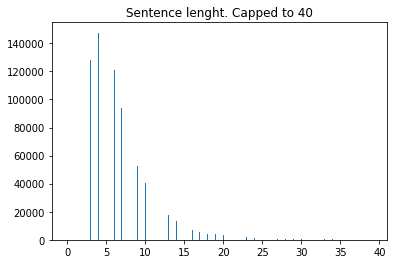

In [9]:
# %%time
#TODO: multicpu

voc = Voc(corpus_name)

hist = []  
for i,s in loadLines(corpus,LINES_USED):
    s_l = len(s)
    hist.append(s_l)
    voc.addSentence(s)
    
print(f'Número de palabras: {voc.num_words}')

arr = np.array(hist)
plt.hist(arr, bins='auto')  # arguments are passed to np.histogram
plt.title(f"Sentence lenght. Capped to {MAX_LENGTH}")
plt.show()

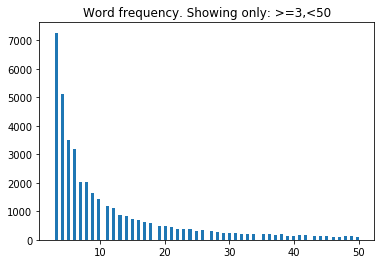

In [10]:
hist=[]
for i,n in enumerate(voc.word2count):
    c = voc.word2count[n]
    if c>=3:
        hist.append(c)
        
arr = np.array(hist)
plt.hist(arr, bins=100,range=(3,50))  # arguments are passed to np.histogram
plt.title(f"Word frequency. Showing only: >=3,<50")
plt.show()

In [11]:
from collections import Counter
c = Counter(voc.word2count)
c.most_common()

[('.', 874367),
 ('?', 185454),
 ('¿', 174026),
 ('que', 165672),
 ('no', 162344),
 ('de', 159291),
 ('a', 118184),
 ('la', 111011),
 ('el', 94404),
 ('!', 88841),
 ('y', 83291),
 ('es', 80489),
 ('¡', 78429),
 ('en', 75574),
 ('lo', 70907),
 ('un', 69839),
 ('me', 57395),
 ('por', 56328),
 ('qué', 55451),
 ('una', 44352),
 ('se', 42713),
 ('te', 38893),
 ('con', 36142),
 ('los', 35730),
 ('para', 30576),
 ('pero', 29627),
 ('si', 29290),
 ('sí', 29252),
 ('está', 29078),
 ('mi', 26485),
 ('su', 25938),
 ('las', 25881),
 ('yo', 25584),
 ('le', 25159),
 ('bien', 21932),
 ('eso', 21783),
 ('al', 21702),
 ('aquí', 20433),
 ('del', 19797),
 ('más', 19516),
 ('ha', 18556),
 ('como', 18510),
 ('ya', 16685),
 ('todo', 15775),
 ('tu', 15107),
 ('muy', 14786),
 ('he', 14044),
 ('nada', 13117),
 ('ahora', 12494),
 ('hay', 12181),
 ('usted', 12166),
 ('esta', 11946),
 ('señor', 11694),
 ('así', 11672),
 ('algo', 11648),
 ('cuando', 11464),
 ('nos', 11438),
 ('tengo', 11389),
 ('esto', 11215),
 ('

In [12]:
#Check de la puntuacion
import string 
print(string.punctuation)

punt_dict = {}
for word in c:
    for punt in string.punctuation:#",.¿?¡!\":()-{}":
        if punt in word:
            if len(word)>1 and c[word]>MIN_COUNT:
                punt_dict[word] = c[word]
c2 = Counter(punt_dict)
c2.most_common()

!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~


[('dijo:', 281),
 ('dije:', 207),
 ('dice:', 152),
 ("ma'am", 120),
 ("goa'uld", 119),
 ('10:00', 107),
 ('brogan-moore', 106),
 ('8:00', 105),
 ("teal'c", 100),
 ('esto:', 90),
 ('rau-ru', 88),
 ('3:00', 81),
 ('cosa:', 81),
 ('dicho:', 80),
 ('7:00', 67),
 ('21:25', 66),
 ('decir:', 66),
 ('dos:', 65),
 ('es:', 54),
 ('pah-wraiths', 54),
 ('decía:', 53),
 ('4:00', 53),
 ('22:10', 52),
 ('así:', 51),
 ("b'elanna", 51),
 ("o'neill", 49),
 ('$10', 47),
 ('hana-ogi', 46),
 ('tres:', 45),
 ("don't", 45),
 ("'n'", 45),
 ('9:00', 44),
 ('dirá:', 44),
 ('yo-yo', 44),
 ('digo:', 43),
 ("i'm", 43),
 ('pensé:', 42),
 ('por:', 42),
 ('bate-huevos', 42),
 ("sha're", 42),
 ('50%', 41),
 ('que--', 41),
 ('10%', 40),
 ("d'angelo", 40),
 ('anne-claire', 39),
 ('5:00', 39),
 ("it's", 39),
 ('11:00', 38),
 ('21:30', 37),
 ('$1', 37),
 ('$5', 36),
 ('slug-o-cola', 36),
 ("o'brien", 35),
 ('diga:', 35),
 ('palabras:', 35),
 ('uno:', 33),
 ('--', 32),
 ('-¿', 31),
 ('2:00', 31),
 ('pregunta:', 30),
 ('19:

In [13]:
voc.trim(MIN_COUNT)

keep_words 22253 / 86548 = 0.2571


In [14]:
def has_trimmed_or_unk(spl_snt):
    """ Filter out sentences with trimmed words or words not in the voc
    spl_snt is a list of words"""
    for word in spl_snt:
        if word not in voc.word2index:
            return True

In [15]:
trm_unk = 0
for i,s in loadLines(corpus,LINES_USED):
    if has_trimmed_or_unk(s): trm_unk +=1
        
full_pairs =  LINES_USED - trm_unk      

print(f"From {LINES_USED} pairs, {full_pairs} does not contain trimmed or unkonwn words,", 
      f"{full_pairs / LINES_USED:.4f} of total")

From 1000000 pairs, 853909 does not contain trimmed or unkonwn words, 0.8539 of total


In [16]:
#aumentando min_count de 3 a 5 el vocabulario pasa de 72510(57%) a 36642(29%), sin embargo las frases aceptadas 
#solo baja un 6%, de 97.33% a 91.27%, o lo que es más impactante, con un tercio del vocabulario total podemos 
#recrear más del 90% del dataset , TODO restestear con diferentes min count cuando este el multicpu

In [17]:
# spl_snt is a list of words
def indexesFromSentence(spl_snt, voc):
    idxs = []
    for word in spl_snt:
        try:
            idxs += [voc.word2index[word]]
        except:
            idxs += [UNK_token] #word2index["UNK"]=UNK_token
    return idxs + [EOS_token]

def gen_pairs(how_many, voc):
    first_inp = True
    n=0
    for out_idx, out_snt in loadLines(corpus,LINES_USED):
        
        if first_inp: #first cycle, set first input
            inp_idx, inp_snt = out_idx, out_snt
            first_inp = False
            continue

        if inp_idx+1 == out_idx: #frases contiguas (loadLines filter long sentences)
            ok_inp = True if WITH_UNK else not has_trimmed_or_unk(inp_snt) # if WITH_UNK==True, every inp is accepted
            ok_out = not has_trimmed_or_unk(out_snt)
            
            if ok_inp and ok_out: #every word is in Voc
                n+=1
                yield [indexesFromSentence(inp_snt, voc),indexesFromSentence(out_snt, voc)]
        
        if n==how_many:break
        inp_idx, inp_snt = out_idx, out_snt #prepare next cycle
        
for pair in gen_pairs(10,voc): print(pair)

[[8, 9, 3, 10, 11, 12, 13, 14, 3, 14, 15, 16, 17, 5, 18, 7, 2], [19, 20, 21, 22, 23, 11, 24, 16, 25, 26, 27, 28, 29, 30, 26, 27, 5, 31, 7, 2]]
[[32, 33, 3, 34, 35, 36, 3, 37, 38, 2], [25, 7, 2]]
[[25, 39, 40, 3, 41, 42, 43, 44, 3, 7, 2], [45, 46, 47, 7, 2]]
[[45, 46, 47, 7, 2], [32, 48, 49, 50, 51, 38, 2]]
[[32, 48, 49, 50, 51, 38, 2], [32, 52, 14, 53, 50, 51, 54, 38, 2]]
[[32, 52, 14, 53, 50, 51, 54, 38, 2], [55, 14, 56, 25, 8, 57, 7, 2]]
[[55, 14, 56, 25, 8, 57, 7, 2], [32, 28, 58, 59, 60, 5, 61, 62, 63, 50, 64, 38, 2]]
[[32, 28, 58, 59, 60, 5, 61, 62, 63, 50, 64, 38, 2], [65, 66, 11, 67, 68, 7, 2]]
[[3, 69, 70, 71, 72, 73, 7, 2], [49, 50, 74, 75, 7, 76, 77, 78, 2]]
[[49, 50, 74, 75, 7, 76, 77, 78, 2], [79, 80, 81, 50, 82, 83, 84, 7, 2]]


In [18]:
#check finales paris
for pair in gen_pairs(10,voc): 
    for i in pair:
        snt = []
        for idx in i:
            snt += [voc.index2word[idx]]
        print(*snt)
    print("---")

somos los UNK amigos de la secundaria que UNK que su amistad duraría para siempre . EOS
aunque las circunstancias del inicio de nuestra amistad no fueron especiales en cierto modo fueron especiales para nosotros . EOS
---
¿ le UNK el pecho a UNK min ? EOS
no . EOS
---
no se lo UNK me quede allí parado UNK . EOS
debes estar demente . EOS
---
debes estar demente . EOS
¿ eso es una pregunta ? EOS
---
¿ eso es una pregunta ? EOS
¿ crees que fue una pregunta idiota ? EOS
---
¿ crees que fue una pregunta idiota ? EOS
ey que ya no somos niños . EOS
---
ey que ya no somos niños . EOS
¿ en qué estaban pensando para pelear así por una chica ? EOS
---
¿ en qué estaban pensando para pelear así por una chica ? EOS
deben resolverlo de forma razonable . EOS
---
UNK con piedra papel o tijeras . EOS
es una buena idea . ¡ hagámoslo ! EOS
---
es una buena idea . ¡ hagámoslo ! EOS
ok solo haremos una ronda como hombres . EOS
---


In [19]:
pairs = list(gen_pairs(LINES_USED,voc))

In [20]:
"""
se obtienen menos pares que lineas usadas, con lineas usadas se crea el diccionario, con ese diccionario elegimos 
las palabras con las que quedarnos, se descartan las lineas con palabras borradas y de ahi solo cogemos los pares
de lineas contiguos
"""
len(pairs)

853426

In [21]:
#Guardar pairs y voc
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
    
with open(save_dir + '/pairs.pkl', 'wb') as file:
    pickle.dump(pairs, file)

with open(save_dir + '/voc.pkl', 'wb') as file:
    voc.__module__ = "Voc"
    pickle.dump(voc, file)

In [25]:
# # Example for validation of the code
# small_batch_size = 6
# pairs_list = [random.choice(pairs) for _ in range(small_batch_size)]
# batches = batch2TrainData(pairs_list)
# input_variable, lengths, target_variable, mask, max_target_len = batches

# print("input_variable:\n", input_variable)
# print("lengths:", lengths)
# print("target_variable:\n", target_variable)
# print("mask:\n", mask)
# print("max_target_len:", max_target_len)